# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

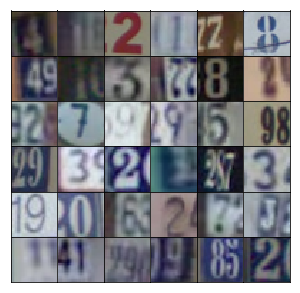

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5108... Generator Loss: 0.5972
Epoch 1/25... Discriminator Loss: 0.7325... Generator Loss: 0.9695
Epoch 1/25... Discriminator Loss: 0.1735... Generator Loss: 2.2835
Epoch 1/25... Discriminator Loss: 0.1705... Generator Loss: 2.5516
Epoch 1/25... Discriminator Loss: 0.1194... Generator Loss: 2.8446
Epoch 1/25... Discriminator Loss: 0.0709... Generator Loss: 3.5967
Epoch 1/25... Discriminator Loss: 0.1082... Generator Loss: 3.0416
Epoch 1/25... Discriminator Loss: 0.2104... Generator Loss: 2.5515
Epoch 1/25... Discriminator Loss: 0.1697... Generator Loss: 2.4273
Epoch 1/25... Discriminator Loss: 0.2095... Generator Loss: 2.5264


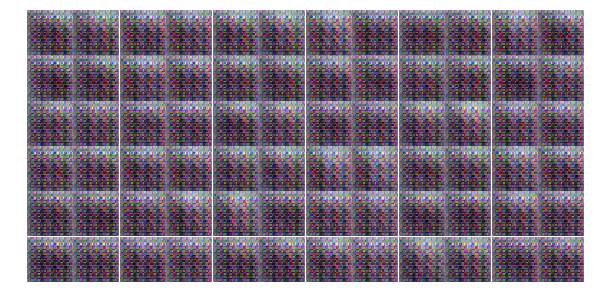

Epoch 1/25... Discriminator Loss: 0.4278... Generator Loss: 1.6856
Epoch 1/25... Discriminator Loss: 0.4201... Generator Loss: 2.1030
Epoch 1/25... Discriminator Loss: 1.0070... Generator Loss: 0.6400
Epoch 1/25... Discriminator Loss: 0.4677... Generator Loss: 1.9668
Epoch 1/25... Discriminator Loss: 0.4684... Generator Loss: 1.6362
Epoch 1/25... Discriminator Loss: 0.3677... Generator Loss: 2.3739
Epoch 1/25... Discriminator Loss: 0.2922... Generator Loss: 2.8322
Epoch 1/25... Discriminator Loss: 0.2638... Generator Loss: 2.5450
Epoch 1/25... Discriminator Loss: 0.6583... Generator Loss: 1.2252
Epoch 1/25... Discriminator Loss: 0.3802... Generator Loss: 3.9532


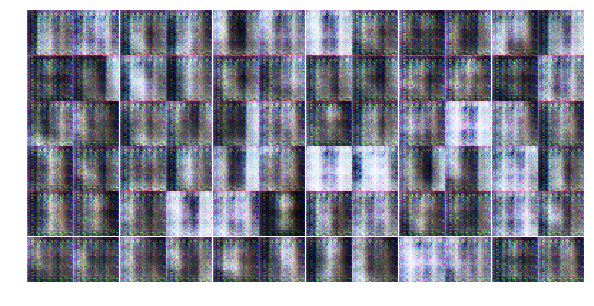

Epoch 1/25... Discriminator Loss: 1.8601... Generator Loss: 0.8279
Epoch 1/25... Discriminator Loss: 0.2645... Generator Loss: 2.2726
Epoch 1/25... Discriminator Loss: 0.2701... Generator Loss: 2.6717
Epoch 1/25... Discriminator Loss: 1.1886... Generator Loss: 0.6558
Epoch 1/25... Discriminator Loss: 0.7722... Generator Loss: 2.2258
Epoch 1/25... Discriminator Loss: 0.4937... Generator Loss: 2.2238
Epoch 1/25... Discriminator Loss: 0.3435... Generator Loss: 1.7942
Epoch 1/25... Discriminator Loss: 0.1627... Generator Loss: 2.5783
Epoch 1/25... Discriminator Loss: 0.7882... Generator Loss: 1.3674
Epoch 1/25... Discriminator Loss: 0.3837... Generator Loss: 2.1992


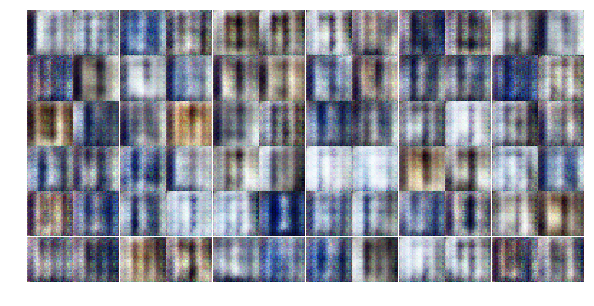

Epoch 1/25... Discriminator Loss: 0.3684... Generator Loss: 1.8917
Epoch 1/25... Discriminator Loss: 1.6123... Generator Loss: 0.3481
Epoch 1/25... Discriminator Loss: 0.5674... Generator Loss: 1.6930
Epoch 1/25... Discriminator Loss: 0.4109... Generator Loss: 1.6214
Epoch 1/25... Discriminator Loss: 0.5998... Generator Loss: 1.2975
Epoch 1/25... Discriminator Loss: 0.9399... Generator Loss: 1.3125
Epoch 1/25... Discriminator Loss: 0.3170... Generator Loss: 2.6154
Epoch 1/25... Discriminator Loss: 0.2613... Generator Loss: 2.6310
Epoch 1/25... Discriminator Loss: 0.3206... Generator Loss: 2.2969
Epoch 1/25... Discriminator Loss: 0.2396... Generator Loss: 3.6382


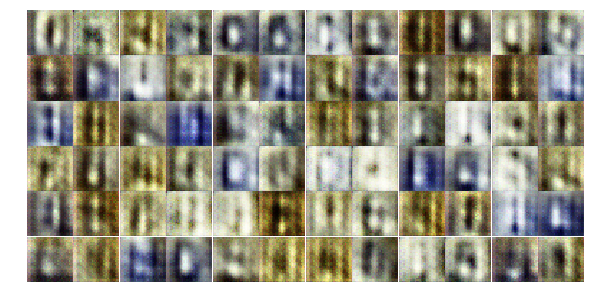

Epoch 1/25... Discriminator Loss: 0.2355... Generator Loss: 3.4892
Epoch 1/25... Discriminator Loss: 0.2661... Generator Loss: 2.2276
Epoch 1/25... Discriminator Loss: 1.0313... Generator Loss: 0.9946
Epoch 1/25... Discriminator Loss: 1.2269... Generator Loss: 1.8372
Epoch 1/25... Discriminator Loss: 0.5240... Generator Loss: 2.2066
Epoch 1/25... Discriminator Loss: 0.7260... Generator Loss: 1.3735
Epoch 1/25... Discriminator Loss: 0.4288... Generator Loss: 3.2169
Epoch 1/25... Discriminator Loss: 0.3695... Generator Loss: 2.2679
Epoch 1/25... Discriminator Loss: 0.3471... Generator Loss: 1.8957
Epoch 1/25... Discriminator Loss: 1.5270... Generator Loss: 0.3334


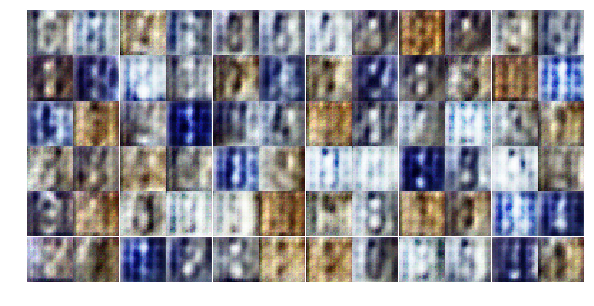

Epoch 1/25... Discriminator Loss: 0.1880... Generator Loss: 2.5682
Epoch 1/25... Discriminator Loss: 0.3999... Generator Loss: 1.9298
Epoch 1/25... Discriminator Loss: 0.8149... Generator Loss: 1.1241
Epoch 1/25... Discriminator Loss: 0.8306... Generator Loss: 0.8402
Epoch 1/25... Discriminator Loss: 0.4709... Generator Loss: 1.6338
Epoch 1/25... Discriminator Loss: 0.4773... Generator Loss: 1.3176
Epoch 1/25... Discriminator Loss: 0.2037... Generator Loss: 4.1312
Epoch 2/25... Discriminator Loss: 0.2796... Generator Loss: 2.0573
Epoch 2/25... Discriminator Loss: 0.3222... Generator Loss: 1.9894
Epoch 2/25... Discriminator Loss: 0.2449... Generator Loss: 2.2442


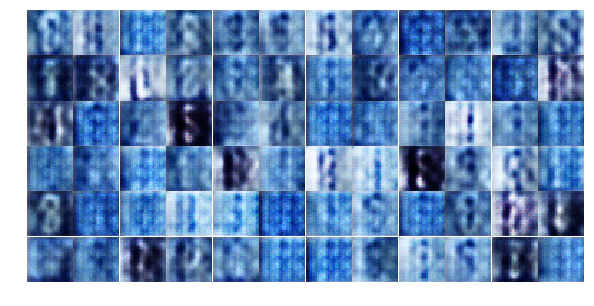

Epoch 2/25... Discriminator Loss: 0.5693... Generator Loss: 1.2072
Epoch 2/25... Discriminator Loss: 0.3082... Generator Loss: 1.7979
Epoch 2/25... Discriminator Loss: 0.4917... Generator Loss: 1.5791
Epoch 2/25... Discriminator Loss: 0.3998... Generator Loss: 3.5043
Epoch 2/25... Discriminator Loss: 0.3951... Generator Loss: 1.6118
Epoch 2/25... Discriminator Loss: 0.5924... Generator Loss: 4.4322
Epoch 2/25... Discriminator Loss: 0.3753... Generator Loss: 2.2986
Epoch 2/25... Discriminator Loss: 0.4070... Generator Loss: 1.5947
Epoch 2/25... Discriminator Loss: 0.3337... Generator Loss: 1.9954
Epoch 2/25... Discriminator Loss: 0.5370... Generator Loss: 3.8686


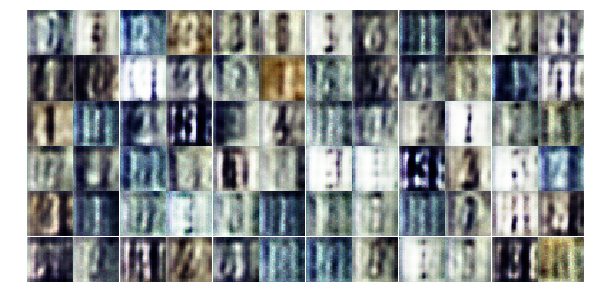

Epoch 2/25... Discriminator Loss: 1.5009... Generator Loss: 5.2685
Epoch 2/25... Discriminator Loss: 0.9544... Generator Loss: 1.3658
Epoch 2/25... Discriminator Loss: 0.5459... Generator Loss: 2.4606
Epoch 2/25... Discriminator Loss: 0.4148... Generator Loss: 1.9680
Epoch 2/25... Discriminator Loss: 0.4187... Generator Loss: 2.4796
Epoch 2/25... Discriminator Loss: 0.8115... Generator Loss: 2.5737
Epoch 2/25... Discriminator Loss: 0.9655... Generator Loss: 0.7792
Epoch 2/25... Discriminator Loss: 0.6595... Generator Loss: 1.2457
Epoch 2/25... Discriminator Loss: 0.7018... Generator Loss: 1.2316
Epoch 2/25... Discriminator Loss: 0.6735... Generator Loss: 1.5971


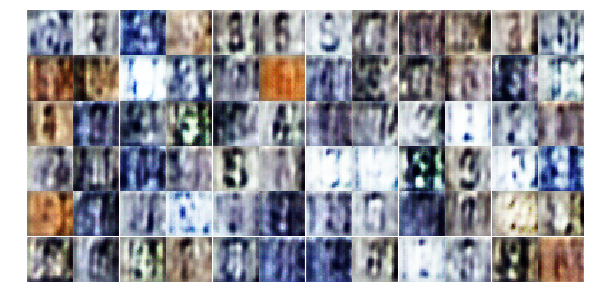

Epoch 2/25... Discriminator Loss: 1.0359... Generator Loss: 0.8389
Epoch 2/25... Discriminator Loss: 0.6194... Generator Loss: 1.3640
Epoch 2/25... Discriminator Loss: 0.6461... Generator Loss: 1.5138
Epoch 2/25... Discriminator Loss: 0.6189... Generator Loss: 1.1684
Epoch 2/25... Discriminator Loss: 1.6110... Generator Loss: 3.9731
Epoch 2/25... Discriminator Loss: 0.8665... Generator Loss: 1.1993
Epoch 2/25... Discriminator Loss: 1.6516... Generator Loss: 0.3690
Epoch 2/25... Discriminator Loss: 1.2846... Generator Loss: 0.6152
Epoch 2/25... Discriminator Loss: 1.2002... Generator Loss: 0.7938
Epoch 2/25... Discriminator Loss: 0.8319... Generator Loss: 1.3444


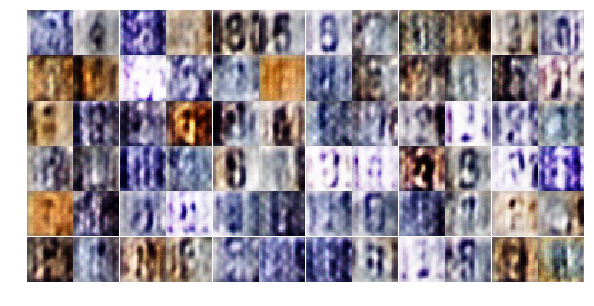

Epoch 2/25... Discriminator Loss: 0.8984... Generator Loss: 1.0612
Epoch 2/25... Discriminator Loss: 0.9337... Generator Loss: 1.8124
Epoch 2/25... Discriminator Loss: 1.0668... Generator Loss: 0.7257
Epoch 2/25... Discriminator Loss: 1.0476... Generator Loss: 0.8044
Epoch 2/25... Discriminator Loss: 0.8694... Generator Loss: 1.5131
Epoch 2/25... Discriminator Loss: 0.9303... Generator Loss: 1.3450
Epoch 2/25... Discriminator Loss: 0.7780... Generator Loss: 1.3521
Epoch 2/25... Discriminator Loss: 0.7710... Generator Loss: 2.1317
Epoch 2/25... Discriminator Loss: 1.2992... Generator Loss: 1.3881
Epoch 2/25... Discriminator Loss: 0.8037... Generator Loss: 1.4285


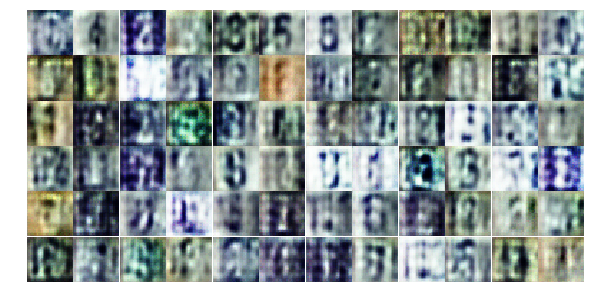

Epoch 2/25... Discriminator Loss: 0.7442... Generator Loss: 1.5660
Epoch 2/25... Discriminator Loss: 0.7629... Generator Loss: 1.3891
Epoch 2/25... Discriminator Loss: 0.3596... Generator Loss: 2.1754
Epoch 2/25... Discriminator Loss: 2.2226... Generator Loss: 0.2165
Epoch 2/25... Discriminator Loss: 0.9880... Generator Loss: 1.1421
Epoch 2/25... Discriminator Loss: 1.2069... Generator Loss: 0.6879
Epoch 2/25... Discriminator Loss: 0.9168... Generator Loss: 1.2337
Epoch 2/25... Discriminator Loss: 0.9864... Generator Loss: 1.1376
Epoch 2/25... Discriminator Loss: 0.6476... Generator Loss: 1.5022
Epoch 2/25... Discriminator Loss: 0.7285... Generator Loss: 2.1373


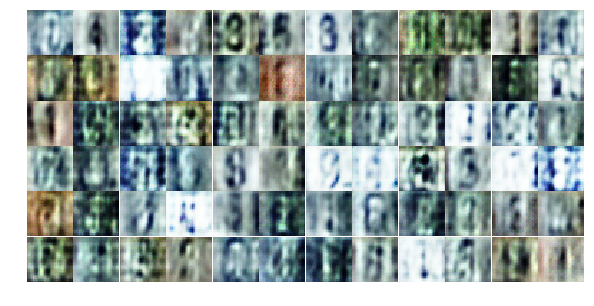

Epoch 2/25... Discriminator Loss: 1.2499... Generator Loss: 0.6350
Epoch 2/25... Discriminator Loss: 0.9211... Generator Loss: 1.1191
Epoch 2/25... Discriminator Loss: 0.8072... Generator Loss: 1.1638
Epoch 2/25... Discriminator Loss: 0.8974... Generator Loss: 0.9546
Epoch 3/25... Discriminator Loss: 0.7630... Generator Loss: 1.7273
Epoch 3/25... Discriminator Loss: 0.7541... Generator Loss: 1.6596
Epoch 3/25... Discriminator Loss: 0.6517... Generator Loss: 1.5554
Epoch 3/25... Discriminator Loss: 1.5839... Generator Loss: 0.3189
Epoch 3/25... Discriminator Loss: 0.9846... Generator Loss: 0.8378
Epoch 3/25... Discriminator Loss: 0.7474... Generator Loss: 1.3313


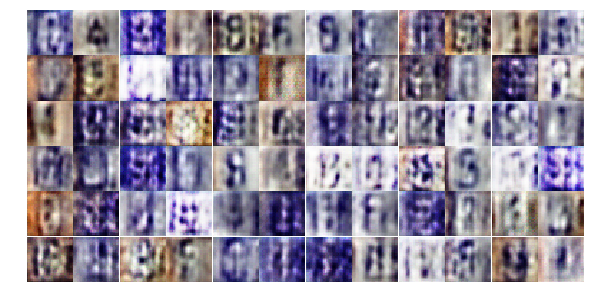

Epoch 3/25... Discriminator Loss: 0.6349... Generator Loss: 1.4034
Epoch 3/25... Discriminator Loss: 0.7111... Generator Loss: 2.4170
Epoch 3/25... Discriminator Loss: 0.7693... Generator Loss: 1.4174
Epoch 3/25... Discriminator Loss: 0.9912... Generator Loss: 0.8090
Epoch 3/25... Discriminator Loss: 0.8356... Generator Loss: 0.9164
Epoch 3/25... Discriminator Loss: 0.8402... Generator Loss: 1.0772
Epoch 3/25... Discriminator Loss: 0.7501... Generator Loss: 2.0997
Epoch 3/25... Discriminator Loss: 1.0004... Generator Loss: 0.6614
Epoch 3/25... Discriminator Loss: 0.8665... Generator Loss: 1.0085
Epoch 3/25... Discriminator Loss: 0.8427... Generator Loss: 1.0379


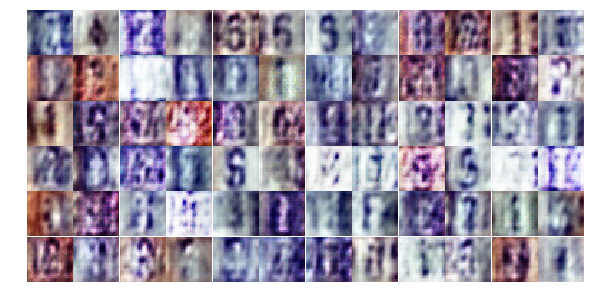

Epoch 3/25... Discriminator Loss: 0.9093... Generator Loss: 1.0457
Epoch 3/25... Discriminator Loss: 0.9567... Generator Loss: 1.1222
Epoch 3/25... Discriminator Loss: 0.7931... Generator Loss: 1.5148
Epoch 3/25... Discriminator Loss: 0.7538... Generator Loss: 1.3317
Epoch 3/25... Discriminator Loss: 0.5599... Generator Loss: 1.5317
Epoch 3/25... Discriminator Loss: 0.6511... Generator Loss: 1.8733
Epoch 3/25... Discriminator Loss: 0.8616... Generator Loss: 0.7718
Epoch 3/25... Discriminator Loss: 0.8299... Generator Loss: 1.4288
Epoch 3/25... Discriminator Loss: 0.5572... Generator Loss: 1.6359
Epoch 3/25... Discriminator Loss: 0.6590... Generator Loss: 1.2771


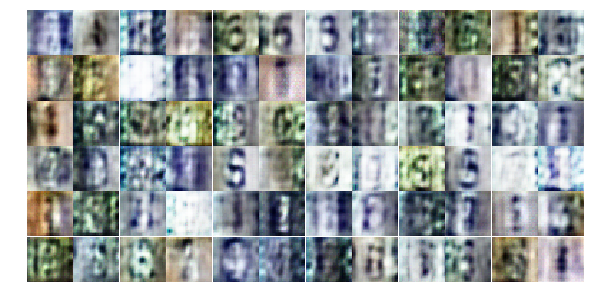

Epoch 3/25... Discriminator Loss: 0.2415... Generator Loss: 2.1658
Epoch 3/25... Discriminator Loss: 0.5567... Generator Loss: 1.3080
Epoch 3/25... Discriminator Loss: 0.6176... Generator Loss: 1.4805
Epoch 3/25... Discriminator Loss: 0.6100... Generator Loss: 1.8140
Epoch 3/25... Discriminator Loss: 0.7445... Generator Loss: 1.2301
Epoch 3/25... Discriminator Loss: 1.0688... Generator Loss: 0.7152
Epoch 3/25... Discriminator Loss: 0.7286... Generator Loss: 3.7095
Epoch 3/25... Discriminator Loss: 1.3699... Generator Loss: 0.7624
Epoch 3/25... Discriminator Loss: 0.7656... Generator Loss: 1.1927
Epoch 3/25... Discriminator Loss: 0.8273... Generator Loss: 0.9347


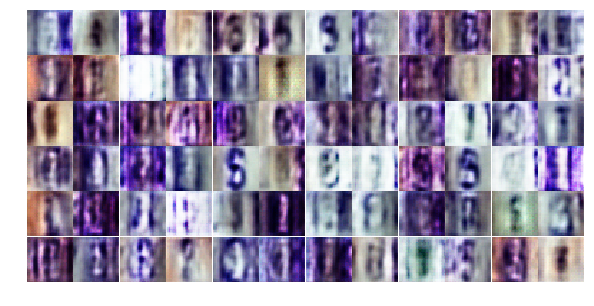

Epoch 3/25... Discriminator Loss: 1.0051... Generator Loss: 2.1207
Epoch 3/25... Discriminator Loss: 0.7919... Generator Loss: 1.4947
Epoch 3/25... Discriminator Loss: 0.9741... Generator Loss: 0.8063
Epoch 3/25... Discriminator Loss: 0.9462... Generator Loss: 0.7329
Epoch 3/25... Discriminator Loss: 0.6307... Generator Loss: 1.8411
Epoch 3/25... Discriminator Loss: 0.8378... Generator Loss: 1.7001
Epoch 3/25... Discriminator Loss: 0.9746... Generator Loss: 0.8495
Epoch 3/25... Discriminator Loss: 0.4468... Generator Loss: 1.7437
Epoch 3/25... Discriminator Loss: 0.4628... Generator Loss: 2.3935
Epoch 3/25... Discriminator Loss: 0.8367... Generator Loss: 0.8651


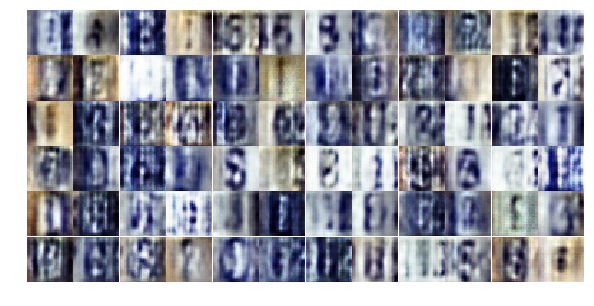

Epoch 3/25... Discriminator Loss: 1.4241... Generator Loss: 0.3887
Epoch 3/25... Discriminator Loss: 0.6807... Generator Loss: 1.2861
Epoch 3/25... Discriminator Loss: 0.5215... Generator Loss: 1.4808
Epoch 3/25... Discriminator Loss: 0.3822... Generator Loss: 1.8705
Epoch 3/25... Discriminator Loss: 0.5607... Generator Loss: 1.5266
Epoch 3/25... Discriminator Loss: 0.6710... Generator Loss: 1.4568
Epoch 3/25... Discriminator Loss: 0.5517... Generator Loss: 2.5535
Epoch 3/25... Discriminator Loss: 0.6470... Generator Loss: 1.7655
Epoch 3/25... Discriminator Loss: 0.4396... Generator Loss: 1.8865
Epoch 3/25... Discriminator Loss: 0.8592... Generator Loss: 1.4079


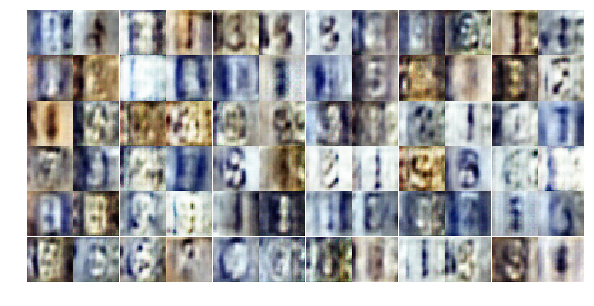

Epoch 3/25... Discriminator Loss: 0.9913... Generator Loss: 0.7412
Epoch 4/25... Discriminator Loss: 0.9587... Generator Loss: 0.7680
Epoch 4/25... Discriminator Loss: 0.9576... Generator Loss: 1.0650
Epoch 4/25... Discriminator Loss: 0.5584... Generator Loss: 1.6695
Epoch 4/25... Discriminator Loss: 0.4817... Generator Loss: 1.8171
Epoch 4/25... Discriminator Loss: 0.5419... Generator Loss: 1.1874
Epoch 4/25... Discriminator Loss: 0.7366... Generator Loss: 1.8476
Epoch 4/25... Discriminator Loss: 0.8879... Generator Loss: 0.9393
Epoch 4/25... Discriminator Loss: 0.5539... Generator Loss: 1.5293
Epoch 4/25... Discriminator Loss: 0.6699... Generator Loss: 1.1192


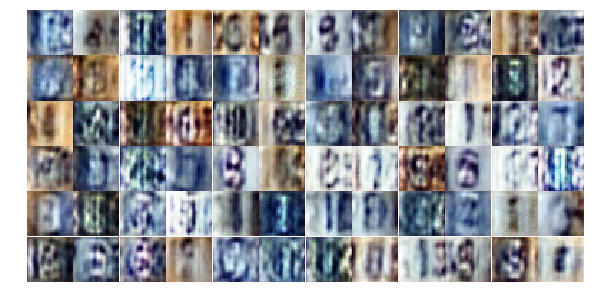

Epoch 4/25... Discriminator Loss: 0.7754... Generator Loss: 0.9777
Epoch 4/25... Discriminator Loss: 1.0023... Generator Loss: 0.6411
Epoch 4/25... Discriminator Loss: 0.7298... Generator Loss: 1.1757
Epoch 4/25... Discriminator Loss: 0.6282... Generator Loss: 1.4634
Epoch 4/25... Discriminator Loss: 0.8315... Generator Loss: 1.9636
Epoch 4/25... Discriminator Loss: 1.5102... Generator Loss: 0.3676
Epoch 4/25... Discriminator Loss: 1.1417... Generator Loss: 0.5545
Epoch 4/25... Discriminator Loss: 0.5650... Generator Loss: 1.3776
Epoch 4/25... Discriminator Loss: 0.6375... Generator Loss: 1.4305
Epoch 4/25... Discriminator Loss: 0.6826... Generator Loss: 1.7830


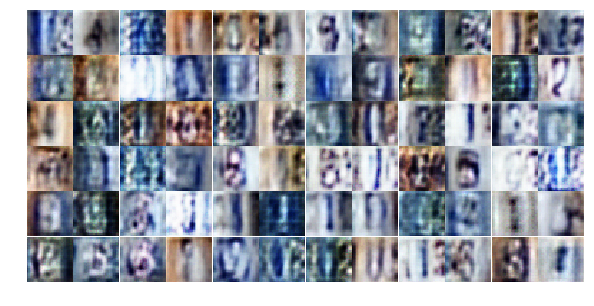

Epoch 4/25... Discriminator Loss: 0.7183... Generator Loss: 1.5566
Epoch 4/25... Discriminator Loss: 1.3410... Generator Loss: 3.8086
Epoch 4/25... Discriminator Loss: 0.9722... Generator Loss: 0.6897
Epoch 4/25... Discriminator Loss: 0.6682... Generator Loss: 1.0959
Epoch 4/25... Discriminator Loss: 0.4564... Generator Loss: 1.8369
Epoch 4/25... Discriminator Loss: 0.4178... Generator Loss: 1.6622
Epoch 4/25... Discriminator Loss: 0.6152... Generator Loss: 1.0981
Epoch 4/25... Discriminator Loss: 0.5413... Generator Loss: 1.3162
Epoch 4/25... Discriminator Loss: 0.3509... Generator Loss: 2.1090
Epoch 4/25... Discriminator Loss: 0.6014... Generator Loss: 1.1067


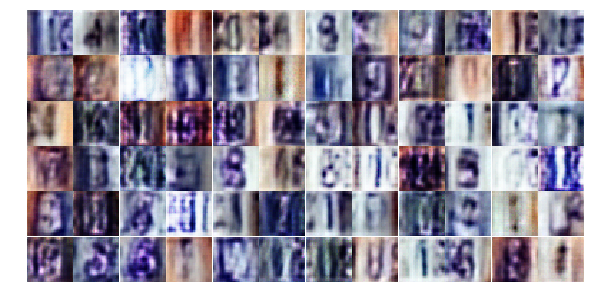

Epoch 4/25... Discriminator Loss: 0.4641... Generator Loss: 1.8003
Epoch 4/25... Discriminator Loss: 0.8544... Generator Loss: 2.5570
Epoch 4/25... Discriminator Loss: 0.7572... Generator Loss: 0.8888
Epoch 4/25... Discriminator Loss: 0.3830... Generator Loss: 2.2681
Epoch 4/25... Discriminator Loss: 0.6552... Generator Loss: 1.0888
Epoch 4/25... Discriminator Loss: 0.4562... Generator Loss: 1.4267
Epoch 4/25... Discriminator Loss: 0.6356... Generator Loss: 1.9636
Epoch 4/25... Discriminator Loss: 0.6508... Generator Loss: 1.3703
Epoch 4/25... Discriminator Loss: 0.3310... Generator Loss: 1.9246
Epoch 4/25... Discriminator Loss: 0.7325... Generator Loss: 0.9916


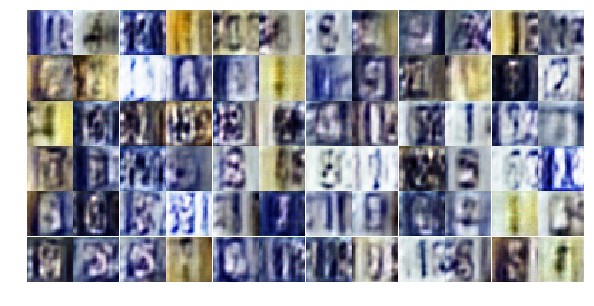

Epoch 4/25... Discriminator Loss: 0.5661... Generator Loss: 1.2491
Epoch 4/25... Discriminator Loss: 0.3835... Generator Loss: 1.7087
Epoch 4/25... Discriminator Loss: 0.3229... Generator Loss: 2.0694
Epoch 4/25... Discriminator Loss: 0.2515... Generator Loss: 2.1401
Epoch 4/25... Discriminator Loss: 0.3698... Generator Loss: 1.7300
Epoch 4/25... Discriminator Loss: 0.7091... Generator Loss: 2.1498
Epoch 4/25... Discriminator Loss: 0.6024... Generator Loss: 1.2774
Epoch 4/25... Discriminator Loss: 0.9176... Generator Loss: 0.8930
Epoch 4/25... Discriminator Loss: 0.8900... Generator Loss: 0.7438
Epoch 4/25... Discriminator Loss: 0.4727... Generator Loss: 1.8292


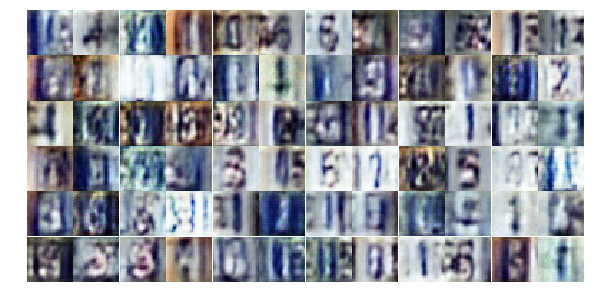

Epoch 4/25... Discriminator Loss: 0.4611... Generator Loss: 1.4149
Epoch 4/25... Discriminator Loss: 0.2438... Generator Loss: 2.0266
Epoch 4/25... Discriminator Loss: 1.1460... Generator Loss: 2.7693
Epoch 4/25... Discriminator Loss: 0.4818... Generator Loss: 1.8678
Epoch 4/25... Discriminator Loss: 0.4289... Generator Loss: 1.7828
Epoch 4/25... Discriminator Loss: 0.6152... Generator Loss: 1.2735
Epoch 4/25... Discriminator Loss: 0.7675... Generator Loss: 0.8607
Epoch 4/25... Discriminator Loss: 0.6079... Generator Loss: 1.2046
Epoch 4/25... Discriminator Loss: 0.4552... Generator Loss: 1.4793
Epoch 5/25... Discriminator Loss: 0.4931... Generator Loss: 1.2985


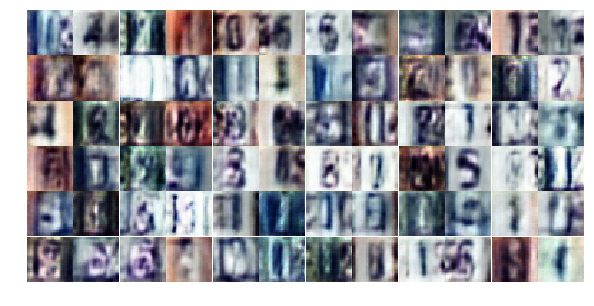

Epoch 5/25... Discriminator Loss: 0.3619... Generator Loss: 1.8847
Epoch 5/25... Discriminator Loss: 0.5369... Generator Loss: 1.2676
Epoch 5/25... Discriminator Loss: 0.2333... Generator Loss: 2.6022
Epoch 5/25... Discriminator Loss: 0.7100... Generator Loss: 3.4338
Epoch 5/25... Discriminator Loss: 0.6516... Generator Loss: 2.8576
Epoch 5/25... Discriminator Loss: 0.5793... Generator Loss: 1.1578
Epoch 5/25... Discriminator Loss: 0.8024... Generator Loss: 0.8180
Epoch 5/25... Discriminator Loss: 0.6777... Generator Loss: 0.9720
Epoch 5/25... Discriminator Loss: 0.7502... Generator Loss: 0.9010
Epoch 5/25... Discriminator Loss: 1.0593... Generator Loss: 0.5624


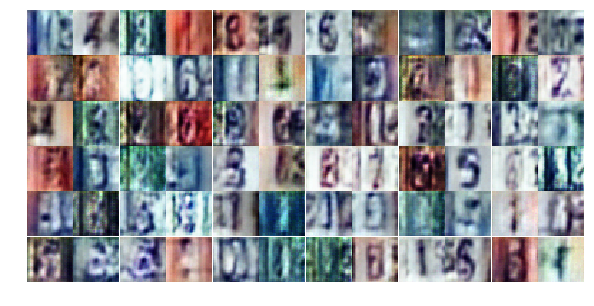

Epoch 5/25... Discriminator Loss: 0.6383... Generator Loss: 0.9676
Epoch 5/25... Discriminator Loss: 0.4238... Generator Loss: 1.4783
Epoch 5/25... Discriminator Loss: 0.5165... Generator Loss: 2.2817
Epoch 5/25... Discriminator Loss: 1.1053... Generator Loss: 0.9035
Epoch 5/25... Discriminator Loss: 0.6430... Generator Loss: 1.8922
Epoch 5/25... Discriminator Loss: 0.5796... Generator Loss: 1.1621
Epoch 5/25... Discriminator Loss: 0.5382... Generator Loss: 1.3355
Epoch 5/25... Discriminator Loss: 0.4013... Generator Loss: 1.7442
Epoch 5/25... Discriminator Loss: 0.4867... Generator Loss: 1.8184
Epoch 5/25... Discriminator Loss: 0.3782... Generator Loss: 1.9605


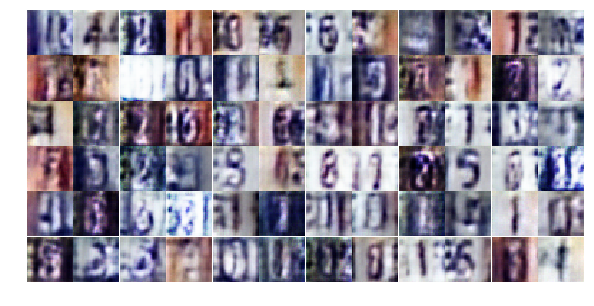

Epoch 5/25... Discriminator Loss: 0.4277... Generator Loss: 1.5330
Epoch 5/25... Discriminator Loss: 0.5976... Generator Loss: 1.9507
Epoch 5/25... Discriminator Loss: 0.6902... Generator Loss: 0.9689
Epoch 5/25... Discriminator Loss: 0.3966... Generator Loss: 1.4927
Epoch 5/25... Discriminator Loss: 1.2833... Generator Loss: 0.4297
Epoch 5/25... Discriminator Loss: 1.4735... Generator Loss: 0.3829
Epoch 5/25... Discriminator Loss: 0.6245... Generator Loss: 0.9835
Epoch 5/25... Discriminator Loss: 0.4131... Generator Loss: 1.8714
Epoch 5/25... Discriminator Loss: 1.0437... Generator Loss: 0.7246
Epoch 5/25... Discriminator Loss: 0.3752... Generator Loss: 2.0745


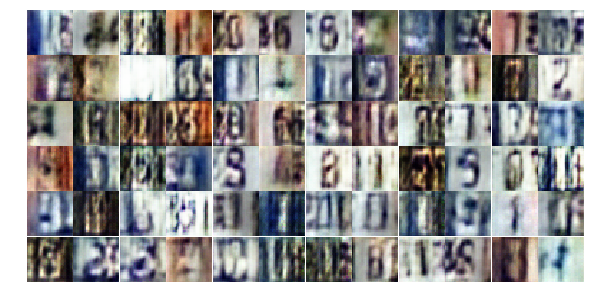

Epoch 5/25... Discriminator Loss: 0.6202... Generator Loss: 1.0946
Epoch 5/25... Discriminator Loss: 0.3588... Generator Loss: 1.6942
Epoch 5/25... Discriminator Loss: 0.3605... Generator Loss: 2.9788
Epoch 5/25... Discriminator Loss: 0.8546... Generator Loss: 0.7437
Epoch 5/25... Discriminator Loss: 0.5760... Generator Loss: 2.4874
Epoch 5/25... Discriminator Loss: 0.3269... Generator Loss: 2.1704
Epoch 5/25... Discriminator Loss: 0.7021... Generator Loss: 0.9148
Epoch 5/25... Discriminator Loss: 0.9101... Generator Loss: 0.7232
Epoch 5/25... Discriminator Loss: 0.7986... Generator Loss: 0.8771
Epoch 5/25... Discriminator Loss: 0.3937... Generator Loss: 1.7253


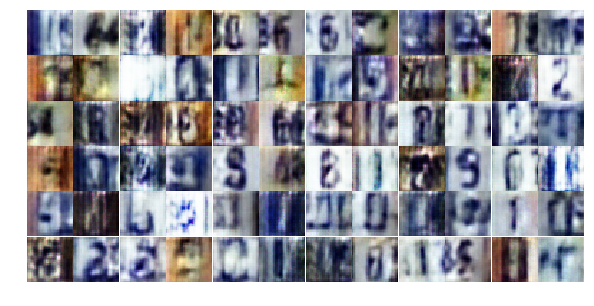

Epoch 5/25... Discriminator Loss: 0.5132... Generator Loss: 1.3825
Epoch 5/25... Discriminator Loss: 0.3509... Generator Loss: 1.8079
Epoch 5/25... Discriminator Loss: 1.6471... Generator Loss: 0.3368
Epoch 5/25... Discriminator Loss: 0.6920... Generator Loss: 1.1745
Epoch 5/25... Discriminator Loss: 1.6511... Generator Loss: 0.3553
Epoch 5/25... Discriminator Loss: 0.8837... Generator Loss: 1.8896
Epoch 5/25... Discriminator Loss: 0.8110... Generator Loss: 0.8551
Epoch 5/25... Discriminator Loss: 0.5626... Generator Loss: 1.3199
Epoch 5/25... Discriminator Loss: 0.6848... Generator Loss: 1.1987
Epoch 5/25... Discriminator Loss: 0.7795... Generator Loss: 2.3533


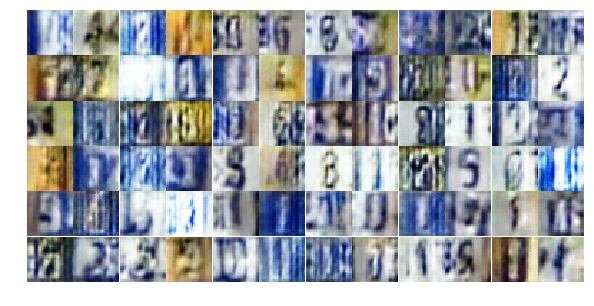

Epoch 5/25... Discriminator Loss: 1.3311... Generator Loss: 0.4361
Epoch 5/25... Discriminator Loss: 0.5474... Generator Loss: 1.2502
Epoch 5/25... Discriminator Loss: 0.6792... Generator Loss: 0.9562
Epoch 5/25... Discriminator Loss: 1.0789... Generator Loss: 0.5680
Epoch 5/25... Discriminator Loss: 0.4129... Generator Loss: 1.7055
Epoch 5/25... Discriminator Loss: 0.7151... Generator Loss: 2.3730
Epoch 6/25... Discriminator Loss: 0.6965... Generator Loss: 0.9340
Epoch 6/25... Discriminator Loss: 0.4072... Generator Loss: 1.5674
Epoch 6/25... Discriminator Loss: 0.4543... Generator Loss: 1.5636
Epoch 6/25... Discriminator Loss: 1.9379... Generator Loss: 0.2113


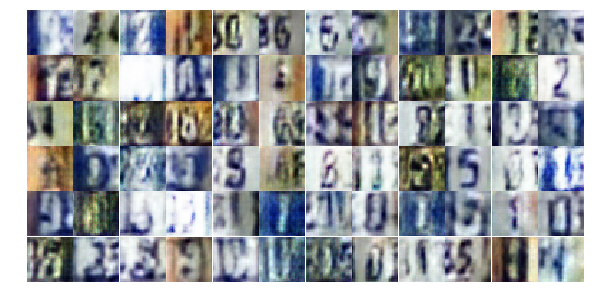

Epoch 6/25... Discriminator Loss: 0.5880... Generator Loss: 2.2258
Epoch 6/25... Discriminator Loss: 0.5235... Generator Loss: 2.4324
Epoch 6/25... Discriminator Loss: 0.5848... Generator Loss: 1.1164
Epoch 6/25... Discriminator Loss: 0.6400... Generator Loss: 1.5519
Epoch 6/25... Discriminator Loss: 0.6744... Generator Loss: 1.0804
Epoch 6/25... Discriminator Loss: 0.4165... Generator Loss: 1.4559
Epoch 6/25... Discriminator Loss: 0.4911... Generator Loss: 1.4302
Epoch 6/25... Discriminator Loss: 0.9356... Generator Loss: 0.6876
Epoch 6/25... Discriminator Loss: 0.4513... Generator Loss: 1.4283
Epoch 6/25... Discriminator Loss: 0.4666... Generator Loss: 1.5377


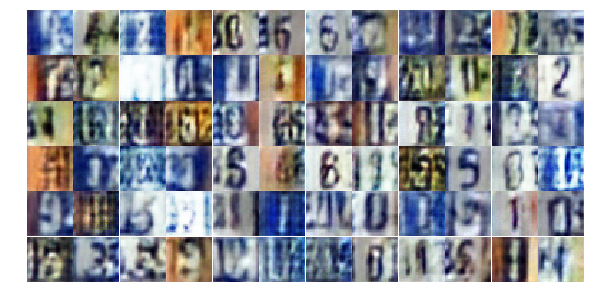

Epoch 6/25... Discriminator Loss: 0.4344... Generator Loss: 1.5423
Epoch 6/25... Discriminator Loss: 1.4426... Generator Loss: 2.2154
Epoch 6/25... Discriminator Loss: 0.5974... Generator Loss: 1.4522
Epoch 6/25... Discriminator Loss: 0.6950... Generator Loss: 0.9856
Epoch 6/25... Discriminator Loss: 0.4389... Generator Loss: 3.0528
Epoch 6/25... Discriminator Loss: 0.7498... Generator Loss: 2.7787
Epoch 6/25... Discriminator Loss: 0.5279... Generator Loss: 1.7227
Epoch 6/25... Discriminator Loss: 0.6611... Generator Loss: 1.1392
Epoch 6/25... Discriminator Loss: 0.6475... Generator Loss: 2.6575
Epoch 6/25... Discriminator Loss: 0.5874... Generator Loss: 1.3087


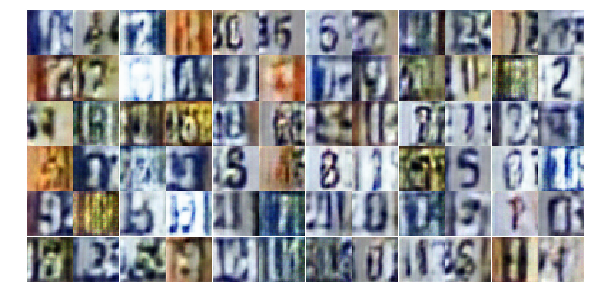

Epoch 6/25... Discriminator Loss: 0.5878... Generator Loss: 1.5587
Epoch 6/25... Discriminator Loss: 0.6231... Generator Loss: 1.2074
Epoch 6/25... Discriminator Loss: 0.8054... Generator Loss: 0.9185
Epoch 6/25... Discriminator Loss: 0.6780... Generator Loss: 0.9716
Epoch 6/25... Discriminator Loss: 0.5359... Generator Loss: 2.2008
Epoch 6/25... Discriminator Loss: 1.8614... Generator Loss: 2.5816
Epoch 6/25... Discriminator Loss: 0.8138... Generator Loss: 0.8437
Epoch 6/25... Discriminator Loss: 0.4215... Generator Loss: 1.5549
Epoch 6/25... Discriminator Loss: 0.4023... Generator Loss: 1.6876
Epoch 6/25... Discriminator Loss: 0.3774... Generator Loss: 1.9961


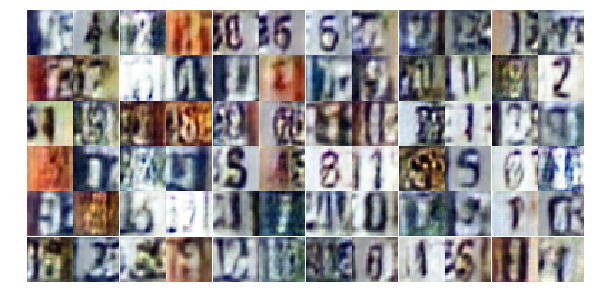

Epoch 6/25... Discriminator Loss: 0.6670... Generator Loss: 1.1046
Epoch 6/25... Discriminator Loss: 0.9257... Generator Loss: 3.1396
Epoch 6/25... Discriminator Loss: 0.5718... Generator Loss: 1.2739
Epoch 6/25... Discriminator Loss: 0.6506... Generator Loss: 1.2487
Epoch 6/25... Discriminator Loss: 0.6127... Generator Loss: 1.1434
Epoch 6/25... Discriminator Loss: 1.2310... Generator Loss: 0.5383
Epoch 6/25... Discriminator Loss: 0.5970... Generator Loss: 2.9535
Epoch 6/25... Discriminator Loss: 0.4981... Generator Loss: 1.4667
Epoch 6/25... Discriminator Loss: 0.4672... Generator Loss: 1.3407
Epoch 6/25... Discriminator Loss: 0.3218... Generator Loss: 1.6720


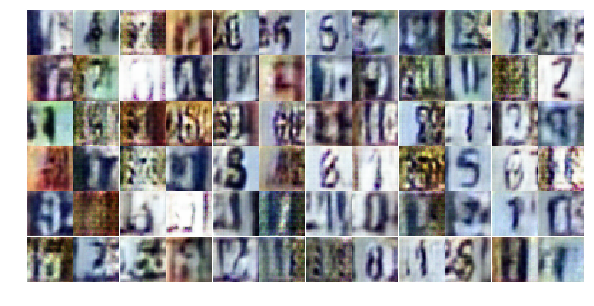

Epoch 6/25... Discriminator Loss: 1.1522... Generator Loss: 3.8016
Epoch 6/25... Discriminator Loss: 0.7335... Generator Loss: 1.6081
Epoch 6/25... Discriminator Loss: 0.9843... Generator Loss: 0.6712
Epoch 6/25... Discriminator Loss: 0.5439... Generator Loss: 1.6644
Epoch 6/25... Discriminator Loss: 0.5281... Generator Loss: 1.5085
Epoch 6/25... Discriminator Loss: 0.7555... Generator Loss: 0.8749
Epoch 6/25... Discriminator Loss: 0.6239... Generator Loss: 1.1446
Epoch 6/25... Discriminator Loss: 0.8436... Generator Loss: 0.7672
Epoch 6/25... Discriminator Loss: 0.3865... Generator Loss: 1.7662
Epoch 6/25... Discriminator Loss: 3.0028... Generator Loss: 0.1237


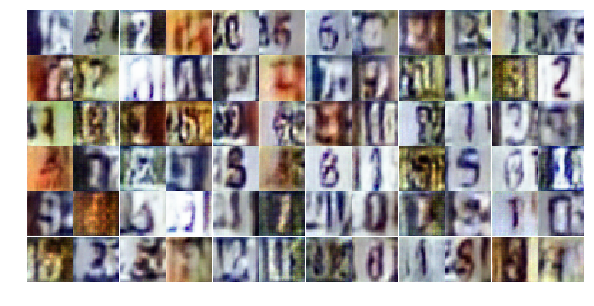

Epoch 6/25... Discriminator Loss: 0.6205... Generator Loss: 1.4425
Epoch 6/25... Discriminator Loss: 0.4687... Generator Loss: 1.5050
Epoch 6/25... Discriminator Loss: 0.4145... Generator Loss: 1.7638
Epoch 7/25... Discriminator Loss: 1.0917... Generator Loss: 3.1772
Epoch 7/25... Discriminator Loss: 0.8004... Generator Loss: 0.9303
Epoch 7/25... Discriminator Loss: 0.6867... Generator Loss: 1.0497
Epoch 7/25... Discriminator Loss: 0.5319... Generator Loss: 1.5037
Epoch 7/25... Discriminator Loss: 0.2901... Generator Loss: 2.1387
Epoch 7/25... Discriminator Loss: 0.4249... Generator Loss: 2.6138
Epoch 7/25... Discriminator Loss: 1.0699... Generator Loss: 0.5687


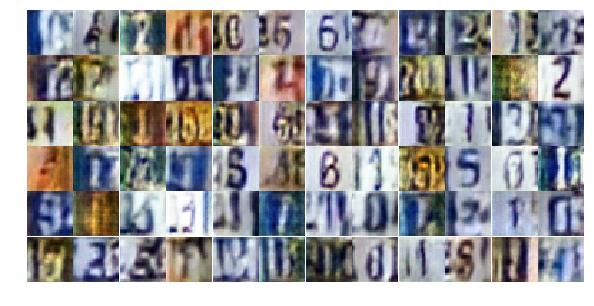

Epoch 7/25... Discriminator Loss: 0.4106... Generator Loss: 2.6944
Epoch 7/25... Discriminator Loss: 0.6832... Generator Loss: 0.9277
Epoch 7/25... Discriminator Loss: 0.7476... Generator Loss: 0.9030
Epoch 7/25... Discriminator Loss: 0.5919... Generator Loss: 2.0484
Epoch 7/25... Discriminator Loss: 0.7274... Generator Loss: 1.0534
Epoch 7/25... Discriminator Loss: 0.5605... Generator Loss: 1.3331
Epoch 7/25... Discriminator Loss: 0.8287... Generator Loss: 4.4216
Epoch 7/25... Discriminator Loss: 1.4696... Generator Loss: 2.9402
Epoch 7/25... Discriminator Loss: 0.7529... Generator Loss: 2.6765
Epoch 7/25... Discriminator Loss: 0.6135... Generator Loss: 1.1323


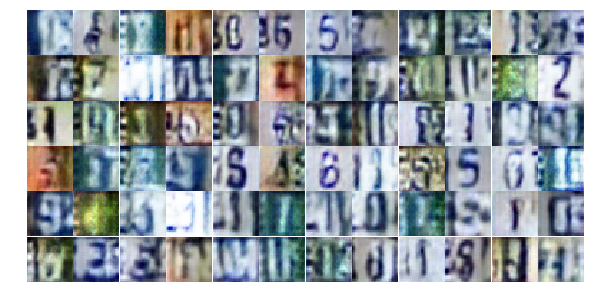

Epoch 7/25... Discriminator Loss: 0.6738... Generator Loss: 1.2143
Epoch 7/25... Discriminator Loss: 0.3971... Generator Loss: 1.9303
Epoch 7/25... Discriminator Loss: 1.2016... Generator Loss: 0.4755
Epoch 7/25... Discriminator Loss: 0.6349... Generator Loss: 1.1906
Epoch 7/25... Discriminator Loss: 0.3362... Generator Loss: 2.2240
Epoch 7/25... Discriminator Loss: 0.4500... Generator Loss: 1.3498
Epoch 7/25... Discriminator Loss: 0.7390... Generator Loss: 0.9291
Epoch 7/25... Discriminator Loss: 1.1445... Generator Loss: 0.6076
Epoch 7/25... Discriminator Loss: 0.3404... Generator Loss: 1.7991
Epoch 7/25... Discriminator Loss: 0.4710... Generator Loss: 2.3084


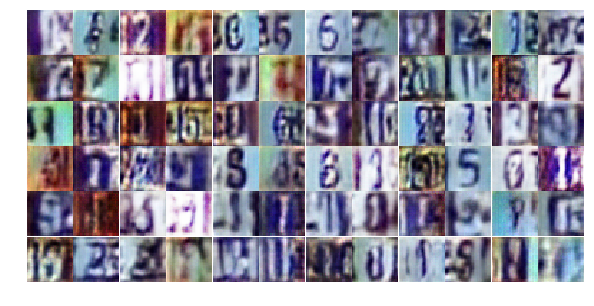

Epoch 7/25... Discriminator Loss: 0.6980... Generator Loss: 0.9988
Epoch 7/25... Discriminator Loss: 0.4760... Generator Loss: 1.3821
Epoch 7/25... Discriminator Loss: 0.5052... Generator Loss: 1.5372
Epoch 7/25... Discriminator Loss: 0.7096... Generator Loss: 0.9691
Epoch 7/25... Discriminator Loss: 0.6246... Generator Loss: 1.2599
Epoch 7/25... Discriminator Loss: 1.2163... Generator Loss: 0.4993
Epoch 7/25... Discriminator Loss: 0.4987... Generator Loss: 1.3220
Epoch 7/25... Discriminator Loss: 0.4250... Generator Loss: 1.6764
Epoch 7/25... Discriminator Loss: 0.9151... Generator Loss: 0.7279
Epoch 7/25... Discriminator Loss: 0.4883... Generator Loss: 2.7108


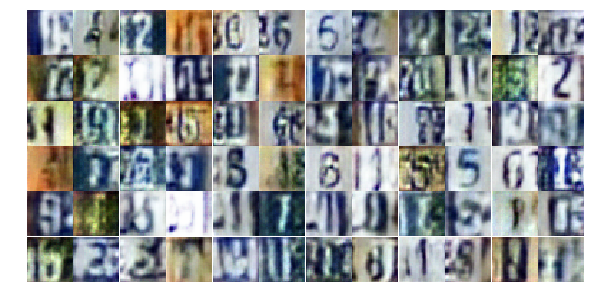

Epoch 7/25... Discriminator Loss: 1.4063... Generator Loss: 0.4086
Epoch 7/25... Discriminator Loss: 0.5629... Generator Loss: 1.7951
Epoch 7/25... Discriminator Loss: 0.3704... Generator Loss: 2.1425
Epoch 7/25... Discriminator Loss: 0.8204... Generator Loss: 2.5364
Epoch 7/25... Discriminator Loss: 0.6460... Generator Loss: 1.0156
Epoch 7/25... Discriminator Loss: 0.1858... Generator Loss: 2.6248
Epoch 7/25... Discriminator Loss: 0.4638... Generator Loss: 1.3964
Epoch 7/25... Discriminator Loss: 0.9528... Generator Loss: 0.7499
Epoch 7/25... Discriminator Loss: 0.4686... Generator Loss: 2.4771
Epoch 7/25... Discriminator Loss: 0.9860... Generator Loss: 0.7254


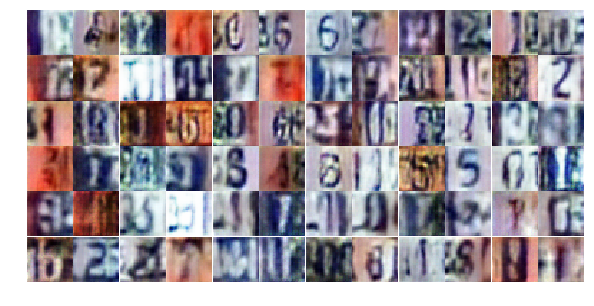

Epoch 7/25... Discriminator Loss: 0.4196... Generator Loss: 1.7608
Epoch 7/25... Discriminator Loss: 0.4536... Generator Loss: 1.6193
Epoch 7/25... Discriminator Loss: 0.6290... Generator Loss: 1.1005
Epoch 7/25... Discriminator Loss: 0.5893... Generator Loss: 1.0676
Epoch 7/25... Discriminator Loss: 0.4894... Generator Loss: 1.2713
Epoch 7/25... Discriminator Loss: 0.5115... Generator Loss: 1.3031
Epoch 7/25... Discriminator Loss: 1.5055... Generator Loss: 0.3701
Epoch 7/25... Discriminator Loss: 0.5110... Generator Loss: 1.8430
Epoch 7/25... Discriminator Loss: 1.8573... Generator Loss: 3.4272
Epoch 7/25... Discriminator Loss: 0.5545... Generator Loss: 1.2168


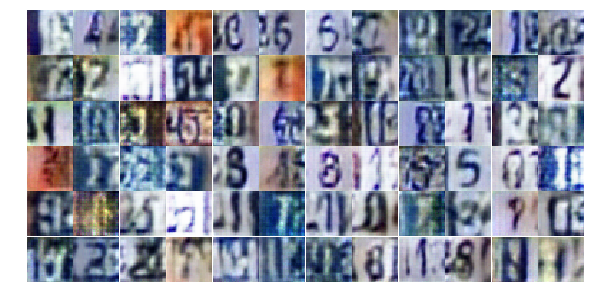

Epoch 7/25... Discriminator Loss: 0.4254... Generator Loss: 1.5829
Epoch 8/25... Discriminator Loss: 0.7013... Generator Loss: 0.9513
Epoch 8/25... Discriminator Loss: 0.6192... Generator Loss: 1.0993
Epoch 8/25... Discriminator Loss: 0.7157... Generator Loss: 1.1940
Epoch 8/25... Discriminator Loss: 0.5330... Generator Loss: 1.7643
Epoch 8/25... Discriminator Loss: 0.8616... Generator Loss: 1.2640
Epoch 8/25... Discriminator Loss: 0.8417... Generator Loss: 0.8434
Epoch 8/25... Discriminator Loss: 0.5683... Generator Loss: 2.7070
Epoch 8/25... Discriminator Loss: 1.0314... Generator Loss: 0.5990
Epoch 8/25... Discriminator Loss: 0.8339... Generator Loss: 0.8744


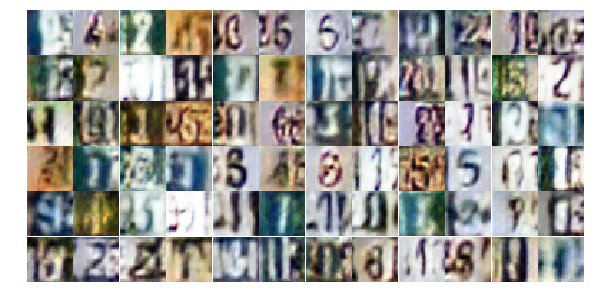

Epoch 8/25... Discriminator Loss: 0.4252... Generator Loss: 2.0566
Epoch 8/25... Discriminator Loss: 0.5344... Generator Loss: 1.2924
Epoch 8/25... Discriminator Loss: 0.5479... Generator Loss: 1.4052
Epoch 8/25... Discriminator Loss: 0.3601... Generator Loss: 2.0213
Epoch 8/25... Discriminator Loss: 0.6621... Generator Loss: 1.1212
Epoch 8/25... Discriminator Loss: 0.5873... Generator Loss: 1.6148
Epoch 8/25... Discriminator Loss: 0.2695... Generator Loss: 2.2406
Epoch 8/25... Discriminator Loss: 0.4201... Generator Loss: 1.7491
Epoch 8/25... Discriminator Loss: 0.6358... Generator Loss: 1.1460
Epoch 8/25... Discriminator Loss: 1.5139... Generator Loss: 0.3453


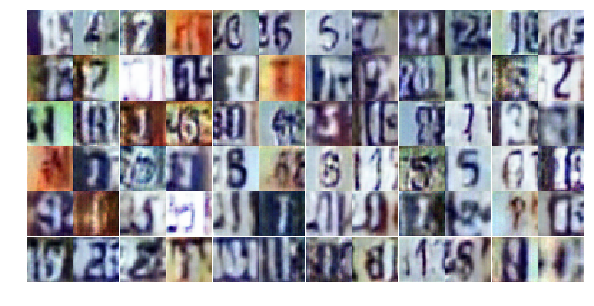

Epoch 8/25... Discriminator Loss: 0.3806... Generator Loss: 2.1065
Epoch 8/25... Discriminator Loss: 0.4158... Generator Loss: 1.6306
Epoch 8/25... Discriminator Loss: 1.0453... Generator Loss: 0.5941
Epoch 8/25... Discriminator Loss: 0.6057... Generator Loss: 1.2533
Epoch 8/25... Discriminator Loss: 0.5620... Generator Loss: 1.0458
Epoch 8/25... Discriminator Loss: 0.5440... Generator Loss: 1.2423
Epoch 8/25... Discriminator Loss: 0.6228... Generator Loss: 1.1679
Epoch 8/25... Discriminator Loss: 0.4675... Generator Loss: 1.3725
Epoch 8/25... Discriminator Loss: 0.4772... Generator Loss: 1.8994
Epoch 8/25... Discriminator Loss: 1.0913... Generator Loss: 0.7969


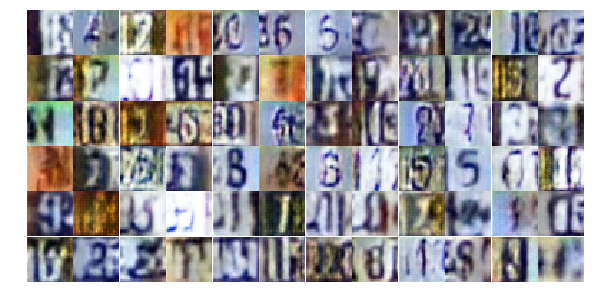

Epoch 8/25... Discriminator Loss: 0.5671... Generator Loss: 1.5457
Epoch 8/25... Discriminator Loss: 1.1480... Generator Loss: 0.5593
Epoch 8/25... Discriminator Loss: 0.4274... Generator Loss: 1.7369
Epoch 8/25... Discriminator Loss: 0.4530... Generator Loss: 1.6989
Epoch 8/25... Discriminator Loss: 0.5376... Generator Loss: 1.3318
Epoch 8/25... Discriminator Loss: 0.4676... Generator Loss: 1.3694
Epoch 8/25... Discriminator Loss: 0.4481... Generator Loss: 1.6052
Epoch 8/25... Discriminator Loss: 0.3918... Generator Loss: 1.7028
Epoch 8/25... Discriminator Loss: 0.5176... Generator Loss: 1.4027
Epoch 8/25... Discriminator Loss: 0.4211... Generator Loss: 1.6315


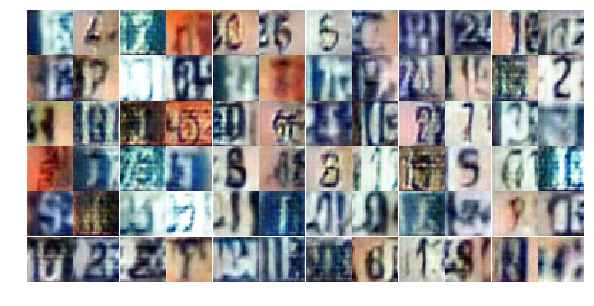

Epoch 8/25... Discriminator Loss: 0.3550... Generator Loss: 2.1145
Epoch 8/25... Discriminator Loss: 1.1267... Generator Loss: 0.5741
Epoch 8/25... Discriminator Loss: 0.3941... Generator Loss: 1.4604
Epoch 8/25... Discriminator Loss: 0.3908... Generator Loss: 1.4835
Epoch 8/25... Discriminator Loss: 3.3994... Generator Loss: 4.3276
Epoch 8/25... Discriminator Loss: 1.4884... Generator Loss: 0.4896
Epoch 8/25... Discriminator Loss: 0.6051... Generator Loss: 1.1576
Epoch 8/25... Discriminator Loss: 0.6583... Generator Loss: 1.4689
Epoch 8/25... Discriminator Loss: 0.4631... Generator Loss: 1.4255
Epoch 8/25... Discriminator Loss: 0.6955... Generator Loss: 1.0371


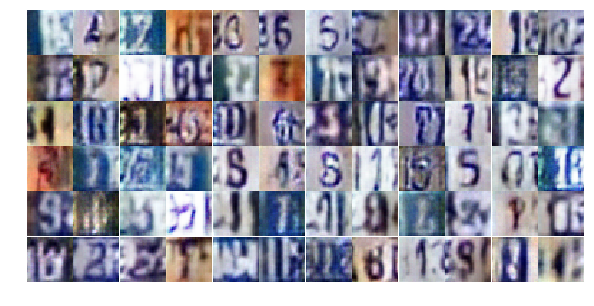

Epoch 8/25... Discriminator Loss: 0.5180... Generator Loss: 1.1967
Epoch 8/25... Discriminator Loss: 0.3917... Generator Loss: 2.2396
Epoch 8/25... Discriminator Loss: 1.2221... Generator Loss: 0.5222
Epoch 8/25... Discriminator Loss: 1.0849... Generator Loss: 0.5494
Epoch 8/25... Discriminator Loss: 0.4894... Generator Loss: 2.0379
Epoch 8/25... Discriminator Loss: 0.7973... Generator Loss: 1.0051
Epoch 8/25... Discriminator Loss: 0.3691... Generator Loss: 1.6994
Epoch 8/25... Discriminator Loss: 0.5498... Generator Loss: 2.4848
Epoch 9/25... Discriminator Loss: 1.1775... Generator Loss: 0.5704
Epoch 9/25... Discriminator Loss: 0.7226... Generator Loss: 0.8759


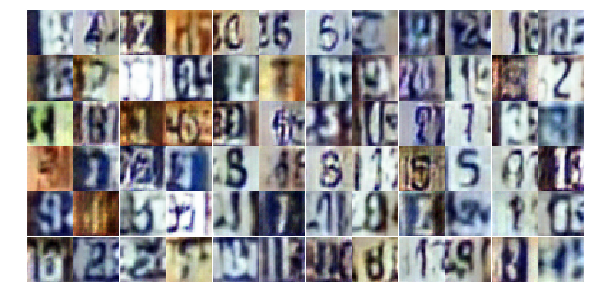

Epoch 9/25... Discriminator Loss: 0.4150... Generator Loss: 1.4933
Epoch 9/25... Discriminator Loss: 0.5329... Generator Loss: 1.3083
Epoch 9/25... Discriminator Loss: 1.3376... Generator Loss: 0.4107
Epoch 9/25... Discriminator Loss: 0.3773... Generator Loss: 1.7736
Epoch 9/25... Discriminator Loss: 0.9153... Generator Loss: 0.6957
Epoch 9/25... Discriminator Loss: 0.6858... Generator Loss: 2.1706
Epoch 9/25... Discriminator Loss: 0.7691... Generator Loss: 1.0436
Epoch 9/25... Discriminator Loss: 0.4687... Generator Loss: 1.3270
Epoch 9/25... Discriminator Loss: 1.0555... Generator Loss: 0.5879
Epoch 9/25... Discriminator Loss: 0.6984... Generator Loss: 0.9204


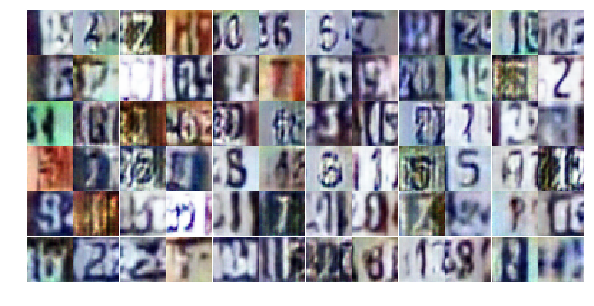

Epoch 9/25... Discriminator Loss: 0.5696... Generator Loss: 1.1863
Epoch 9/25... Discriminator Loss: 1.4806... Generator Loss: 2.5081
Epoch 9/25... Discriminator Loss: 0.6223... Generator Loss: 1.0562
Epoch 9/25... Discriminator Loss: 0.8141... Generator Loss: 0.8814
Epoch 9/25... Discriminator Loss: 0.4013... Generator Loss: 1.7444
Epoch 9/25... Discriminator Loss: 0.5337... Generator Loss: 2.0437
Epoch 9/25... Discriminator Loss: 0.8348... Generator Loss: 0.9510
Epoch 9/25... Discriminator Loss: 0.3182... Generator Loss: 1.8854
Epoch 9/25... Discriminator Loss: 0.7178... Generator Loss: 1.0258
Epoch 9/25... Discriminator Loss: 0.7246... Generator Loss: 0.9360


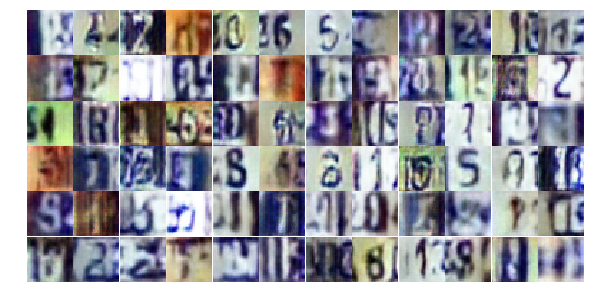

Epoch 9/25... Discriminator Loss: 0.7859... Generator Loss: 0.8725
Epoch 9/25... Discriminator Loss: 0.6091... Generator Loss: 1.1949
Epoch 9/25... Discriminator Loss: 0.4201... Generator Loss: 2.0306
Epoch 9/25... Discriminator Loss: 0.4019... Generator Loss: 1.7985
Epoch 9/25... Discriminator Loss: 0.5547... Generator Loss: 1.1631
Epoch 9/25... Discriminator Loss: 0.4865... Generator Loss: 3.0310
Epoch 9/25... Discriminator Loss: 1.7189... Generator Loss: 0.3414
Epoch 9/25... Discriminator Loss: 0.6033... Generator Loss: 1.1296
Epoch 9/25... Discriminator Loss: 0.3705... Generator Loss: 2.0845
Epoch 9/25... Discriminator Loss: 0.7010... Generator Loss: 0.9458


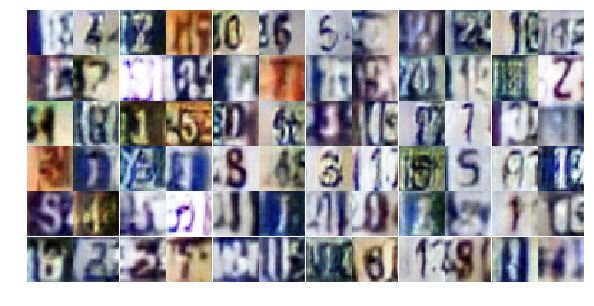

Epoch 9/25... Discriminator Loss: 0.5658... Generator Loss: 1.1615
Epoch 9/25... Discriminator Loss: 0.6626... Generator Loss: 1.0337
Epoch 9/25... Discriminator Loss: 1.3374... Generator Loss: 0.4356
Epoch 9/25... Discriminator Loss: 0.9121... Generator Loss: 0.6671
Epoch 9/25... Discriminator Loss: 0.6573... Generator Loss: 1.2822
Epoch 9/25... Discriminator Loss: 0.5516... Generator Loss: 1.1862
Epoch 9/25... Discriminator Loss: 0.5379... Generator Loss: 1.3224
Epoch 9/25... Discriminator Loss: 0.3836... Generator Loss: 1.5787
Epoch 9/25... Discriminator Loss: 1.0469... Generator Loss: 0.5857
Epoch 9/25... Discriminator Loss: 0.7345... Generator Loss: 0.9080


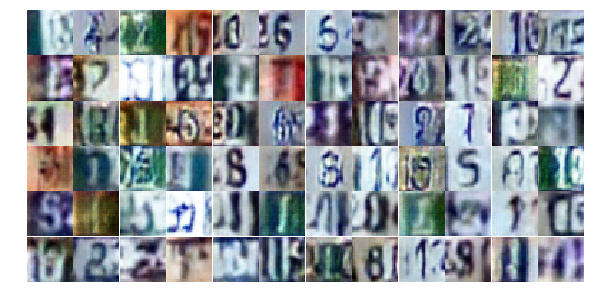

Epoch 9/25... Discriminator Loss: 0.3101... Generator Loss: 2.2253
Epoch 9/25... Discriminator Loss: 0.6000... Generator Loss: 1.1771
Epoch 9/25... Discriminator Loss: 0.5525... Generator Loss: 1.2674
Epoch 9/25... Discriminator Loss: 0.6739... Generator Loss: 2.6301
Epoch 9/25... Discriminator Loss: 0.4933... Generator Loss: 2.4321
Epoch 9/25... Discriminator Loss: 0.6711... Generator Loss: 1.1755
Epoch 9/25... Discriminator Loss: 0.7870... Generator Loss: 0.9264
Epoch 9/25... Discriminator Loss: 1.0173... Generator Loss: 0.6466
Epoch 9/25... Discriminator Loss: 0.4175... Generator Loss: 1.5358
Epoch 9/25... Discriminator Loss: 0.5932... Generator Loss: 1.8304


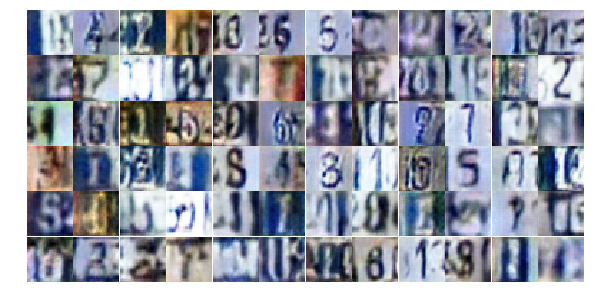

Epoch 9/25... Discriminator Loss: 1.2355... Generator Loss: 0.5357
Epoch 9/25... Discriminator Loss: 2.6161... Generator Loss: 4.2371
Epoch 9/25... Discriminator Loss: 0.5983... Generator Loss: 1.2777
Epoch 9/25... Discriminator Loss: 0.6196... Generator Loss: 1.1185
Epoch 9/25... Discriminator Loss: 0.4259... Generator Loss: 1.6652
Epoch 10/25... Discriminator Loss: 0.5083... Generator Loss: 1.3990
Epoch 10/25... Discriminator Loss: 0.5888... Generator Loss: 1.4321
Epoch 10/25... Discriminator Loss: 0.7822... Generator Loss: 0.8744
Epoch 10/25... Discriminator Loss: 0.7214... Generator Loss: 1.0082
Epoch 10/25... Discriminator Loss: 1.5140... Generator Loss: 0.3520


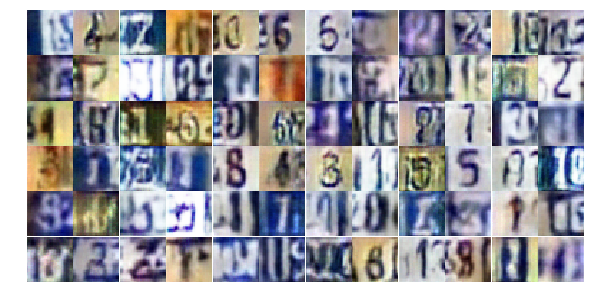

Epoch 10/25... Discriminator Loss: 1.0666... Generator Loss: 0.5404
Epoch 10/25... Discriminator Loss: 0.6044... Generator Loss: 1.0741
Epoch 10/25... Discriminator Loss: 0.5336... Generator Loss: 1.2741
Epoch 10/25... Discriminator Loss: 0.7178... Generator Loss: 1.2598
Epoch 10/25... Discriminator Loss: 0.4266... Generator Loss: 1.5959
Epoch 10/25... Discriminator Loss: 0.6313... Generator Loss: 1.1296
Epoch 10/25... Discriminator Loss: 0.6804... Generator Loss: 0.9592
Epoch 10/25... Discriminator Loss: 1.0868... Generator Loss: 0.6130
Epoch 10/25... Discriminator Loss: 0.6004... Generator Loss: 1.2934
Epoch 10/25... Discriminator Loss: 0.5911... Generator Loss: 1.3138


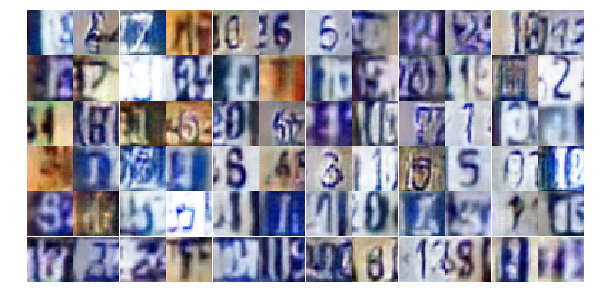

Epoch 10/25... Discriminator Loss: 0.5613... Generator Loss: 1.3625
Epoch 10/25... Discriminator Loss: 0.9196... Generator Loss: 0.7161
Epoch 10/25... Discriminator Loss: 0.6848... Generator Loss: 1.5535
Epoch 10/25... Discriminator Loss: 1.5983... Generator Loss: 0.3051
Epoch 10/25... Discriminator Loss: 0.6951... Generator Loss: 2.8918
Epoch 10/25... Discriminator Loss: 0.6957... Generator Loss: 0.9619
Epoch 10/25... Discriminator Loss: 0.7117... Generator Loss: 0.9259
Epoch 10/25... Discriminator Loss: 0.5330... Generator Loss: 1.3870
Epoch 10/25... Discriminator Loss: 0.6730... Generator Loss: 1.0570
Epoch 10/25... Discriminator Loss: 0.5834... Generator Loss: 2.8976


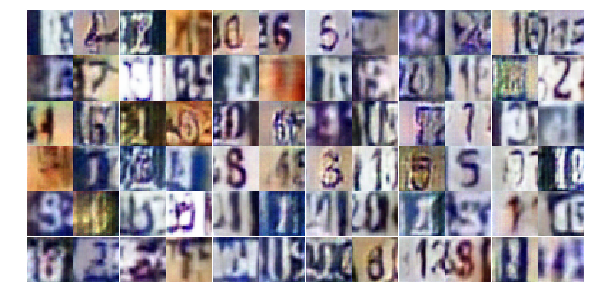

Epoch 10/25... Discriminator Loss: 0.7414... Generator Loss: 0.8561
Epoch 10/25... Discriminator Loss: 0.6651... Generator Loss: 1.1859
Epoch 10/25... Discriminator Loss: 0.4147... Generator Loss: 1.8220
Epoch 10/25... Discriminator Loss: 0.5213... Generator Loss: 1.3301
Epoch 10/25... Discriminator Loss: 1.3303... Generator Loss: 0.4159
Epoch 10/25... Discriminator Loss: 0.7857... Generator Loss: 0.8276
Epoch 10/25... Discriminator Loss: 0.3445... Generator Loss: 1.7380
Epoch 10/25... Discriminator Loss: 0.6151... Generator Loss: 1.1838
Epoch 10/25... Discriminator Loss: 0.3869... Generator Loss: 1.4950
Epoch 10/25... Discriminator Loss: 0.6168... Generator Loss: 1.2199


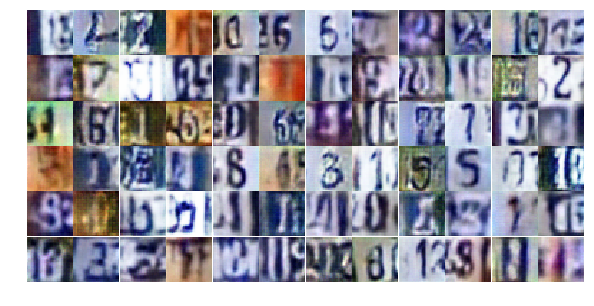

Epoch 10/25... Discriminator Loss: 0.6548... Generator Loss: 1.7305
Epoch 10/25... Discriminator Loss: 0.5488... Generator Loss: 1.4226
Epoch 10/25... Discriminator Loss: 0.8523... Generator Loss: 2.7284
Epoch 10/25... Discriminator Loss: 1.2032... Generator Loss: 0.6185
Epoch 10/25... Discriminator Loss: 0.6539... Generator Loss: 1.1375
Epoch 10/25... Discriminator Loss: 0.7026... Generator Loss: 0.9112
Epoch 10/25... Discriminator Loss: 0.6835... Generator Loss: 1.0763
Epoch 10/25... Discriminator Loss: 0.9115... Generator Loss: 0.6804
Epoch 10/25... Discriminator Loss: 0.6893... Generator Loss: 1.0264
Epoch 10/25... Discriminator Loss: 0.6792... Generator Loss: 0.9815


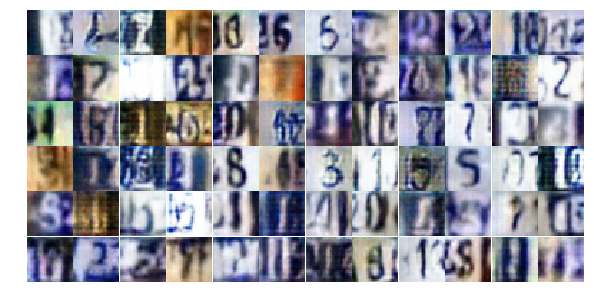

Epoch 10/25... Discriminator Loss: 0.4890... Generator Loss: 1.3665
Epoch 10/25... Discriminator Loss: 0.8573... Generator Loss: 0.8234
Epoch 10/25... Discriminator Loss: 0.5378... Generator Loss: 1.6986
Epoch 10/25... Discriminator Loss: 1.0146... Generator Loss: 0.6366
Epoch 10/25... Discriminator Loss: 0.5410... Generator Loss: 2.1486
Epoch 10/25... Discriminator Loss: 1.5385... Generator Loss: 0.3626
Epoch 10/25... Discriminator Loss: 0.5163... Generator Loss: 1.4165
Epoch 10/25... Discriminator Loss: 0.5552... Generator Loss: 1.2382
Epoch 10/25... Discriminator Loss: 0.4004... Generator Loss: 3.3711
Epoch 10/25... Discriminator Loss: 0.5043... Generator Loss: 1.3942


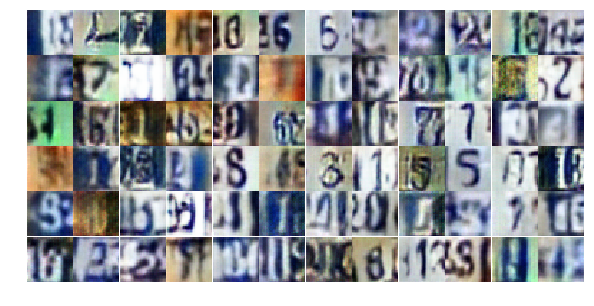

Epoch 10/25... Discriminator Loss: 0.5761... Generator Loss: 2.0942
Epoch 10/25... Discriminator Loss: 0.4602... Generator Loss: 1.3614
Epoch 10/25... Discriminator Loss: 0.6193... Generator Loss: 1.1333
Epoch 11/25... Discriminator Loss: 1.2078... Generator Loss: 0.4779
Epoch 11/25... Discriminator Loss: 0.7392... Generator Loss: 0.8035
Epoch 11/25... Discriminator Loss: 0.7957... Generator Loss: 1.0304
Epoch 11/25... Discriminator Loss: 0.5378... Generator Loss: 1.1550
Epoch 11/25... Discriminator Loss: 0.5493... Generator Loss: 1.5603
Epoch 11/25... Discriminator Loss: 1.7209... Generator Loss: 0.3324
Epoch 11/25... Discriminator Loss: 0.9579... Generator Loss: 0.7620


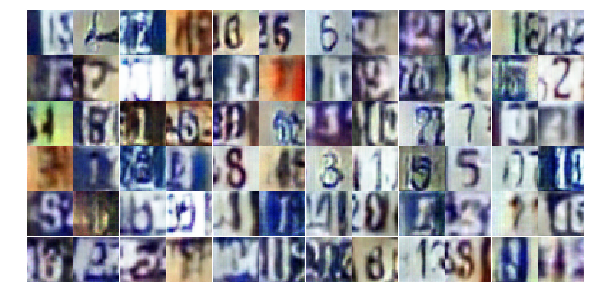

Epoch 11/25... Discriminator Loss: 0.4323... Generator Loss: 1.4381
Epoch 11/25... Discriminator Loss: 0.9955... Generator Loss: 0.6999
Epoch 11/25... Discriminator Loss: 0.4644... Generator Loss: 1.3674
Epoch 11/25... Discriminator Loss: 0.8297... Generator Loss: 0.8274
Epoch 11/25... Discriminator Loss: 1.2638... Generator Loss: 0.4686
Epoch 11/25... Discriminator Loss: 0.8078... Generator Loss: 0.9719
Epoch 11/25... Discriminator Loss: 0.6410... Generator Loss: 1.1184
Epoch 11/25... Discriminator Loss: 0.2900... Generator Loss: 2.1223
Epoch 11/25... Discriminator Loss: 1.1757... Generator Loss: 0.5607
Epoch 11/25... Discriminator Loss: 1.6023... Generator Loss: 0.3437


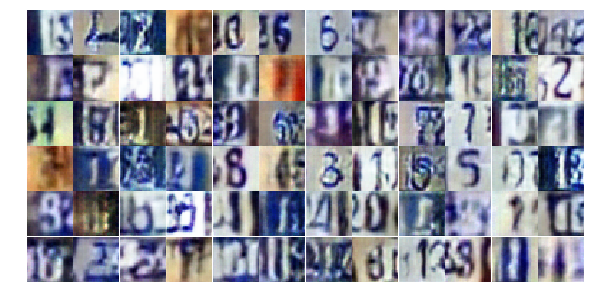

Epoch 11/25... Discriminator Loss: 1.2002... Generator Loss: 0.5286
Epoch 11/25... Discriminator Loss: 0.4681... Generator Loss: 1.5712
Epoch 11/25... Discriminator Loss: 0.6977... Generator Loss: 0.9344
Epoch 11/25... Discriminator Loss: 0.7604... Generator Loss: 0.9023
Epoch 11/25... Discriminator Loss: 0.3493... Generator Loss: 1.9363
Epoch 11/25... Discriminator Loss: 0.4155... Generator Loss: 1.6082
Epoch 11/25... Discriminator Loss: 0.5976... Generator Loss: 1.0868
Epoch 11/25... Discriminator Loss: 1.6460... Generator Loss: 0.3505
Epoch 11/25... Discriminator Loss: 0.4479... Generator Loss: 1.9645
Epoch 11/25... Discriminator Loss: 0.7928... Generator Loss: 0.8075


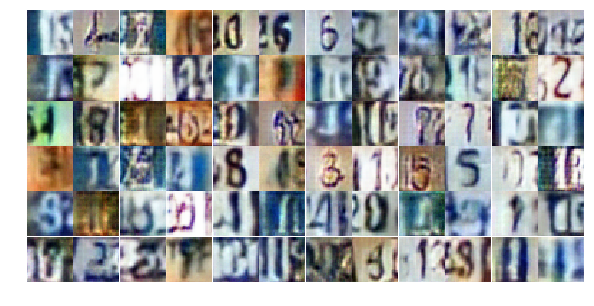

Epoch 11/25... Discriminator Loss: 0.6917... Generator Loss: 1.1027
Epoch 11/25... Discriminator Loss: 0.7014... Generator Loss: 0.9091
Epoch 11/25... Discriminator Loss: 0.7652... Generator Loss: 0.9939
Epoch 11/25... Discriminator Loss: 0.6338... Generator Loss: 1.0225
Epoch 11/25... Discriminator Loss: 0.7323... Generator Loss: 0.9412
Epoch 11/25... Discriminator Loss: 1.1595... Generator Loss: 0.5254
Epoch 11/25... Discriminator Loss: 1.0215... Generator Loss: 0.6408
Epoch 11/25... Discriminator Loss: 0.9585... Generator Loss: 0.6737
Epoch 11/25... Discriminator Loss: 0.5479... Generator Loss: 1.2103
Epoch 11/25... Discriminator Loss: 1.2347... Generator Loss: 0.4698


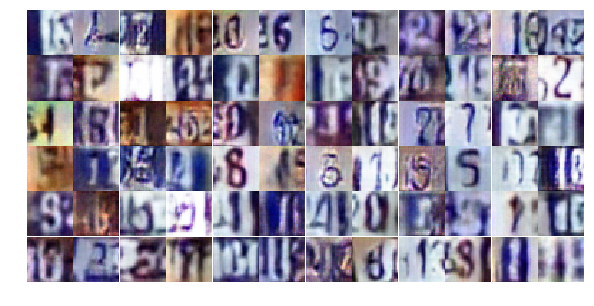

Epoch 11/25... Discriminator Loss: 0.7340... Generator Loss: 0.8994
Epoch 11/25... Discriminator Loss: 0.4351... Generator Loss: 1.5422
Epoch 11/25... Discriminator Loss: 0.4913... Generator Loss: 1.3304
Epoch 11/25... Discriminator Loss: 0.7562... Generator Loss: 2.3801
Epoch 11/25... Discriminator Loss: 0.6807... Generator Loss: 0.9444
Epoch 11/25... Discriminator Loss: 0.6079... Generator Loss: 1.1720
Epoch 11/25... Discriminator Loss: 0.2268... Generator Loss: 2.3507
Epoch 11/25... Discriminator Loss: 1.7790... Generator Loss: 0.2879
Epoch 11/25... Discriminator Loss: 1.1675... Generator Loss: 0.5522
Epoch 11/25... Discriminator Loss: 0.4867... Generator Loss: 1.3991


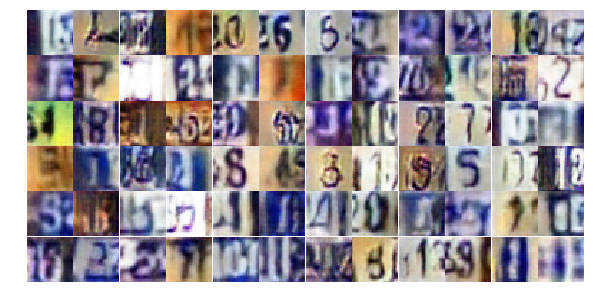

Epoch 11/25... Discriminator Loss: 0.8575... Generator Loss: 0.7617
Epoch 11/25... Discriminator Loss: 0.3986... Generator Loss: 1.8248
Epoch 11/25... Discriminator Loss: 0.6648... Generator Loss: 1.0477
Epoch 11/25... Discriminator Loss: 0.5861... Generator Loss: 1.0545
Epoch 11/25... Discriminator Loss: 1.1978... Generator Loss: 0.5144
Epoch 11/25... Discriminator Loss: 0.7300... Generator Loss: 0.9384
Epoch 11/25... Discriminator Loss: 0.6030... Generator Loss: 1.1319
Epoch 11/25... Discriminator Loss: 0.3647... Generator Loss: 1.8593
Epoch 11/25... Discriminator Loss: 1.0040... Generator Loss: 0.6872
Epoch 11/25... Discriminator Loss: 0.6332... Generator Loss: 1.4841


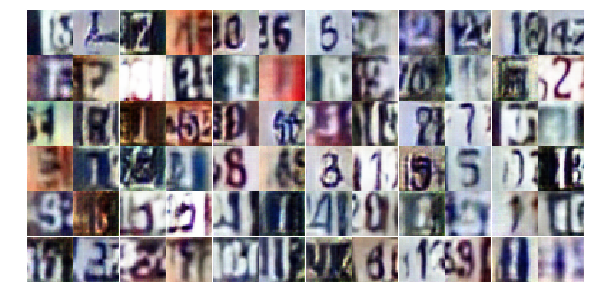

Epoch 12/25... Discriminator Loss: 0.5937... Generator Loss: 1.3222
Epoch 12/25... Discriminator Loss: 0.7040... Generator Loss: 0.9445
Epoch 12/25... Discriminator Loss: 0.8564... Generator Loss: 0.8597
Epoch 12/25... Discriminator Loss: 0.3966... Generator Loss: 1.7901
Epoch 12/25... Discriminator Loss: 0.3725... Generator Loss: 1.7475
Epoch 12/25... Discriminator Loss: 1.0835... Generator Loss: 0.6145
Epoch 12/25... Discriminator Loss: 0.7009... Generator Loss: 2.4718
Epoch 12/25... Discriminator Loss: 0.6673... Generator Loss: 1.1918
Epoch 12/25... Discriminator Loss: 0.6302... Generator Loss: 1.6888
Epoch 12/25... Discriminator Loss: 1.4200... Generator Loss: 0.4013


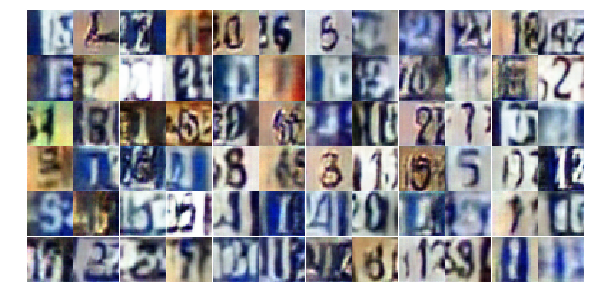

Epoch 12/25... Discriminator Loss: 0.5422... Generator Loss: 1.2351
Epoch 12/25... Discriminator Loss: 0.9103... Generator Loss: 0.7211
Epoch 12/25... Discriminator Loss: 0.4809... Generator Loss: 1.2729
Epoch 12/25... Discriminator Loss: 0.9928... Generator Loss: 2.9040
Epoch 12/25... Discriminator Loss: 0.5558... Generator Loss: 1.6168
Epoch 12/25... Discriminator Loss: 2.7754... Generator Loss: 0.2749
Epoch 12/25... Discriminator Loss: 1.2775... Generator Loss: 0.4693
Epoch 12/25... Discriminator Loss: 0.4359... Generator Loss: 1.7443
Epoch 12/25... Discriminator Loss: 0.5166... Generator Loss: 1.2204
Epoch 12/25... Discriminator Loss: 0.8041... Generator Loss: 0.8173


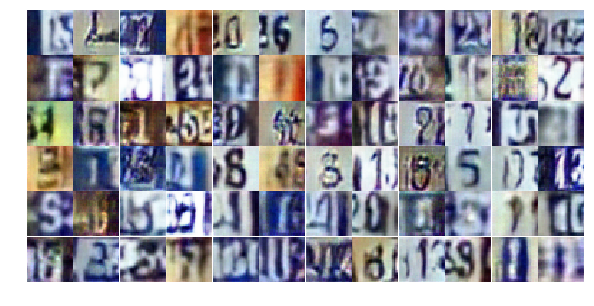

Epoch 12/25... Discriminator Loss: 0.4367... Generator Loss: 1.5549
Epoch 12/25... Discriminator Loss: 0.4248... Generator Loss: 1.7903
Epoch 12/25... Discriminator Loss: 0.5820... Generator Loss: 1.1418
Epoch 12/25... Discriminator Loss: 0.5285... Generator Loss: 2.3269
Epoch 12/25... Discriminator Loss: 0.3844... Generator Loss: 1.8080
Epoch 12/25... Discriminator Loss: 0.4666... Generator Loss: 2.0593
Epoch 12/25... Discriminator Loss: 0.4595... Generator Loss: 1.3787
Epoch 12/25... Discriminator Loss: 0.2922... Generator Loss: 1.8205
Epoch 12/25... Discriminator Loss: 0.5586... Generator Loss: 1.2284
Epoch 12/25... Discriminator Loss: 0.7009... Generator Loss: 0.9562


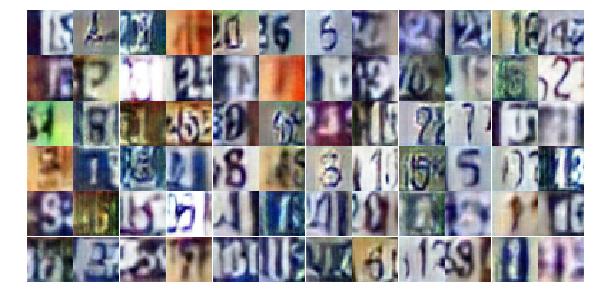

Epoch 12/25... Discriminator Loss: 0.5479... Generator Loss: 1.2903
Epoch 12/25... Discriminator Loss: 0.9204... Generator Loss: 0.7185
Epoch 12/25... Discriminator Loss: 0.8729... Generator Loss: 0.7267
Epoch 12/25... Discriminator Loss: 1.6473... Generator Loss: 0.3621
Epoch 12/25... Discriminator Loss: 0.5915... Generator Loss: 1.3906
Epoch 12/25... Discriminator Loss: 0.6960... Generator Loss: 1.0055
Epoch 12/25... Discriminator Loss: 0.8256... Generator Loss: 0.7879
Epoch 12/25... Discriminator Loss: 0.7706... Generator Loss: 1.1579
Epoch 12/25... Discriminator Loss: 0.4064... Generator Loss: 1.7423
Epoch 12/25... Discriminator Loss: 0.2992... Generator Loss: 1.8258


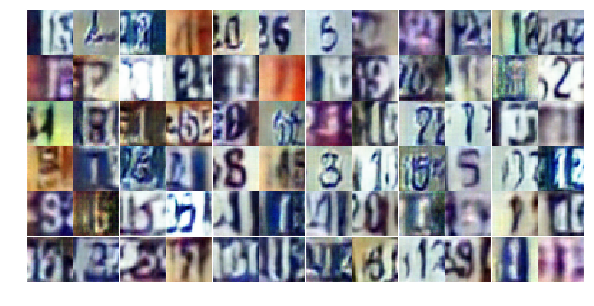

Epoch 12/25... Discriminator Loss: 0.6114... Generator Loss: 1.0923
Epoch 12/25... Discriminator Loss: 0.4567... Generator Loss: 1.2498
Epoch 12/25... Discriminator Loss: 0.3464... Generator Loss: 1.6327
Epoch 12/25... Discriminator Loss: 0.9978... Generator Loss: 0.6594
Epoch 12/25... Discriminator Loss: 0.6533... Generator Loss: 1.0339
Epoch 12/25... Discriminator Loss: 2.1276... Generator Loss: 0.2148
Epoch 12/25... Discriminator Loss: 1.4782... Generator Loss: 1.8928
Epoch 12/25... Discriminator Loss: 1.0099... Generator Loss: 0.6879
Epoch 12/25... Discriminator Loss: 0.6807... Generator Loss: 1.1916
Epoch 12/25... Discriminator Loss: 0.5679... Generator Loss: 1.2099


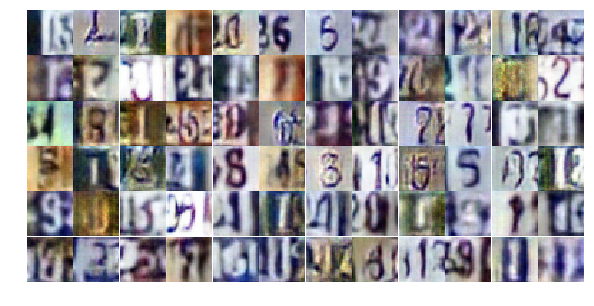

Epoch 12/25... Discriminator Loss: 0.7779... Generator Loss: 0.9526
Epoch 12/25... Discriminator Loss: 0.4961... Generator Loss: 1.5198
Epoch 12/25... Discriminator Loss: 0.7332... Generator Loss: 1.0725
Epoch 12/25... Discriminator Loss: 1.0741... Generator Loss: 0.5672
Epoch 12/25... Discriminator Loss: 0.6018... Generator Loss: 1.0741
Epoch 12/25... Discriminator Loss: 0.8542... Generator Loss: 3.6324
Epoch 12/25... Discriminator Loss: 1.1355... Generator Loss: 0.5359
Epoch 13/25... Discriminator Loss: 0.6112... Generator Loss: 1.1923
Epoch 13/25... Discriminator Loss: 0.3446... Generator Loss: 1.8668
Epoch 13/25... Discriminator Loss: 0.7172... Generator Loss: 0.8806


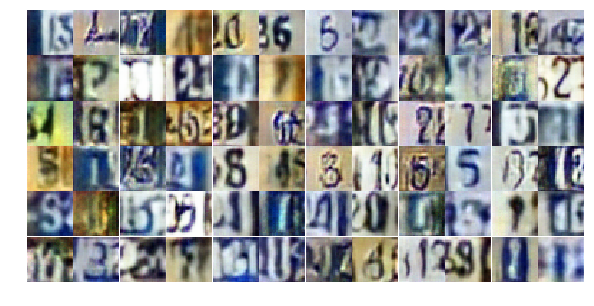

Epoch 13/25... Discriminator Loss: 0.5154... Generator Loss: 1.4255
Epoch 13/25... Discriminator Loss: 0.5805... Generator Loss: 1.3997
Epoch 13/25... Discriminator Loss: 0.9592... Generator Loss: 1.3227
Epoch 13/25... Discriminator Loss: 0.7325... Generator Loss: 1.1000
Epoch 13/25... Discriminator Loss: 0.5195... Generator Loss: 1.3373
Epoch 13/25... Discriminator Loss: 0.4573... Generator Loss: 1.6745
Epoch 13/25... Discriminator Loss: 0.4304... Generator Loss: 1.4033
Epoch 13/25... Discriminator Loss: 0.5682... Generator Loss: 1.1191
Epoch 13/25... Discriminator Loss: 0.5673... Generator Loss: 1.1221
Epoch 13/25... Discriminator Loss: 0.4494... Generator Loss: 1.5031


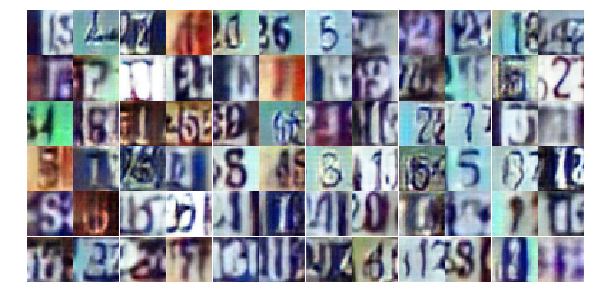

Epoch 13/25... Discriminator Loss: 0.6899... Generator Loss: 1.2504
Epoch 13/25... Discriminator Loss: 0.6194... Generator Loss: 1.0888
Epoch 13/25... Discriminator Loss: 0.7355... Generator Loss: 0.9337
Epoch 13/25... Discriminator Loss: 0.8247... Generator Loss: 0.8066
Epoch 13/25... Discriminator Loss: 0.8879... Generator Loss: 1.2536
Epoch 13/25... Discriminator Loss: 0.9360... Generator Loss: 1.7490
Epoch 13/25... Discriminator Loss: 0.9542... Generator Loss: 0.6464
Epoch 13/25... Discriminator Loss: 1.0914... Generator Loss: 0.6112
Epoch 13/25... Discriminator Loss: 0.5786... Generator Loss: 1.1141
Epoch 13/25... Discriminator Loss: 0.5714... Generator Loss: 1.3439


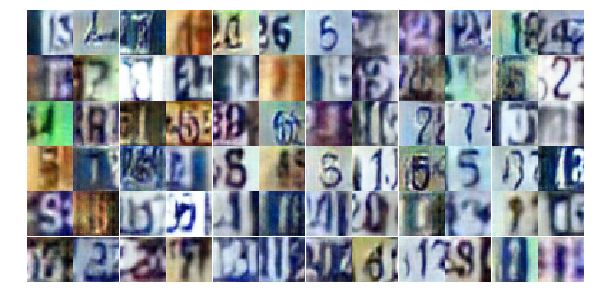

Epoch 13/25... Discriminator Loss: 0.7771... Generator Loss: 0.8657
Epoch 13/25... Discriminator Loss: 0.5179... Generator Loss: 1.6020
Epoch 13/25... Discriminator Loss: 0.4669... Generator Loss: 1.9496
Epoch 13/25... Discriminator Loss: 0.7846... Generator Loss: 0.8264
Epoch 13/25... Discriminator Loss: 0.4989... Generator Loss: 1.3313
Epoch 13/25... Discriminator Loss: 1.7580... Generator Loss: 0.3019
Epoch 13/25... Discriminator Loss: 0.7262... Generator Loss: 1.0246
Epoch 13/25... Discriminator Loss: 0.5117... Generator Loss: 1.3002
Epoch 13/25... Discriminator Loss: 0.5137... Generator Loss: 1.2676
Epoch 13/25... Discriminator Loss: 0.4578... Generator Loss: 1.6190


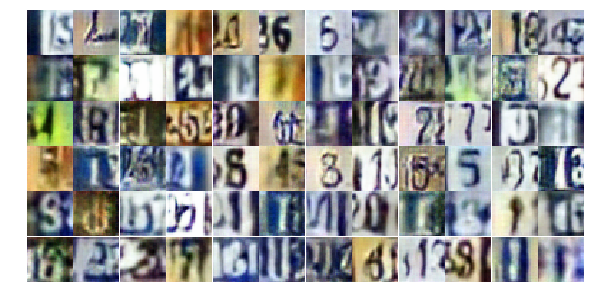

Epoch 13/25... Discriminator Loss: 1.1070... Generator Loss: 0.5203
Epoch 13/25... Discriminator Loss: 0.7528... Generator Loss: 0.9204
Epoch 13/25... Discriminator Loss: 0.8396... Generator Loss: 0.7973
Epoch 13/25... Discriminator Loss: 1.1077... Generator Loss: 0.5612
Epoch 13/25... Discriminator Loss: 0.7027... Generator Loss: 0.9324
Epoch 13/25... Discriminator Loss: 0.4490... Generator Loss: 1.8003
Epoch 13/25... Discriminator Loss: 0.3466... Generator Loss: 1.7584
Epoch 13/25... Discriminator Loss: 1.2399... Generator Loss: 0.4825
Epoch 13/25... Discriminator Loss: 0.6594... Generator Loss: 0.9823
Epoch 13/25... Discriminator Loss: 0.4856... Generator Loss: 2.0240


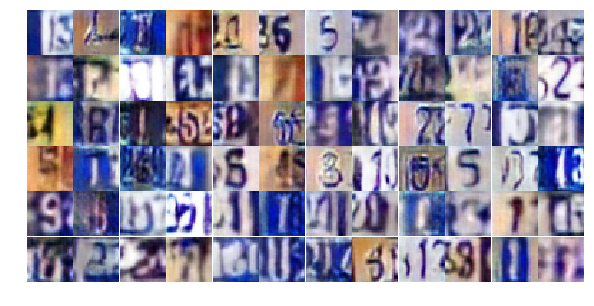

Epoch 13/25... Discriminator Loss: 0.4861... Generator Loss: 1.3388
Epoch 13/25... Discriminator Loss: 0.8120... Generator Loss: 0.8415
Epoch 13/25... Discriminator Loss: 1.0378... Generator Loss: 0.6046
Epoch 13/25... Discriminator Loss: 0.3772... Generator Loss: 1.7149
Epoch 13/25... Discriminator Loss: 0.7459... Generator Loss: 0.9157
Epoch 13/25... Discriminator Loss: 0.8722... Generator Loss: 0.7746
Epoch 13/25... Discriminator Loss: 0.5926... Generator Loss: 1.2116
Epoch 13/25... Discriminator Loss: 0.6764... Generator Loss: 0.9647
Epoch 13/25... Discriminator Loss: 1.0489... Generator Loss: 0.6550
Epoch 13/25... Discriminator Loss: 0.7525... Generator Loss: 0.9287


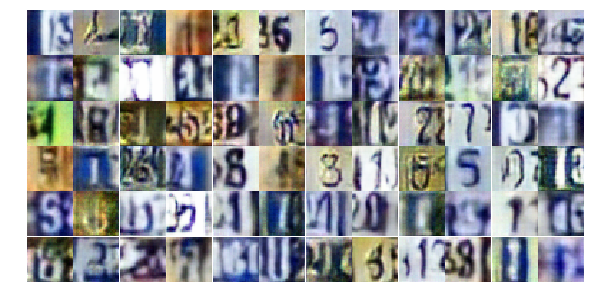

Epoch 13/25... Discriminator Loss: 0.6715... Generator Loss: 1.0897
Epoch 13/25... Discriminator Loss: 2.0194... Generator Loss: 0.4025
Epoch 13/25... Discriminator Loss: 0.7583... Generator Loss: 1.7857
Epoch 13/25... Discriminator Loss: 0.7531... Generator Loss: 1.0138
Epoch 14/25... Discriminator Loss: 0.9866... Generator Loss: 0.7265
Epoch 14/25... Discriminator Loss: 0.6483... Generator Loss: 1.2368
Epoch 14/25... Discriminator Loss: 0.9982... Generator Loss: 0.6465
Epoch 14/25... Discriminator Loss: 0.5664... Generator Loss: 1.7230
Epoch 14/25... Discriminator Loss: 0.5571... Generator Loss: 1.2354
Epoch 14/25... Discriminator Loss: 0.6441... Generator Loss: 1.0953


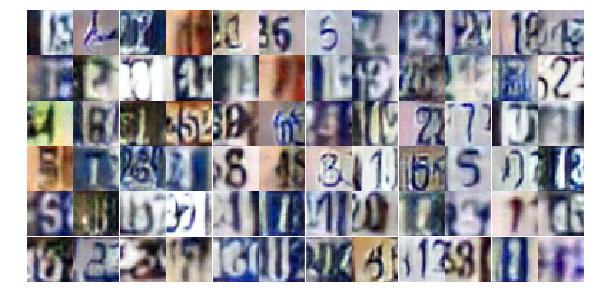

Epoch 14/25... Discriminator Loss: 0.8054... Generator Loss: 1.7947
Epoch 14/25... Discriminator Loss: 0.8023... Generator Loss: 0.8250
Epoch 14/25... Discriminator Loss: 0.7471... Generator Loss: 0.9188
Epoch 14/25... Discriminator Loss: 0.7099... Generator Loss: 0.9501
Epoch 14/25... Discriminator Loss: 1.2326... Generator Loss: 0.4556
Epoch 14/25... Discriminator Loss: 0.4259... Generator Loss: 1.3390
Epoch 14/25... Discriminator Loss: 0.3452... Generator Loss: 1.7182
Epoch 14/25... Discriminator Loss: 1.2763... Generator Loss: 0.4946
Epoch 14/25... Discriminator Loss: 1.3723... Generator Loss: 0.3907
Epoch 14/25... Discriminator Loss: 1.0215... Generator Loss: 0.6146


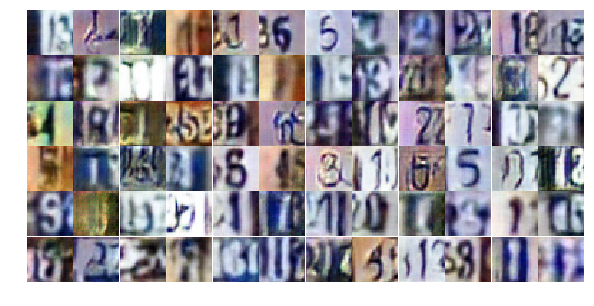

Epoch 14/25... Discriminator Loss: 0.6496... Generator Loss: 0.9680
Epoch 14/25... Discriminator Loss: 0.9036... Generator Loss: 2.6258
Epoch 14/25... Discriminator Loss: 0.7265... Generator Loss: 2.2312
Epoch 14/25... Discriminator Loss: 0.5740... Generator Loss: 1.2876
Epoch 14/25... Discriminator Loss: 1.0668... Generator Loss: 0.6036
Epoch 14/25... Discriminator Loss: 0.6952... Generator Loss: 1.6429
Epoch 14/25... Discriminator Loss: 0.7048... Generator Loss: 0.9793
Epoch 14/25... Discriminator Loss: 0.4929... Generator Loss: 1.5664
Epoch 14/25... Discriminator Loss: 0.5378... Generator Loss: 1.3360
Epoch 14/25... Discriminator Loss: 0.3898... Generator Loss: 1.7211


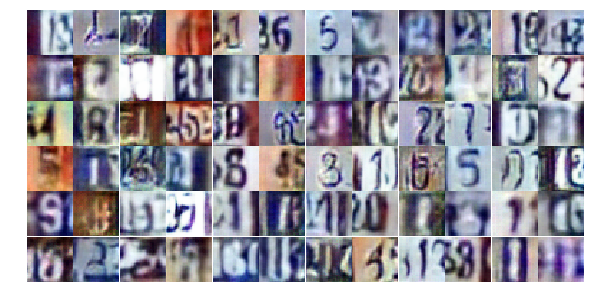

Epoch 14/25... Discriminator Loss: 1.1793... Generator Loss: 0.5374
Epoch 14/25... Discriminator Loss: 0.5278... Generator Loss: 1.1815
Epoch 14/25... Discriminator Loss: 0.5433... Generator Loss: 1.1600
Epoch 14/25... Discriminator Loss: 0.5112... Generator Loss: 1.2530
Epoch 14/25... Discriminator Loss: 0.5443... Generator Loss: 1.1632
Epoch 14/25... Discriminator Loss: 0.5881... Generator Loss: 1.1497
Epoch 14/25... Discriminator Loss: 0.6709... Generator Loss: 0.9939
Epoch 14/25... Discriminator Loss: 0.3894... Generator Loss: 1.5347
Epoch 14/25... Discriminator Loss: 0.5144... Generator Loss: 1.8907
Epoch 14/25... Discriminator Loss: 0.5500... Generator Loss: 1.7594


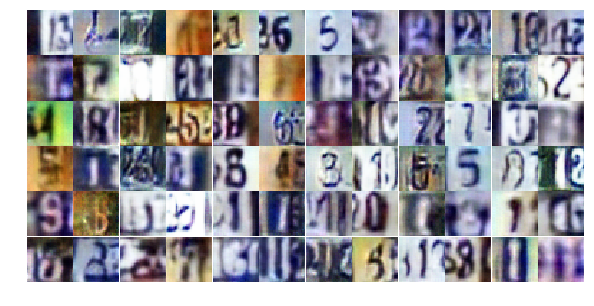

Epoch 14/25... Discriminator Loss: 1.5153... Generator Loss: 0.3754
Epoch 14/25... Discriminator Loss: 0.7084... Generator Loss: 1.0033
Epoch 14/25... Discriminator Loss: 0.8194... Generator Loss: 0.8125
Epoch 14/25... Discriminator Loss: 0.9409... Generator Loss: 0.7148
Epoch 14/25... Discriminator Loss: 0.9263... Generator Loss: 0.7116
Epoch 14/25... Discriminator Loss: 1.0500... Generator Loss: 0.6161
Epoch 14/25... Discriminator Loss: 0.6033... Generator Loss: 1.3465
Epoch 14/25... Discriminator Loss: 0.6172... Generator Loss: 1.0787
Epoch 14/25... Discriminator Loss: 0.6398... Generator Loss: 1.0989
Epoch 14/25... Discriminator Loss: 1.1069... Generator Loss: 0.5716


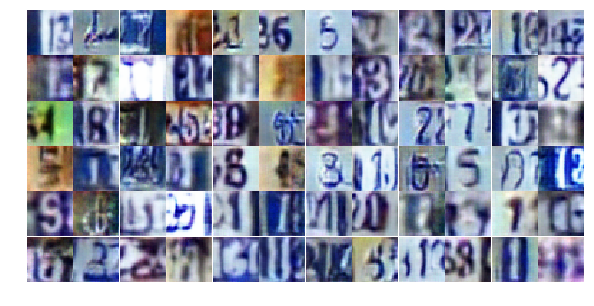

Epoch 14/25... Discriminator Loss: 1.2201... Generator Loss: 0.5592
Epoch 14/25... Discriminator Loss: 1.4080... Generator Loss: 0.4126
Epoch 14/25... Discriminator Loss: 0.7810... Generator Loss: 0.9578
Epoch 14/25... Discriminator Loss: 0.8760... Generator Loss: 0.8227
Epoch 14/25... Discriminator Loss: 0.7581... Generator Loss: 0.8739
Epoch 14/25... Discriminator Loss: 0.6801... Generator Loss: 1.0011
Epoch 14/25... Discriminator Loss: 0.6410... Generator Loss: 1.7958
Epoch 14/25... Discriminator Loss: 0.7999... Generator Loss: 1.0357
Epoch 14/25... Discriminator Loss: 1.2352... Generator Loss: 0.5115
Epoch 14/25... Discriminator Loss: 2.0110... Generator Loss: 0.2047


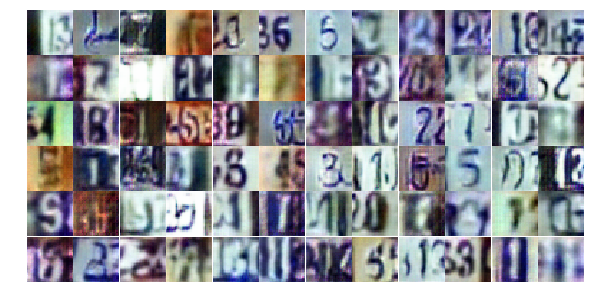

Epoch 14/25... Discriminator Loss: 0.6636... Generator Loss: 1.1654
Epoch 14/25... Discriminator Loss: 1.0789... Generator Loss: 0.5922
Epoch 15/25... Discriminator Loss: 0.5128... Generator Loss: 1.3875
Epoch 15/25... Discriminator Loss: 0.5955... Generator Loss: 1.2564
Epoch 15/25... Discriminator Loss: 0.4551... Generator Loss: 1.6690
Epoch 15/25... Discriminator Loss: 0.9618... Generator Loss: 0.6169
Epoch 15/25... Discriminator Loss: 1.3106... Generator Loss: 0.4429
Epoch 15/25... Discriminator Loss: 0.6317... Generator Loss: 1.0654
Epoch 15/25... Discriminator Loss: 1.3680... Generator Loss: 0.3995
Epoch 15/25... Discriminator Loss: 0.5973... Generator Loss: 1.2469


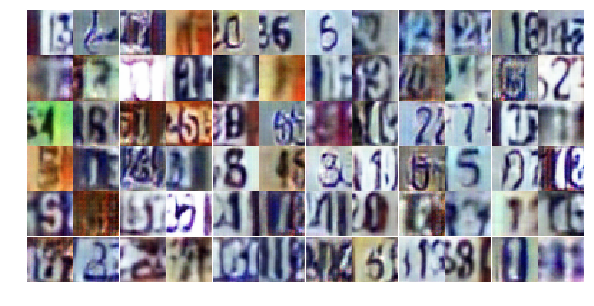

Epoch 15/25... Discriminator Loss: 0.7548... Generator Loss: 0.9225
Epoch 15/25... Discriminator Loss: 0.7762... Generator Loss: 0.9775
Epoch 15/25... Discriminator Loss: 0.6432... Generator Loss: 1.1018
Epoch 15/25... Discriminator Loss: 0.7435... Generator Loss: 0.9211
Epoch 15/25... Discriminator Loss: 0.6986... Generator Loss: 1.1718
Epoch 15/25... Discriminator Loss: 0.6587... Generator Loss: 0.9944
Epoch 15/25... Discriminator Loss: 1.6753... Generator Loss: 0.3014
Epoch 15/25... Discriminator Loss: 1.9869... Generator Loss: 3.1634
Epoch 15/25... Discriminator Loss: 0.5553... Generator Loss: 1.4323
Epoch 15/25... Discriminator Loss: 0.8719... Generator Loss: 0.9368


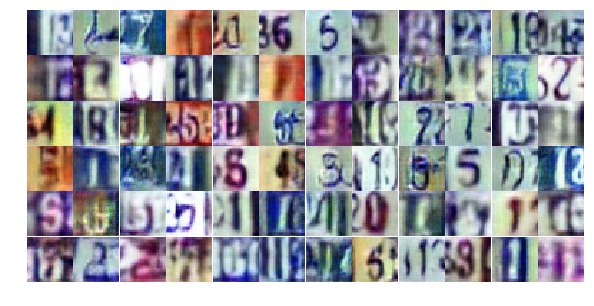

Epoch 15/25... Discriminator Loss: 0.8662... Generator Loss: 0.8451
Epoch 15/25... Discriminator Loss: 0.5948... Generator Loss: 1.2972
Epoch 15/25... Discriminator Loss: 0.4991... Generator Loss: 1.6369
Epoch 15/25... Discriminator Loss: 0.7239... Generator Loss: 1.0089
Epoch 15/25... Discriminator Loss: 1.0294... Generator Loss: 0.6426
Epoch 15/25... Discriminator Loss: 0.6200... Generator Loss: 1.1138
Epoch 15/25... Discriminator Loss: 0.7895... Generator Loss: 1.0117
Epoch 15/25... Discriminator Loss: 0.7471... Generator Loss: 1.3049
Epoch 15/25... Discriminator Loss: 0.4748... Generator Loss: 2.6017
Epoch 15/25... Discriminator Loss: 1.8229... Generator Loss: 0.2323


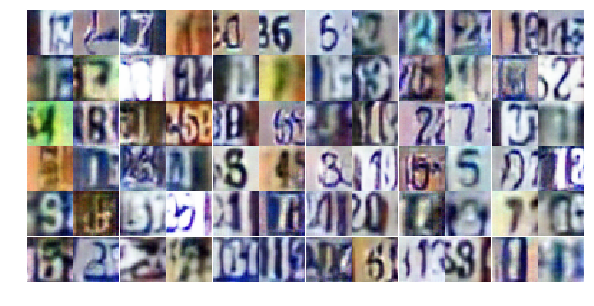

Epoch 15/25... Discriminator Loss: 0.5971... Generator Loss: 1.2492
Epoch 15/25... Discriminator Loss: 0.7992... Generator Loss: 0.8012
Epoch 15/25... Discriminator Loss: 0.4945... Generator Loss: 1.3090
Epoch 15/25... Discriminator Loss: 0.6600... Generator Loss: 0.9770
Epoch 15/25... Discriminator Loss: 0.4714... Generator Loss: 1.4894
Epoch 15/25... Discriminator Loss: 0.6384... Generator Loss: 1.4397
Epoch 15/25... Discriminator Loss: 0.4136... Generator Loss: 1.8311
Epoch 15/25... Discriminator Loss: 0.5437... Generator Loss: 1.2826
Epoch 15/25... Discriminator Loss: 0.5029... Generator Loss: 1.4213
Epoch 15/25... Discriminator Loss: 0.6528... Generator Loss: 1.1784


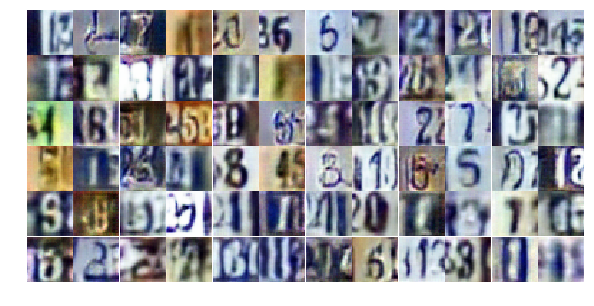

Epoch 15/25... Discriminator Loss: 0.3386... Generator Loss: 1.8029
Epoch 15/25... Discriminator Loss: 1.0612... Generator Loss: 0.7085
Epoch 15/25... Discriminator Loss: 0.7643... Generator Loss: 0.9929
Epoch 15/25... Discriminator Loss: 0.4368... Generator Loss: 1.6002
Epoch 15/25... Discriminator Loss: 0.3300... Generator Loss: 1.9362
Epoch 15/25... Discriminator Loss: 2.2839... Generator Loss: 0.2577
Epoch 15/25... Discriminator Loss: 0.6613... Generator Loss: 1.1766
Epoch 15/25... Discriminator Loss: 0.8260... Generator Loss: 0.9066
Epoch 15/25... Discriminator Loss: 0.7660... Generator Loss: 0.9627
Epoch 15/25... Discriminator Loss: 1.0181... Generator Loss: 0.6645


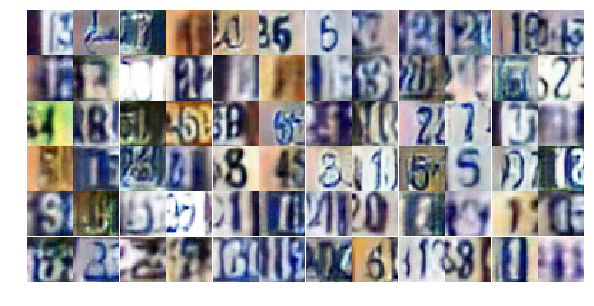

Epoch 15/25... Discriminator Loss: 0.8517... Generator Loss: 0.8139
Epoch 15/25... Discriminator Loss: 0.7653... Generator Loss: 1.0083
Epoch 15/25... Discriminator Loss: 0.4019... Generator Loss: 1.7099
Epoch 15/25... Discriminator Loss: 1.4690... Generator Loss: 0.3842
Epoch 15/25... Discriminator Loss: 0.9253... Generator Loss: 0.7516
Epoch 15/25... Discriminator Loss: 0.8725... Generator Loss: 0.7506
Epoch 15/25... Discriminator Loss: 0.6891... Generator Loss: 1.0389
Epoch 15/25... Discriminator Loss: 0.3505... Generator Loss: 1.9645
Epoch 15/25... Discriminator Loss: 1.2833... Generator Loss: 0.4846
Epoch 16/25... Discriminator Loss: 0.8028... Generator Loss: 0.8404


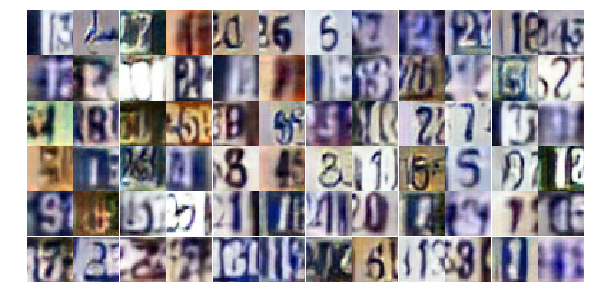

Epoch 16/25... Discriminator Loss: 0.6901... Generator Loss: 0.9769
Epoch 16/25... Discriminator Loss: 0.7319... Generator Loss: 0.9227
Epoch 16/25... Discriminator Loss: 0.8511... Generator Loss: 0.7594
Epoch 16/25... Discriminator Loss: 0.5195... Generator Loss: 1.5610
Epoch 16/25... Discriminator Loss: 0.6128... Generator Loss: 2.1438
Epoch 16/25... Discriminator Loss: 0.5456... Generator Loss: 1.5114
Epoch 16/25... Discriminator Loss: 2.0833... Generator Loss: 0.1957
Epoch 16/25... Discriminator Loss: 0.8649... Generator Loss: 0.8017
Epoch 16/25... Discriminator Loss: 0.4021... Generator Loss: 1.5786
Epoch 16/25... Discriminator Loss: 0.6592... Generator Loss: 1.0512


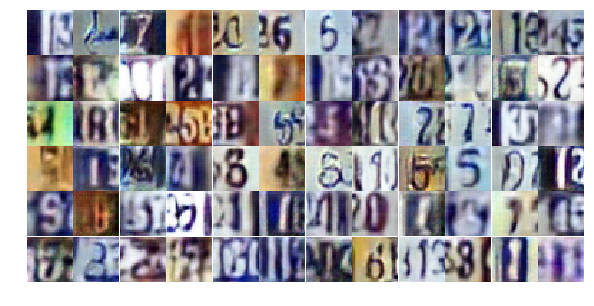

Epoch 16/25... Discriminator Loss: 1.3753... Generator Loss: 0.4196
Epoch 16/25... Discriminator Loss: 0.4161... Generator Loss: 1.5653
Epoch 16/25... Discriminator Loss: 0.8481... Generator Loss: 0.7778
Epoch 16/25... Discriminator Loss: 1.2486... Generator Loss: 0.4645
Epoch 16/25... Discriminator Loss: 3.7012... Generator Loss: 0.0775
Epoch 16/25... Discriminator Loss: 2.1085... Generator Loss: 0.2943
Epoch 16/25... Discriminator Loss: 1.7974... Generator Loss: 0.6379
Epoch 16/25... Discriminator Loss: 1.7046... Generator Loss: 0.5593
Epoch 16/25... Discriminator Loss: 1.4178... Generator Loss: 1.0895
Epoch 16/25... Discriminator Loss: 1.4486... Generator Loss: 0.9157


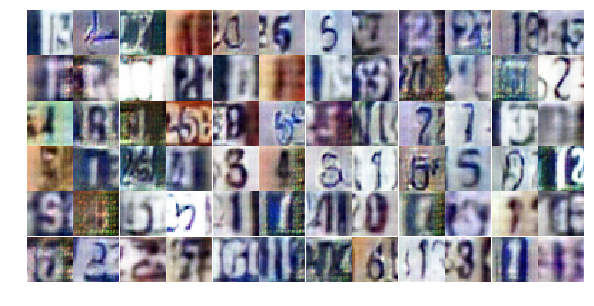

Epoch 16/25... Discriminator Loss: 1.4022... Generator Loss: 0.7084
Epoch 16/25... Discriminator Loss: 1.4477... Generator Loss: 0.9952
Epoch 16/25... Discriminator Loss: 1.4357... Generator Loss: 0.6979
Epoch 16/25... Discriminator Loss: 1.4270... Generator Loss: 0.6382
Epoch 16/25... Discriminator Loss: 1.2471... Generator Loss: 0.7379
Epoch 16/25... Discriminator Loss: 1.5489... Generator Loss: 0.9213
Epoch 16/25... Discriminator Loss: 1.4764... Generator Loss: 0.7248
Epoch 16/25... Discriminator Loss: 1.3069... Generator Loss: 0.8588
Epoch 16/25... Discriminator Loss: 1.5164... Generator Loss: 0.6341
Epoch 16/25... Discriminator Loss: 1.3600... Generator Loss: 0.6992


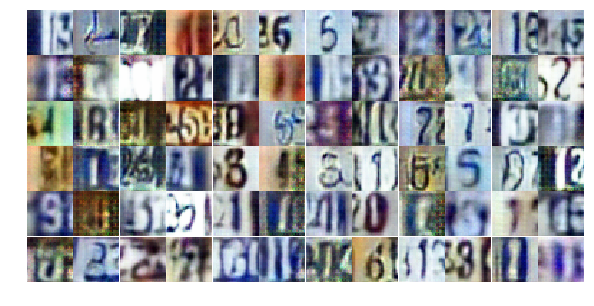

Epoch 16/25... Discriminator Loss: 1.0518... Generator Loss: 1.0161
Epoch 16/25... Discriminator Loss: 1.1844... Generator Loss: 0.8770
Epoch 16/25... Discriminator Loss: 0.9950... Generator Loss: 1.1522
Epoch 16/25... Discriminator Loss: 1.1043... Generator Loss: 2.0226
Epoch 16/25... Discriminator Loss: 1.1568... Generator Loss: 1.9269
Epoch 16/25... Discriminator Loss: 0.8084... Generator Loss: 1.0499
Epoch 16/25... Discriminator Loss: 0.9652... Generator Loss: 0.7770
Epoch 16/25... Discriminator Loss: 1.2882... Generator Loss: 0.4429
Epoch 16/25... Discriminator Loss: 1.0136... Generator Loss: 0.7526
Epoch 16/25... Discriminator Loss: 0.5405... Generator Loss: 1.5945


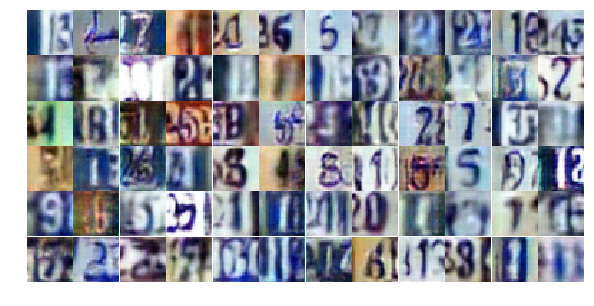

Epoch 16/25... Discriminator Loss: 0.6566... Generator Loss: 1.2806
Epoch 16/25... Discriminator Loss: 0.6955... Generator Loss: 1.1426
Epoch 16/25... Discriminator Loss: 1.6263... Generator Loss: 0.3396
Epoch 16/25... Discriminator Loss: 0.9373... Generator Loss: 0.9301
Epoch 16/25... Discriminator Loss: 1.0008... Generator Loss: 0.9629
Epoch 16/25... Discriminator Loss: 0.8751... Generator Loss: 0.8174
Epoch 16/25... Discriminator Loss: 0.4821... Generator Loss: 1.4501
Epoch 16/25... Discriminator Loss: 0.9604... Generator Loss: 0.7088
Epoch 16/25... Discriminator Loss: 0.5753... Generator Loss: 1.1349
Epoch 16/25... Discriminator Loss: 0.6877... Generator Loss: 0.9259


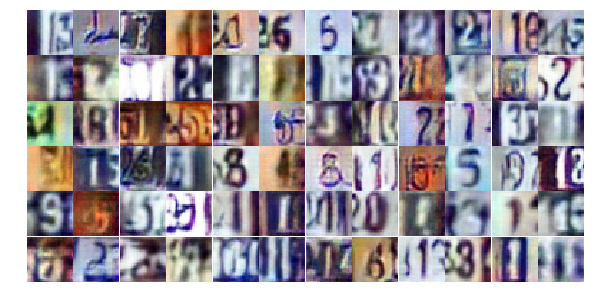

Epoch 16/25... Discriminator Loss: 1.7529... Generator Loss: 0.2856
Epoch 16/25... Discriminator Loss: 0.8524... Generator Loss: 1.8648
Epoch 16/25... Discriminator Loss: 1.2496... Generator Loss: 0.4875
Epoch 16/25... Discriminator Loss: 0.6171... Generator Loss: 1.0331
Epoch 16/25... Discriminator Loss: 0.7961... Generator Loss: 0.8108
Epoch 16/25... Discriminator Loss: 0.5492... Generator Loss: 1.3398
Epoch 17/25... Discriminator Loss: 0.8082... Generator Loss: 0.8211
Epoch 17/25... Discriminator Loss: 0.7082... Generator Loss: 0.9040
Epoch 17/25... Discriminator Loss: 0.8354... Generator Loss: 0.7862
Epoch 17/25... Discriminator Loss: 0.5983... Generator Loss: 1.1767


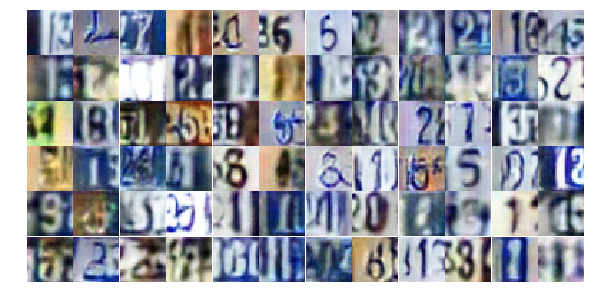

Epoch 17/25... Discriminator Loss: 0.6515... Generator Loss: 1.1861
Epoch 17/25... Discriminator Loss: 0.4528... Generator Loss: 1.3993
Epoch 17/25... Discriminator Loss: 0.9768... Generator Loss: 0.7466
Epoch 17/25... Discriminator Loss: 0.5887... Generator Loss: 1.2114
Epoch 17/25... Discriminator Loss: 1.3528... Generator Loss: 0.4331
Epoch 17/25... Discriminator Loss: 1.4211... Generator Loss: 0.3890
Epoch 17/25... Discriminator Loss: 0.6680... Generator Loss: 1.0469
Epoch 17/25... Discriminator Loss: 0.4639... Generator Loss: 1.4172
Epoch 17/25... Discriminator Loss: 0.5143... Generator Loss: 1.2428
Epoch 17/25... Discriminator Loss: 0.8737... Generator Loss: 2.5502


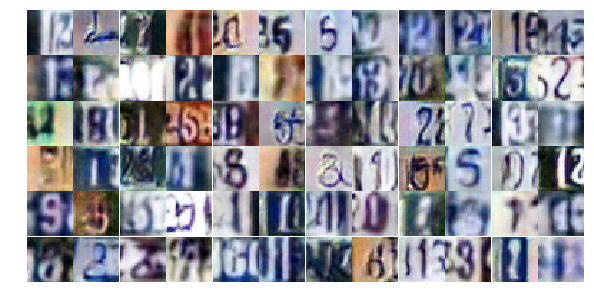

Epoch 17/25... Discriminator Loss: 2.0618... Generator Loss: 2.9175
Epoch 17/25... Discriminator Loss: 0.6796... Generator Loss: 1.1567
Epoch 17/25... Discriminator Loss: 0.7090... Generator Loss: 1.0536
Epoch 17/25... Discriminator Loss: 0.7404... Generator Loss: 1.0528
Epoch 17/25... Discriminator Loss: 0.6115... Generator Loss: 1.1447
Epoch 17/25... Discriminator Loss: 0.6919... Generator Loss: 0.9391
Epoch 17/25... Discriminator Loss: 0.6375... Generator Loss: 1.6913
Epoch 17/25... Discriminator Loss: 0.6518... Generator Loss: 1.0979
Epoch 17/25... Discriminator Loss: 0.7618... Generator Loss: 0.8659
Epoch 17/25... Discriminator Loss: 0.6261... Generator Loss: 1.0290


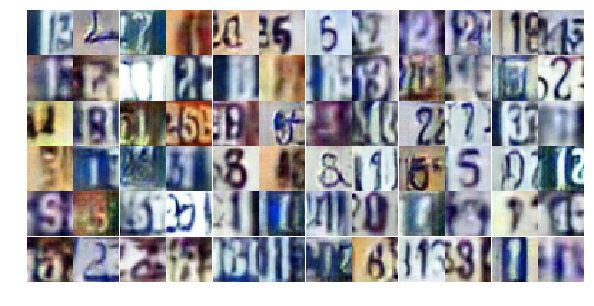

Epoch 17/25... Discriminator Loss: 1.4999... Generator Loss: 0.4104
Epoch 17/25... Discriminator Loss: 0.4578... Generator Loss: 1.7260
Epoch 17/25... Discriminator Loss: 0.4350... Generator Loss: 1.8391
Epoch 17/25... Discriminator Loss: 1.4683... Generator Loss: 0.3614
Epoch 17/25... Discriminator Loss: 1.4936... Generator Loss: 0.3863
Epoch 17/25... Discriminator Loss: 0.4285... Generator Loss: 1.4057
Epoch 17/25... Discriminator Loss: 1.1636... Generator Loss: 0.5256
Epoch 17/25... Discriminator Loss: 0.8148... Generator Loss: 0.8208
Epoch 17/25... Discriminator Loss: 0.6842... Generator Loss: 1.1277
Epoch 17/25... Discriminator Loss: 0.3502... Generator Loss: 2.0191


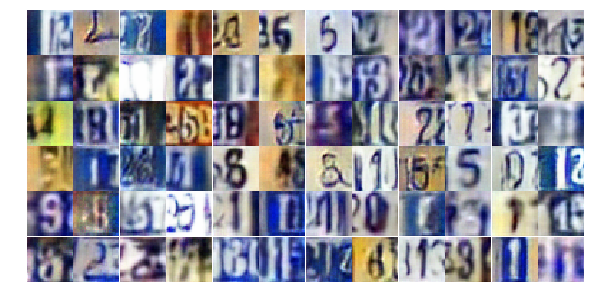

Epoch 17/25... Discriminator Loss: 0.4298... Generator Loss: 1.7034
Epoch 17/25... Discriminator Loss: 1.0802... Generator Loss: 0.6100
Epoch 17/25... Discriminator Loss: 0.6301... Generator Loss: 1.1576
Epoch 17/25... Discriminator Loss: 0.7884... Generator Loss: 0.9988
Epoch 17/25... Discriminator Loss: 0.6984... Generator Loss: 1.0765
Epoch 17/25... Discriminator Loss: 0.5787... Generator Loss: 1.2251
Epoch 17/25... Discriminator Loss: 0.5197... Generator Loss: 1.2504
Epoch 17/25... Discriminator Loss: 0.4830... Generator Loss: 1.4933
Epoch 17/25... Discriminator Loss: 0.3357... Generator Loss: 2.0966
Epoch 17/25... Discriminator Loss: 0.9866... Generator Loss: 0.6279


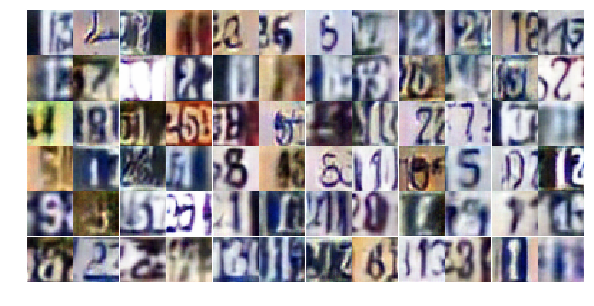

Epoch 17/25... Discriminator Loss: 6.8329... Generator Loss: 0.0101
Epoch 17/25... Discriminator Loss: 0.6194... Generator Loss: 1.9383
Epoch 17/25... Discriminator Loss: 0.7096... Generator Loss: 1.2319
Epoch 17/25... Discriminator Loss: 0.5350... Generator Loss: 1.2672
Epoch 17/25... Discriminator Loss: 0.7963... Generator Loss: 0.9740
Epoch 17/25... Discriminator Loss: 0.8308... Generator Loss: 0.9216
Epoch 17/25... Discriminator Loss: 0.7335... Generator Loss: 0.8948
Epoch 17/25... Discriminator Loss: 0.5606... Generator Loss: 1.1930
Epoch 17/25... Discriminator Loss: 0.5161... Generator Loss: 1.3461
Epoch 17/25... Discriminator Loss: 1.1075... Generator Loss: 0.5612


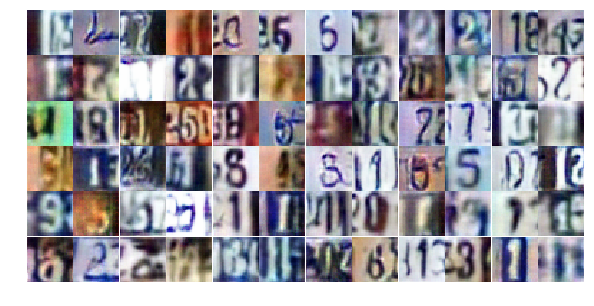

Epoch 17/25... Discriminator Loss: 0.7809... Generator Loss: 1.8477
Epoch 17/25... Discriminator Loss: 0.8007... Generator Loss: 1.3529
Epoch 17/25... Discriminator Loss: 0.8302... Generator Loss: 1.0799
Epoch 17/25... Discriminator Loss: 0.5884... Generator Loss: 1.6392
Epoch 18/25... Discriminator Loss: 0.7361... Generator Loss: 0.9343
Epoch 18/25... Discriminator Loss: 0.6466... Generator Loss: 1.0352
Epoch 18/25... Discriminator Loss: 0.6392... Generator Loss: 1.0561
Epoch 18/25... Discriminator Loss: 1.0552... Generator Loss: 0.6308
Epoch 18/25... Discriminator Loss: 0.8068... Generator Loss: 1.3846
Epoch 18/25... Discriminator Loss: 1.2571... Generator Loss: 0.4976


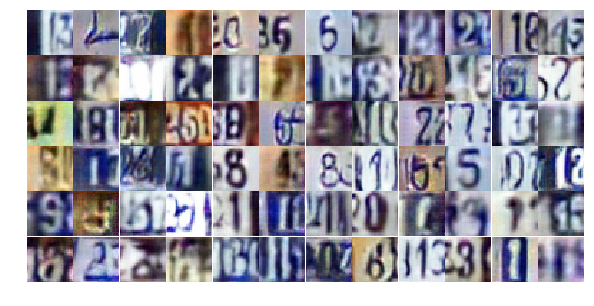

Epoch 18/25... Discriminator Loss: 0.3730... Generator Loss: 1.6078
Epoch 18/25... Discriminator Loss: 1.4272... Generator Loss: 0.4009
Epoch 18/25... Discriminator Loss: 0.9978... Generator Loss: 0.6445
Epoch 18/25... Discriminator Loss: 0.3962... Generator Loss: 1.8705
Epoch 18/25... Discriminator Loss: 0.5587... Generator Loss: 1.3040
Epoch 18/25... Discriminator Loss: 0.7759... Generator Loss: 1.1631
Epoch 18/25... Discriminator Loss: 0.4996... Generator Loss: 1.3846
Epoch 18/25... Discriminator Loss: 0.9572... Generator Loss: 0.7402
Epoch 18/25... Discriminator Loss: 0.8312... Generator Loss: 2.3239
Epoch 18/25... Discriminator Loss: 0.4121... Generator Loss: 1.6404


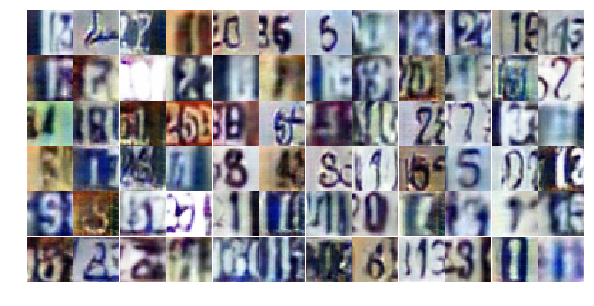

Epoch 18/25... Discriminator Loss: 0.6493... Generator Loss: 2.0946
Epoch 18/25... Discriminator Loss: 0.7361... Generator Loss: 0.9514
Epoch 18/25... Discriminator Loss: 1.1916... Generator Loss: 0.6140
Epoch 18/25... Discriminator Loss: 0.4759... Generator Loss: 1.3642
Epoch 18/25... Discriminator Loss: 0.7496... Generator Loss: 0.8981
Epoch 18/25... Discriminator Loss: 0.8791... Generator Loss: 0.7559
Epoch 18/25... Discriminator Loss: 1.0137... Generator Loss: 0.6673
Epoch 18/25... Discriminator Loss: 1.1002... Generator Loss: 0.6516
Epoch 18/25... Discriminator Loss: 0.9274... Generator Loss: 0.7865
Epoch 18/25... Discriminator Loss: 0.5792... Generator Loss: 1.1172


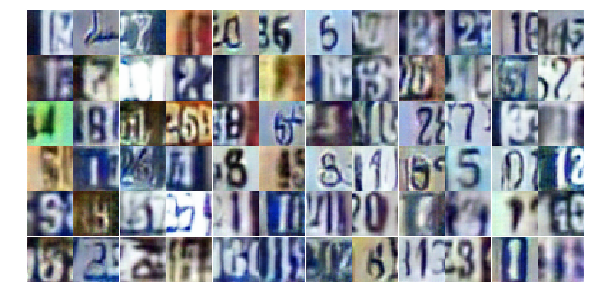

Epoch 18/25... Discriminator Loss: 0.6057... Generator Loss: 1.1891
Epoch 18/25... Discriminator Loss: 0.7371... Generator Loss: 1.9201
Epoch 18/25... Discriminator Loss: 0.9124... Generator Loss: 0.7764
Epoch 18/25... Discriminator Loss: 0.7583... Generator Loss: 1.0252
Epoch 18/25... Discriminator Loss: 0.7873... Generator Loss: 0.8757
Epoch 18/25... Discriminator Loss: 0.6187... Generator Loss: 1.1317
Epoch 18/25... Discriminator Loss: 0.6519... Generator Loss: 1.0517
Epoch 18/25... Discriminator Loss: 0.5521... Generator Loss: 1.4080
Epoch 18/25... Discriminator Loss: 0.5583... Generator Loss: 1.2834
Epoch 18/25... Discriminator Loss: 0.6556... Generator Loss: 1.2020


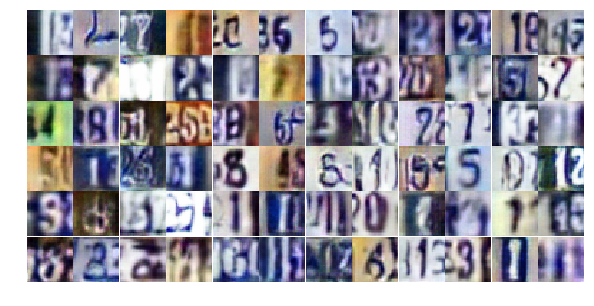

Epoch 18/25... Discriminator Loss: 0.6093... Generator Loss: 1.1445
Epoch 18/25... Discriminator Loss: 0.8417... Generator Loss: 0.8011
Epoch 18/25... Discriminator Loss: 0.6394... Generator Loss: 1.2882
Epoch 18/25... Discriminator Loss: 0.6475... Generator Loss: 1.1091
Epoch 18/25... Discriminator Loss: 0.6561... Generator Loss: 1.2184
Epoch 18/25... Discriminator Loss: 0.3908... Generator Loss: 1.4977
Epoch 18/25... Discriminator Loss: 1.1725... Generator Loss: 0.5454
Epoch 18/25... Discriminator Loss: 1.7464... Generator Loss: 3.0524
Epoch 18/25... Discriminator Loss: 1.2490... Generator Loss: 0.5352
Epoch 18/25... Discriminator Loss: 0.4991... Generator Loss: 1.4676


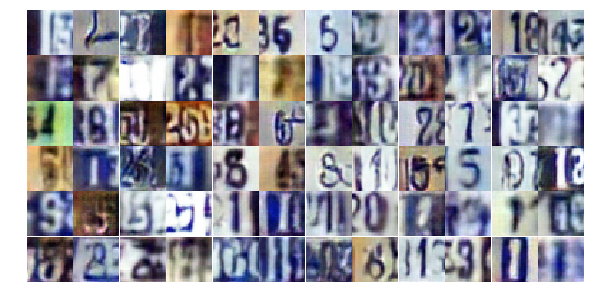

Epoch 18/25... Discriminator Loss: 0.5430... Generator Loss: 1.2073
Epoch 18/25... Discriminator Loss: 0.7317... Generator Loss: 0.9642
Epoch 18/25... Discriminator Loss: 1.0249... Generator Loss: 0.5962
Epoch 18/25... Discriminator Loss: 1.0107... Generator Loss: 0.6260
Epoch 18/25... Discriminator Loss: 0.4998... Generator Loss: 1.2726
Epoch 18/25... Discriminator Loss: 0.7115... Generator Loss: 0.9589
Epoch 18/25... Discriminator Loss: 0.4490... Generator Loss: 1.6105
Epoch 18/25... Discriminator Loss: 0.5813... Generator Loss: 2.1290
Epoch 18/25... Discriminator Loss: 0.9685... Generator Loss: 0.6998
Epoch 18/25... Discriminator Loss: 1.0449... Generator Loss: 0.6238


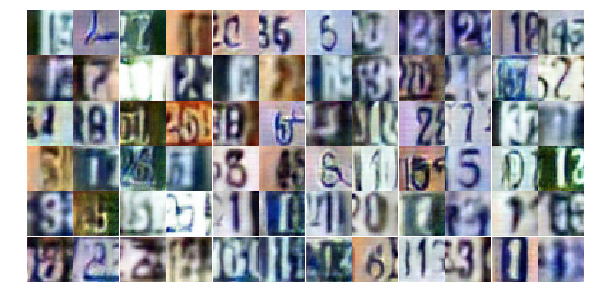

Epoch 18/25... Discriminator Loss: 0.6049... Generator Loss: 2.0486
Epoch 19/25... Discriminator Loss: 1.0149... Generator Loss: 0.6607
Epoch 19/25... Discriminator Loss: 1.2187... Generator Loss: 0.5430
Epoch 19/25... Discriminator Loss: 0.6649... Generator Loss: 1.5498
Epoch 19/25... Discriminator Loss: 0.6764... Generator Loss: 1.0386
Epoch 19/25... Discriminator Loss: 1.0028... Generator Loss: 0.6827
Epoch 19/25... Discriminator Loss: 0.4668... Generator Loss: 1.4672
Epoch 19/25... Discriminator Loss: 0.8418... Generator Loss: 0.8585
Epoch 19/25... Discriminator Loss: 0.5589... Generator Loss: 1.9225
Epoch 19/25... Discriminator Loss: 0.9389... Generator Loss: 0.6973


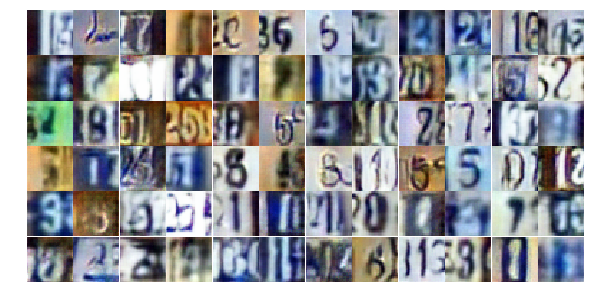

Epoch 19/25... Discriminator Loss: 0.7669... Generator Loss: 0.8966
Epoch 19/25... Discriminator Loss: 0.8960... Generator Loss: 0.7549
Epoch 19/25... Discriminator Loss: 0.8736... Generator Loss: 0.7443
Epoch 19/25... Discriminator Loss: 1.6538... Generator Loss: 3.2714
Epoch 19/25... Discriminator Loss: 1.3985... Generator Loss: 0.4718
Epoch 19/25... Discriminator Loss: 0.6401... Generator Loss: 1.3092
Epoch 19/25... Discriminator Loss: 1.0315... Generator Loss: 0.6053
Epoch 19/25... Discriminator Loss: 0.8319... Generator Loss: 0.9178
Epoch 19/25... Discriminator Loss: 0.9703... Generator Loss: 1.1545
Epoch 19/25... Discriminator Loss: 1.5642... Generator Loss: 0.3525


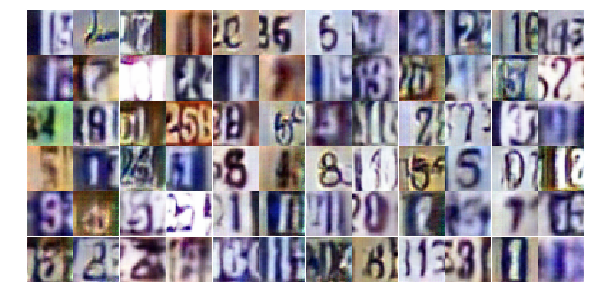

Epoch 19/25... Discriminator Loss: 0.9104... Generator Loss: 0.7845
Epoch 19/25... Discriminator Loss: 1.1282... Generator Loss: 0.5876
Epoch 19/25... Discriminator Loss: 1.4524... Generator Loss: 0.3989
Epoch 19/25... Discriminator Loss: 0.9911... Generator Loss: 0.9494
Epoch 19/25... Discriminator Loss: 1.1187... Generator Loss: 0.5616
Epoch 19/25... Discriminator Loss: 0.8196... Generator Loss: 0.8620
Epoch 19/25... Discriminator Loss: 0.6300... Generator Loss: 1.1275
Epoch 19/25... Discriminator Loss: 0.6868... Generator Loss: 1.0522
Epoch 19/25... Discriminator Loss: 0.5037... Generator Loss: 1.7682
Epoch 19/25... Discriminator Loss: 0.8408... Generator Loss: 0.8930


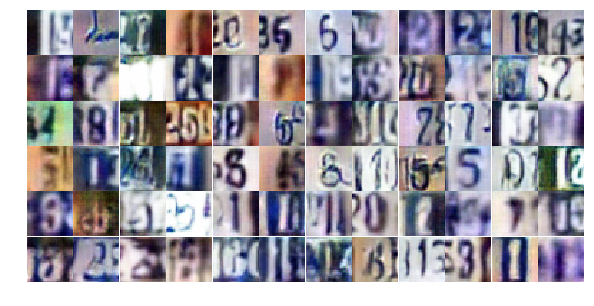

Epoch 19/25... Discriminator Loss: 0.9910... Generator Loss: 0.6435
Epoch 19/25... Discriminator Loss: 0.6822... Generator Loss: 0.9527
Epoch 19/25... Discriminator Loss: 1.0444... Generator Loss: 0.6031
Epoch 19/25... Discriminator Loss: 0.6935... Generator Loss: 0.9248
Epoch 19/25... Discriminator Loss: 0.8942... Generator Loss: 0.7030
Epoch 19/25... Discriminator Loss: 1.1124... Generator Loss: 0.6454
Epoch 19/25... Discriminator Loss: 0.6031... Generator Loss: 1.3496
Epoch 19/25... Discriminator Loss: 0.5253... Generator Loss: 1.2740
Epoch 19/25... Discriminator Loss: 0.9425... Generator Loss: 0.7163
Epoch 19/25... Discriminator Loss: 0.6997... Generator Loss: 0.9566


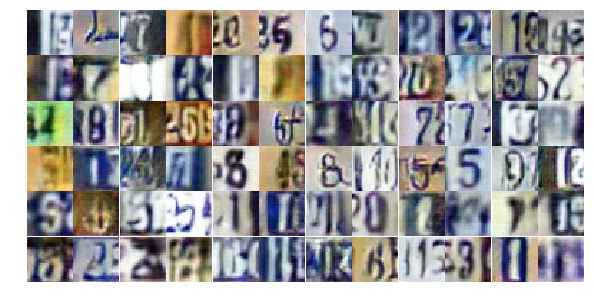

Epoch 19/25... Discriminator Loss: 0.6972... Generator Loss: 0.9167
Epoch 19/25... Discriminator Loss: 1.0851... Generator Loss: 0.6111
Epoch 19/25... Discriminator Loss: 0.9233... Generator Loss: 0.6933
Epoch 19/25... Discriminator Loss: 0.6413... Generator Loss: 1.0791
Epoch 19/25... Discriminator Loss: 0.6766... Generator Loss: 1.1485
Epoch 19/25... Discriminator Loss: 1.1589... Generator Loss: 3.8378
Epoch 19/25... Discriminator Loss: 0.7964... Generator Loss: 0.9329
Epoch 19/25... Discriminator Loss: 0.6652... Generator Loss: 1.0163
Epoch 19/25... Discriminator Loss: 0.5446... Generator Loss: 1.4423
Epoch 19/25... Discriminator Loss: 0.9273... Generator Loss: 0.8922


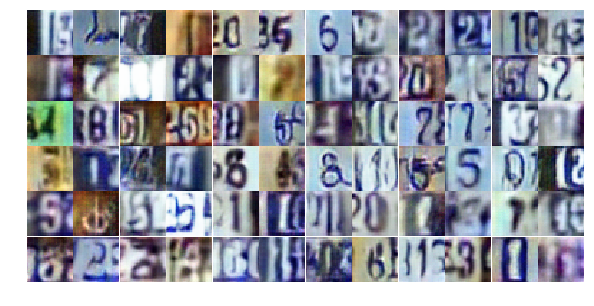

Epoch 19/25... Discriminator Loss: 0.7767... Generator Loss: 0.8518
Epoch 19/25... Discriminator Loss: 1.0217... Generator Loss: 0.6807
Epoch 19/25... Discriminator Loss: 0.7923... Generator Loss: 2.7738
Epoch 19/25... Discriminator Loss: 2.6195... Generator Loss: 1.2785
Epoch 19/25... Discriminator Loss: 1.0294... Generator Loss: 2.6025
Epoch 19/25... Discriminator Loss: 0.9233... Generator Loss: 1.0653
Epoch 19/25... Discriminator Loss: 1.0052... Generator Loss: 0.6601
Epoch 19/25... Discriminator Loss: 0.5625... Generator Loss: 1.3566
Epoch 20/25... Discriminator Loss: 0.8388... Generator Loss: 0.8178
Epoch 20/25... Discriminator Loss: 0.7983... Generator Loss: 0.8931


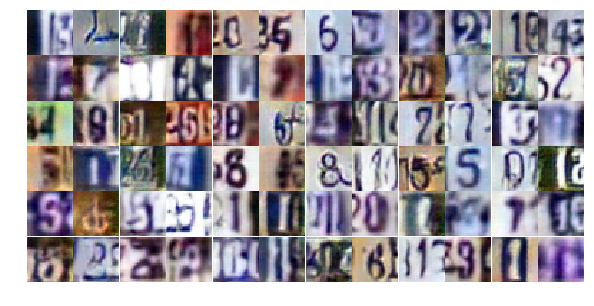

Epoch 20/25... Discriminator Loss: 0.7168... Generator Loss: 0.9168
Epoch 20/25... Discriminator Loss: 0.8745... Generator Loss: 0.8209
Epoch 20/25... Discriminator Loss: 1.0985... Generator Loss: 0.5797
Epoch 20/25... Discriminator Loss: 0.8287... Generator Loss: 0.8097
Epoch 20/25... Discriminator Loss: 0.5256... Generator Loss: 1.3070
Epoch 20/25... Discriminator Loss: 0.8348... Generator Loss: 0.7977
Epoch 20/25... Discriminator Loss: 0.5995... Generator Loss: 1.2972
Epoch 20/25... Discriminator Loss: 0.6356... Generator Loss: 1.0987
Epoch 20/25... Discriminator Loss: 0.7706... Generator Loss: 1.0055
Epoch 20/25... Discriminator Loss: 0.7618... Generator Loss: 0.8615


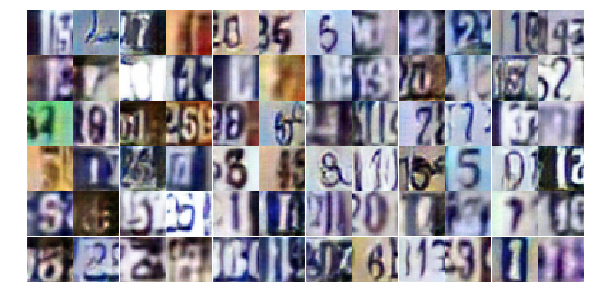

Epoch 20/25... Discriminator Loss: 1.7572... Generator Loss: 0.3270
Epoch 20/25... Discriminator Loss: 0.9420... Generator Loss: 0.7312
Epoch 20/25... Discriminator Loss: 0.6773... Generator Loss: 1.0463
Epoch 20/25... Discriminator Loss: 0.6471... Generator Loss: 1.1249
Epoch 20/25... Discriminator Loss: 0.9879... Generator Loss: 0.6877
Epoch 20/25... Discriminator Loss: 0.7655... Generator Loss: 1.2735
Epoch 20/25... Discriminator Loss: 2.0134... Generator Loss: 0.2063
Epoch 20/25... Discriminator Loss: 0.9024... Generator Loss: 0.7695
Epoch 20/25... Discriminator Loss: 0.8127... Generator Loss: 0.7769
Epoch 20/25... Discriminator Loss: 1.0029... Generator Loss: 0.7166


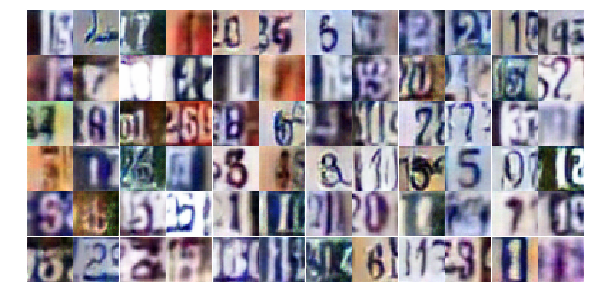

Epoch 20/25... Discriminator Loss: 0.7545... Generator Loss: 0.8541
Epoch 20/25... Discriminator Loss: 0.6930... Generator Loss: 0.9498
Epoch 20/25... Discriminator Loss: 0.3035... Generator Loss: 1.8454
Epoch 20/25... Discriminator Loss: 1.7156... Generator Loss: 0.2992
Epoch 20/25... Discriminator Loss: 0.5989... Generator Loss: 1.4884
Epoch 20/25... Discriminator Loss: 0.7465... Generator Loss: 0.9534
Epoch 20/25... Discriminator Loss: 0.7086... Generator Loss: 2.9862
Epoch 20/25... Discriminator Loss: 1.4373... Generator Loss: 0.3733
Epoch 20/25... Discriminator Loss: 1.0127... Generator Loss: 0.6366
Epoch 20/25... Discriminator Loss: 0.4568... Generator Loss: 1.3636


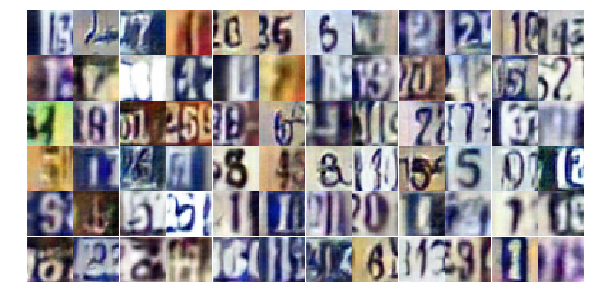

Epoch 20/25... Discriminator Loss: 0.9752... Generator Loss: 0.6974
Epoch 20/25... Discriminator Loss: 0.4534... Generator Loss: 1.4000
Epoch 20/25... Discriminator Loss: 1.2310... Generator Loss: 0.5528
Epoch 20/25... Discriminator Loss: 0.7817... Generator Loss: 0.8955
Epoch 20/25... Discriminator Loss: 0.6161... Generator Loss: 1.3693
Epoch 20/25... Discriminator Loss: 0.7311... Generator Loss: 1.0116
Epoch 20/25... Discriminator Loss: 0.8743... Generator Loss: 1.0460
Epoch 20/25... Discriminator Loss: 0.8184... Generator Loss: 0.7703
Epoch 20/25... Discriminator Loss: 0.7798... Generator Loss: 0.8958
Epoch 20/25... Discriminator Loss: 0.9150... Generator Loss: 0.7776


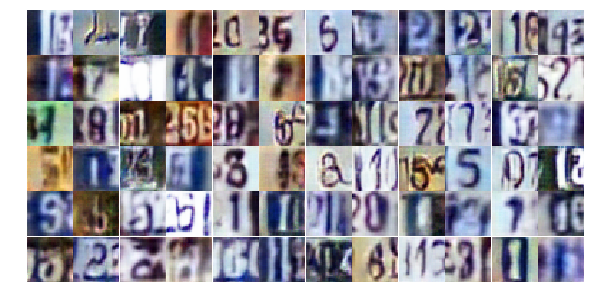

Epoch 20/25... Discriminator Loss: 0.5640... Generator Loss: 1.2681
Epoch 20/25... Discriminator Loss: 0.6114... Generator Loss: 1.1204
Epoch 20/25... Discriminator Loss: 2.2749... Generator Loss: 0.1826
Epoch 20/25... Discriminator Loss: 1.1481... Generator Loss: 0.6108
Epoch 20/25... Discriminator Loss: 1.6587... Generator Loss: 0.3104
Epoch 20/25... Discriminator Loss: 1.0006... Generator Loss: 0.7395
Epoch 20/25... Discriminator Loss: 1.1204... Generator Loss: 0.5925
Epoch 20/25... Discriminator Loss: 0.4849... Generator Loss: 1.4060
Epoch 20/25... Discriminator Loss: 0.6998... Generator Loss: 0.9942
Epoch 20/25... Discriminator Loss: 0.6031... Generator Loss: 1.1096


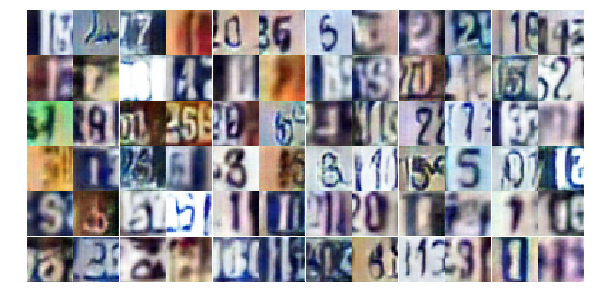

Epoch 20/25... Discriminator Loss: 0.5607... Generator Loss: 1.2728
Epoch 20/25... Discriminator Loss: 0.6859... Generator Loss: 1.2741
Epoch 20/25... Discriminator Loss: 0.5690... Generator Loss: 1.7338
Epoch 20/25... Discriminator Loss: 0.9572... Generator Loss: 0.7817
Epoch 20/25... Discriminator Loss: 0.6534... Generator Loss: 1.0131
Epoch 20/25... Discriminator Loss: 0.5172... Generator Loss: 1.1974
Epoch 21/25... Discriminator Loss: 1.1217... Generator Loss: 0.5583
Epoch 21/25... Discriminator Loss: 0.7520... Generator Loss: 0.8769
Epoch 21/25... Discriminator Loss: 1.1516... Generator Loss: 0.5415
Epoch 21/25... Discriminator Loss: 1.1639... Generator Loss: 0.5275


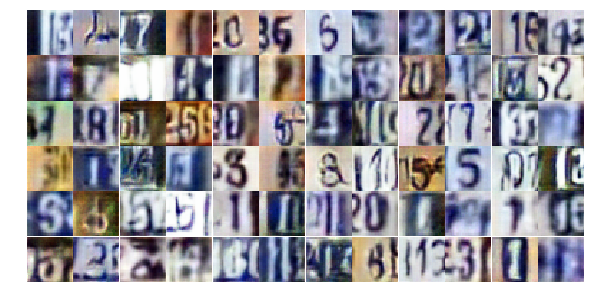

Epoch 21/25... Discriminator Loss: 0.7799... Generator Loss: 0.8674
Epoch 21/25... Discriminator Loss: 1.5543... Generator Loss: 0.3506
Epoch 21/25... Discriminator Loss: 0.4523... Generator Loss: 1.6711
Epoch 21/25... Discriminator Loss: 0.4176... Generator Loss: 1.3409
Epoch 21/25... Discriminator Loss: 0.7297... Generator Loss: 0.9346
Epoch 21/25... Discriminator Loss: 0.4336... Generator Loss: 1.4555
Epoch 21/25... Discriminator Loss: 0.9543... Generator Loss: 0.6793
Epoch 21/25... Discriminator Loss: 0.8165... Generator Loss: 1.1371
Epoch 21/25... Discriminator Loss: 0.8274... Generator Loss: 0.8521
Epoch 21/25... Discriminator Loss: 0.6232... Generator Loss: 1.1260


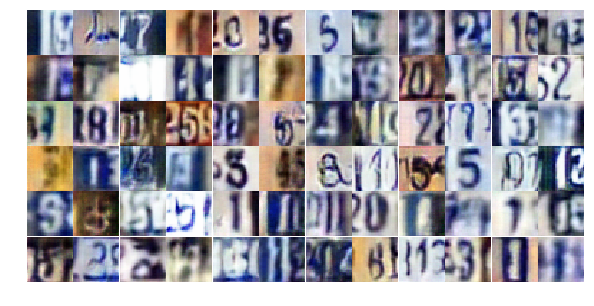

Epoch 21/25... Discriminator Loss: 0.3253... Generator Loss: 1.7046
Epoch 21/25... Discriminator Loss: 1.0640... Generator Loss: 0.5861
Epoch 21/25... Discriminator Loss: 1.9260... Generator Loss: 0.2627
Epoch 21/25... Discriminator Loss: 0.8013... Generator Loss: 1.8001
Epoch 21/25... Discriminator Loss: 0.6567... Generator Loss: 1.7042
Epoch 21/25... Discriminator Loss: 1.1380... Generator Loss: 0.5519
Epoch 21/25... Discriminator Loss: 1.2463... Generator Loss: 0.4754
Epoch 21/25... Discriminator Loss: 0.4947... Generator Loss: 2.3156
Epoch 21/25... Discriminator Loss: 0.4961... Generator Loss: 2.5036
Epoch 21/25... Discriminator Loss: 1.2106... Generator Loss: 0.4899


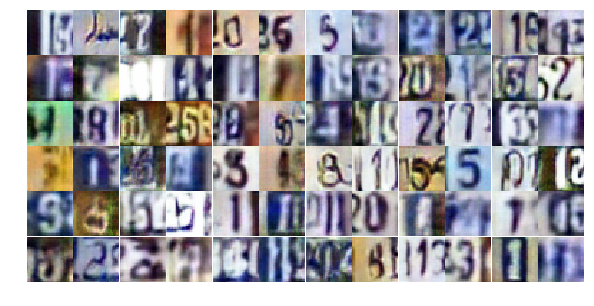

Epoch 21/25... Discriminator Loss: 1.1483... Generator Loss: 0.5523
Epoch 21/25... Discriminator Loss: 0.4273... Generator Loss: 1.5442
Epoch 21/25... Discriminator Loss: 1.2772... Generator Loss: 0.4921
Epoch 21/25... Discriminator Loss: 0.7319... Generator Loss: 1.5776
Epoch 21/25... Discriminator Loss: 0.8178... Generator Loss: 0.8138
Epoch 21/25... Discriminator Loss: 1.3037... Generator Loss: 0.4373
Epoch 21/25... Discriminator Loss: 0.4394... Generator Loss: 1.5057
Epoch 21/25... Discriminator Loss: 0.7806... Generator Loss: 0.9588
Epoch 21/25... Discriminator Loss: 1.3071... Generator Loss: 0.4723
Epoch 21/25... Discriminator Loss: 1.5374... Generator Loss: 0.4211


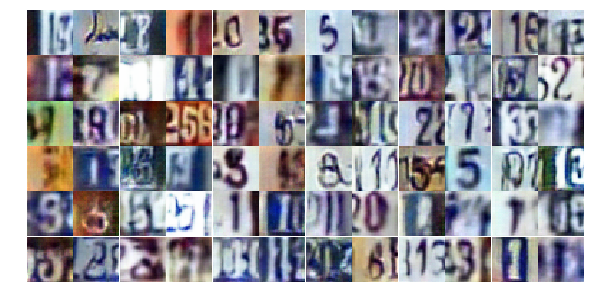

Epoch 21/25... Discriminator Loss: 0.8265... Generator Loss: 0.8813
Epoch 21/25... Discriminator Loss: 0.6378... Generator Loss: 1.1024
Epoch 21/25... Discriminator Loss: 0.8618... Generator Loss: 0.7716
Epoch 21/25... Discriminator Loss: 0.5321... Generator Loss: 1.3150
Epoch 21/25... Discriminator Loss: 0.6548... Generator Loss: 0.9396
Epoch 21/25... Discriminator Loss: 0.6473... Generator Loss: 1.1577
Epoch 21/25... Discriminator Loss: 0.9420... Generator Loss: 0.7370
Epoch 21/25... Discriminator Loss: 1.4231... Generator Loss: 0.3927
Epoch 21/25... Discriminator Loss: 0.9751... Generator Loss: 0.6859
Epoch 21/25... Discriminator Loss: 0.3467... Generator Loss: 2.3840


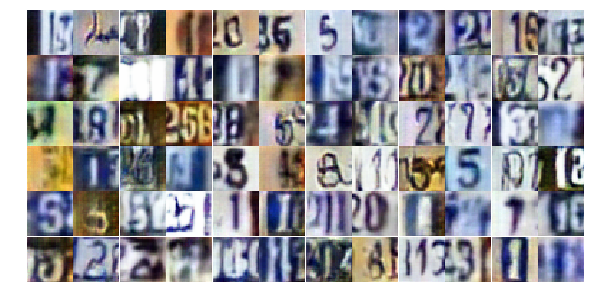

Epoch 21/25... Discriminator Loss: 1.0811... Generator Loss: 3.2766
Epoch 21/25... Discriminator Loss: 2.0776... Generator Loss: 0.2474
Epoch 21/25... Discriminator Loss: 0.5237... Generator Loss: 1.5035
Epoch 21/25... Discriminator Loss: 1.2244... Generator Loss: 0.5195
Epoch 21/25... Discriminator Loss: 0.4863... Generator Loss: 1.3667
Epoch 21/25... Discriminator Loss: 0.7270... Generator Loss: 1.0460
Epoch 21/25... Discriminator Loss: 1.1888... Generator Loss: 0.4930
Epoch 21/25... Discriminator Loss: 0.9570... Generator Loss: 0.8998
Epoch 21/25... Discriminator Loss: 0.7725... Generator Loss: 0.8331
Epoch 21/25... Discriminator Loss: 0.5079... Generator Loss: 1.3213


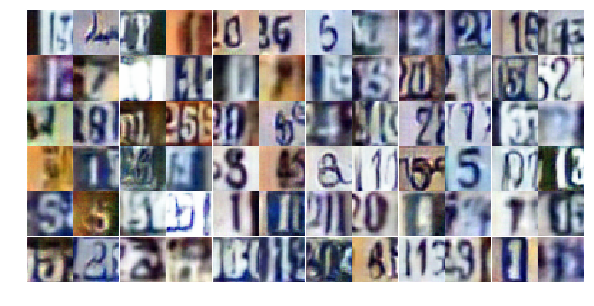

Epoch 21/25... Discriminator Loss: 0.7763... Generator Loss: 0.8789
Epoch 21/25... Discriminator Loss: 0.7302... Generator Loss: 0.9934
Epoch 21/25... Discriminator Loss: 0.5627... Generator Loss: 1.2925
Epoch 22/25... Discriminator Loss: 0.6712... Generator Loss: 1.1184
Epoch 22/25... Discriminator Loss: 0.7912... Generator Loss: 1.6085
Epoch 22/25... Discriminator Loss: 0.8240... Generator Loss: 0.8831
Epoch 22/25... Discriminator Loss: 0.5430... Generator Loss: 1.1688
Epoch 22/25... Discriminator Loss: 0.4534... Generator Loss: 1.3250
Epoch 22/25... Discriminator Loss: 1.3441... Generator Loss: 0.4773
Epoch 22/25... Discriminator Loss: 0.8446... Generator Loss: 0.8627


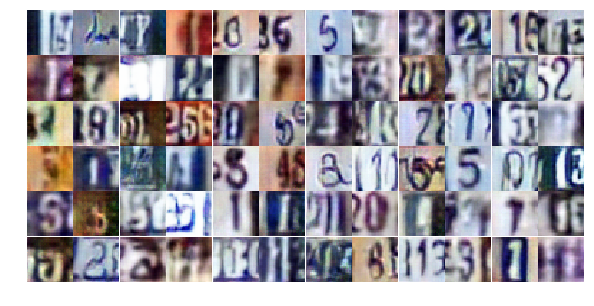

Epoch 22/25... Discriminator Loss: 0.5312... Generator Loss: 1.8323
Epoch 22/25... Discriminator Loss: 0.7900... Generator Loss: 0.9172
Epoch 22/25... Discriminator Loss: 1.2579... Generator Loss: 0.5107
Epoch 22/25... Discriminator Loss: 0.6946... Generator Loss: 0.9510
Epoch 22/25... Discriminator Loss: 0.7149... Generator Loss: 1.0765
Epoch 22/25... Discriminator Loss: 0.8168... Generator Loss: 0.9124
Epoch 22/25... Discriminator Loss: 0.9208... Generator Loss: 0.7661
Epoch 22/25... Discriminator Loss: 0.5239... Generator Loss: 1.4372
Epoch 22/25... Discriminator Loss: 1.1647... Generator Loss: 0.5618
Epoch 22/25... Discriminator Loss: 1.8176... Generator Loss: 0.2874


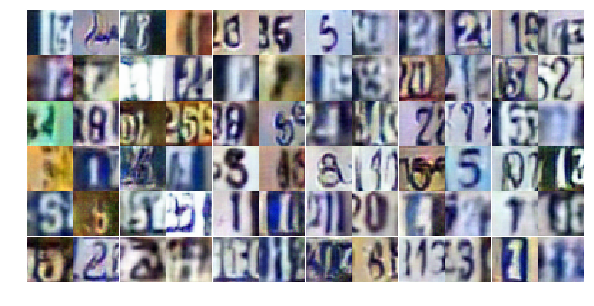

Epoch 22/25... Discriminator Loss: 0.7732... Generator Loss: 2.0919
Epoch 22/25... Discriminator Loss: 0.8427... Generator Loss: 0.7748
Epoch 22/25... Discriminator Loss: 0.9708... Generator Loss: 0.7030
Epoch 22/25... Discriminator Loss: 0.6594... Generator Loss: 0.9604
Epoch 22/25... Discriminator Loss: 0.6574... Generator Loss: 0.9931
Epoch 22/25... Discriminator Loss: 1.2906... Generator Loss: 0.4639
Epoch 22/25... Discriminator Loss: 0.4804... Generator Loss: 1.2326
Epoch 22/25... Discriminator Loss: 0.2941... Generator Loss: 1.8202
Epoch 22/25... Discriminator Loss: 0.8067... Generator Loss: 0.7725
Epoch 22/25... Discriminator Loss: 0.6775... Generator Loss: 1.0107


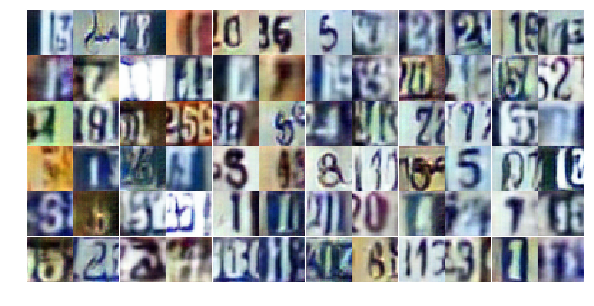

Epoch 22/25... Discriminator Loss: 0.4431... Generator Loss: 1.3351
Epoch 22/25... Discriminator Loss: 0.7728... Generator Loss: 1.0058
Epoch 22/25... Discriminator Loss: 0.8486... Generator Loss: 0.9089
Epoch 22/25... Discriminator Loss: 0.9691... Generator Loss: 0.6464
Epoch 22/25... Discriminator Loss: 0.8527... Generator Loss: 0.8228
Epoch 22/25... Discriminator Loss: 0.7796... Generator Loss: 0.9183
Epoch 22/25... Discriminator Loss: 1.8820... Generator Loss: 0.2655
Epoch 22/25... Discriminator Loss: 0.4383... Generator Loss: 1.9227
Epoch 22/25... Discriminator Loss: 1.5280... Generator Loss: 0.3738
Epoch 22/25... Discriminator Loss: 1.4131... Generator Loss: 0.4826


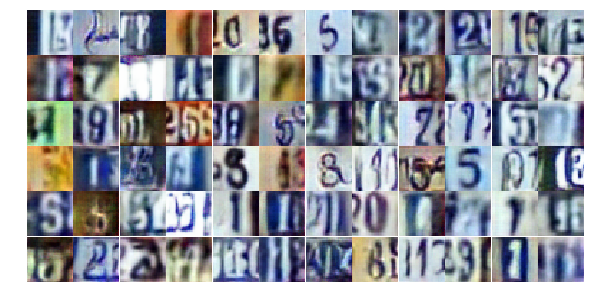

Epoch 22/25... Discriminator Loss: 0.7456... Generator Loss: 0.9901
Epoch 22/25... Discriminator Loss: 0.4640... Generator Loss: 1.5231
Epoch 22/25... Discriminator Loss: 0.2993... Generator Loss: 1.7590
Epoch 22/25... Discriminator Loss: 0.6866... Generator Loss: 1.0021
Epoch 22/25... Discriminator Loss: 0.5617... Generator Loss: 1.1143
Epoch 22/25... Discriminator Loss: 0.5582... Generator Loss: 1.1900
Epoch 22/25... Discriminator Loss: 1.0492... Generator Loss: 0.6419
Epoch 22/25... Discriminator Loss: 1.2043... Generator Loss: 0.7397
Epoch 22/25... Discriminator Loss: 1.1383... Generator Loss: 0.5900
Epoch 22/25... Discriminator Loss: 0.8955... Generator Loss: 0.7756


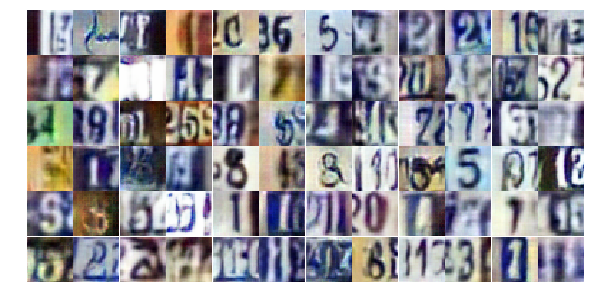

Epoch 22/25... Discriminator Loss: 1.0669... Generator Loss: 0.6023
Epoch 22/25... Discriminator Loss: 0.4436... Generator Loss: 1.5420
Epoch 22/25... Discriminator Loss: 0.7389... Generator Loss: 0.9179
Epoch 22/25... Discriminator Loss: 1.0927... Generator Loss: 0.6239
Epoch 22/25... Discriminator Loss: 0.7649... Generator Loss: 1.0244
Epoch 22/25... Discriminator Loss: 0.5869... Generator Loss: 1.7768
Epoch 22/25... Discriminator Loss: 1.4676... Generator Loss: 0.3786
Epoch 22/25... Discriminator Loss: 0.6842... Generator Loss: 1.0134
Epoch 22/25... Discriminator Loss: 1.0357... Generator Loss: 1.7486
Epoch 22/25... Discriminator Loss: 1.1308... Generator Loss: 0.6452


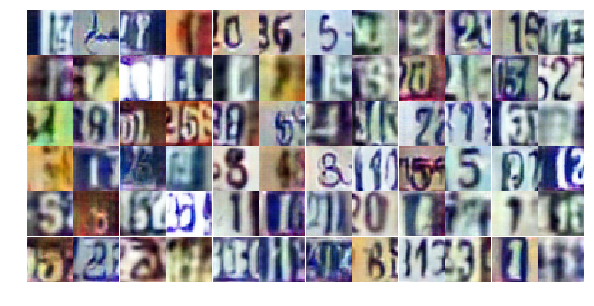

Epoch 23/25... Discriminator Loss: 0.4587... Generator Loss: 1.3616
Epoch 23/25... Discriminator Loss: 0.3130... Generator Loss: 1.8630
Epoch 23/25... Discriminator Loss: 1.2094... Generator Loss: 0.5160
Epoch 23/25... Discriminator Loss: 0.4489... Generator Loss: 1.6026
Epoch 23/25... Discriminator Loss: 0.7163... Generator Loss: 1.1095
Epoch 23/25... Discriminator Loss: 0.9592... Generator Loss: 0.7766
Epoch 23/25... Discriminator Loss: 1.4317... Generator Loss: 0.7440
Epoch 23/25... Discriminator Loss: 2.5486... Generator Loss: 0.2746
Epoch 23/25... Discriminator Loss: 1.2932... Generator Loss: 0.6798
Epoch 23/25... Discriminator Loss: 0.5670... Generator Loss: 1.6528


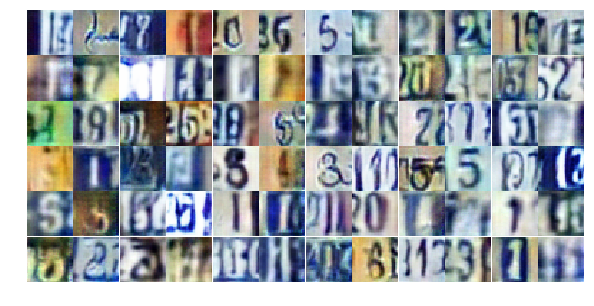

Epoch 23/25... Discriminator Loss: 0.6197... Generator Loss: 1.2702
Epoch 23/25... Discriminator Loss: 1.0771... Generator Loss: 0.6627
Epoch 23/25... Discriminator Loss: 0.6492... Generator Loss: 1.2270
Epoch 23/25... Discriminator Loss: 0.7139... Generator Loss: 1.1210
Epoch 23/25... Discriminator Loss: 0.5286... Generator Loss: 1.4266
Epoch 23/25... Discriminator Loss: 0.8526... Generator Loss: 0.8580
Epoch 23/25... Discriminator Loss: 0.9422... Generator Loss: 0.7367
Epoch 23/25... Discriminator Loss: 0.8618... Generator Loss: 0.8259
Epoch 23/25... Discriminator Loss: 0.9079... Generator Loss: 0.7236
Epoch 23/25... Discriminator Loss: 0.9263... Generator Loss: 0.7067


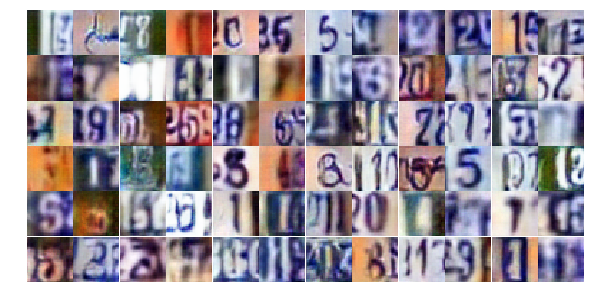

Epoch 23/25... Discriminator Loss: 1.5959... Generator Loss: 0.3510
Epoch 23/25... Discriminator Loss: 0.7559... Generator Loss: 0.9627
Epoch 23/25... Discriminator Loss: 1.3500... Generator Loss: 0.4616
Epoch 23/25... Discriminator Loss: 0.7900... Generator Loss: 0.9338
Epoch 23/25... Discriminator Loss: 0.7466... Generator Loss: 0.9727
Epoch 23/25... Discriminator Loss: 0.8344... Generator Loss: 0.7963
Epoch 23/25... Discriminator Loss: 0.8916... Generator Loss: 0.7174
Epoch 23/25... Discriminator Loss: 1.2938... Generator Loss: 0.4524
Epoch 23/25... Discriminator Loss: 0.5758... Generator Loss: 1.3646
Epoch 23/25... Discriminator Loss: 0.6994... Generator Loss: 1.6799


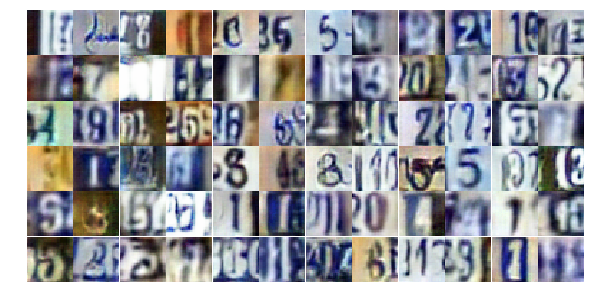

Epoch 23/25... Discriminator Loss: 0.6315... Generator Loss: 1.0351
Epoch 23/25... Discriminator Loss: 0.5312... Generator Loss: 1.4102
Epoch 23/25... Discriminator Loss: 0.6876... Generator Loss: 1.0538
Epoch 23/25... Discriminator Loss: 1.2991... Generator Loss: 0.5398
Epoch 23/25... Discriminator Loss: 1.2046... Generator Loss: 0.5349
Epoch 23/25... Discriminator Loss: 1.3680... Generator Loss: 0.3992
Epoch 23/25... Discriminator Loss: 0.7817... Generator Loss: 0.9836
Epoch 23/25... Discriminator Loss: 0.5888... Generator Loss: 1.2304
Epoch 23/25... Discriminator Loss: 0.4447... Generator Loss: 1.4248
Epoch 23/25... Discriminator Loss: 0.4672... Generator Loss: 1.3621


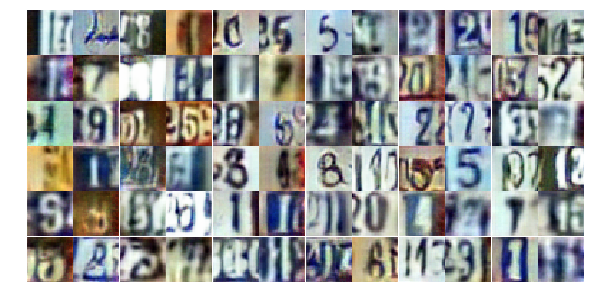

Epoch 23/25... Discriminator Loss: 1.0081... Generator Loss: 0.7072
Epoch 23/25... Discriminator Loss: 0.5851... Generator Loss: 1.2590
Epoch 23/25... Discriminator Loss: 0.4638... Generator Loss: 2.2213
Epoch 23/25... Discriminator Loss: 0.5090... Generator Loss: 1.6674
Epoch 23/25... Discriminator Loss: 1.2298... Generator Loss: 0.5324
Epoch 23/25... Discriminator Loss: 0.7773... Generator Loss: 0.9680
Epoch 23/25... Discriminator Loss: 1.4514... Generator Loss: 0.7317
Epoch 23/25... Discriminator Loss: 0.8178... Generator Loss: 2.0471
Epoch 23/25... Discriminator Loss: 0.6523... Generator Loss: 1.1212
Epoch 23/25... Discriminator Loss: 0.7248... Generator Loss: 1.0566


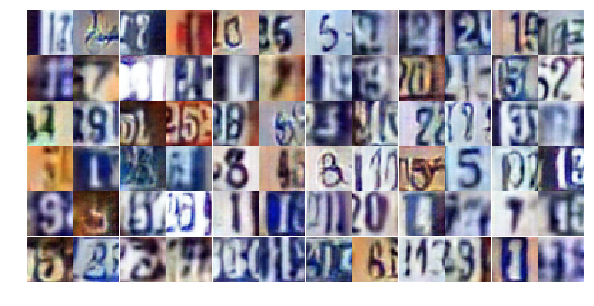

Epoch 23/25... Discriminator Loss: 0.9303... Generator Loss: 0.7508
Epoch 23/25... Discriminator Loss: 1.2629... Generator Loss: 0.4759
Epoch 23/25... Discriminator Loss: 0.9463... Generator Loss: 0.7623
Epoch 23/25... Discriminator Loss: 0.3447... Generator Loss: 1.7657
Epoch 23/25... Discriminator Loss: 1.1438... Generator Loss: 0.6597
Epoch 23/25... Discriminator Loss: 0.5047... Generator Loss: 1.3749
Epoch 23/25... Discriminator Loss: 0.6965... Generator Loss: 0.9525
Epoch 24/25... Discriminator Loss: 0.5896... Generator Loss: 1.0846
Epoch 24/25... Discriminator Loss: 0.9052... Generator Loss: 0.8069
Epoch 24/25... Discriminator Loss: 0.9714... Generator Loss: 0.7446


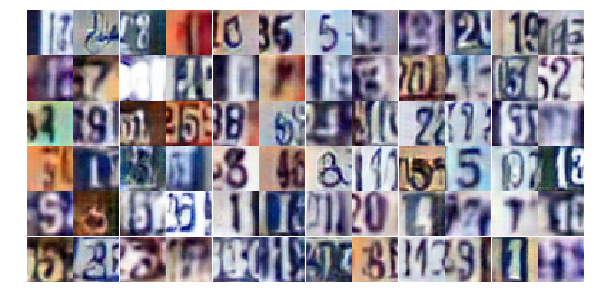

Epoch 24/25... Discriminator Loss: 0.5884... Generator Loss: 1.3288
Epoch 24/25... Discriminator Loss: 0.5458... Generator Loss: 1.3915
Epoch 24/25... Discriminator Loss: 0.6759... Generator Loss: 1.0009
Epoch 24/25... Discriminator Loss: 1.0317... Generator Loss: 2.1485
Epoch 24/25... Discriminator Loss: 1.1714... Generator Loss: 0.6510
Epoch 24/25... Discriminator Loss: 0.7430... Generator Loss: 1.0715
Epoch 24/25... Discriminator Loss: 1.0161... Generator Loss: 0.6976
Epoch 24/25... Discriminator Loss: 1.2658... Generator Loss: 0.5260
Epoch 24/25... Discriminator Loss: 0.3552... Generator Loss: 1.7024
Epoch 24/25... Discriminator Loss: 0.5510... Generator Loss: 1.2831


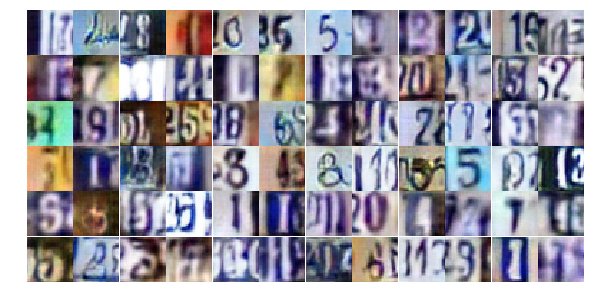

Epoch 24/25... Discriminator Loss: 1.6226... Generator Loss: 0.3872
Epoch 24/25... Discriminator Loss: 1.0615... Generator Loss: 0.6329
Epoch 24/25... Discriminator Loss: 1.4145... Generator Loss: 0.4523
Epoch 24/25... Discriminator Loss: 0.9644... Generator Loss: 0.6874
Epoch 24/25... Discriminator Loss: 0.4288... Generator Loss: 1.7798
Epoch 24/25... Discriminator Loss: 0.8800... Generator Loss: 0.7363
Epoch 24/25... Discriminator Loss: 0.3963... Generator Loss: 1.6502
Epoch 24/25... Discriminator Loss: 1.4852... Generator Loss: 0.3638
Epoch 24/25... Discriminator Loss: 0.7097... Generator Loss: 1.1349
Epoch 24/25... Discriminator Loss: 0.4652... Generator Loss: 1.4961


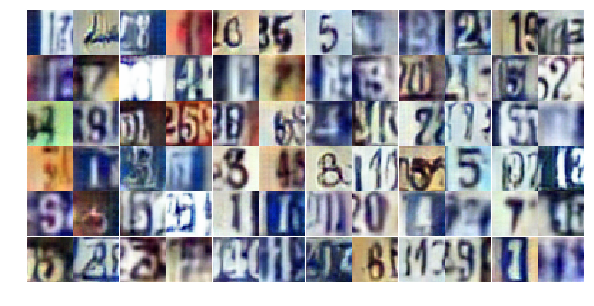

Epoch 24/25... Discriminator Loss: 0.7083... Generator Loss: 1.1274
Epoch 24/25... Discriminator Loss: 0.5579... Generator Loss: 1.2867
Epoch 24/25... Discriminator Loss: 0.9462... Generator Loss: 0.7389
Epoch 24/25... Discriminator Loss: 1.0480... Generator Loss: 0.7353
Epoch 24/25... Discriminator Loss: 0.5123... Generator Loss: 1.2721
Epoch 24/25... Discriminator Loss: 0.7480... Generator Loss: 0.8786
Epoch 24/25... Discriminator Loss: 0.4725... Generator Loss: 1.3650
Epoch 24/25... Discriminator Loss: 0.4224... Generator Loss: 1.8364
Epoch 24/25... Discriminator Loss: 0.7261... Generator Loss: 0.9572
Epoch 24/25... Discriminator Loss: 0.9964... Generator Loss: 0.6699


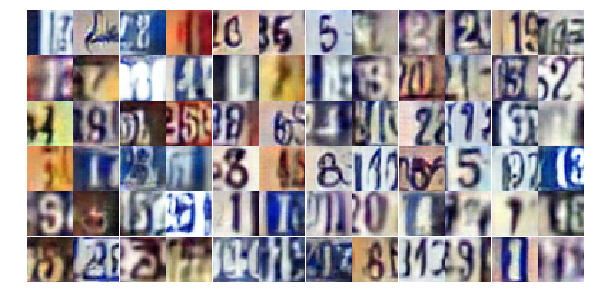

Epoch 24/25... Discriminator Loss: 0.3270... Generator Loss: 2.0532
Epoch 24/25... Discriminator Loss: 0.2764... Generator Loss: 2.1239
Epoch 24/25... Discriminator Loss: 0.7889... Generator Loss: 1.8687
Epoch 24/25... Discriminator Loss: 0.9872... Generator Loss: 0.7055
Epoch 24/25... Discriminator Loss: 0.5496... Generator Loss: 1.8628
Epoch 24/25... Discriminator Loss: 1.3910... Generator Loss: 0.4531
Epoch 24/25... Discriminator Loss: 1.1042... Generator Loss: 0.5744
Epoch 24/25... Discriminator Loss: 0.9266... Generator Loss: 0.7475
Epoch 24/25... Discriminator Loss: 0.6670... Generator Loss: 1.0653
Epoch 24/25... Discriminator Loss: 0.7089... Generator Loss: 1.0446


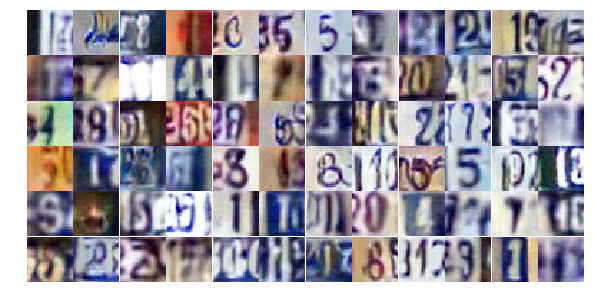

Epoch 24/25... Discriminator Loss: 0.9108... Generator Loss: 0.8305
Epoch 24/25... Discriminator Loss: 1.9413... Generator Loss: 0.3392
Epoch 24/25... Discriminator Loss: 0.8422... Generator Loss: 1.0786
Epoch 24/25... Discriminator Loss: 1.6318... Generator Loss: 0.2966
Epoch 24/25... Discriminator Loss: 1.6602... Generator Loss: 0.3504
Epoch 24/25... Discriminator Loss: 0.9131... Generator Loss: 0.7204
Epoch 24/25... Discriminator Loss: 1.5387... Generator Loss: 0.3657
Epoch 24/25... Discriminator Loss: 0.7520... Generator Loss: 0.8818
Epoch 24/25... Discriminator Loss: 0.8129... Generator Loss: 1.0150
Epoch 24/25... Discriminator Loss: 0.9674... Generator Loss: 0.7634


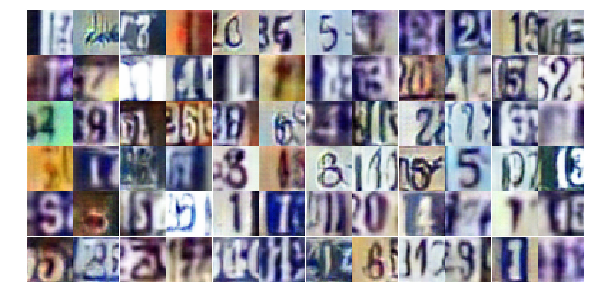

Epoch 24/25... Discriminator Loss: 0.7311... Generator Loss: 1.0758
Epoch 24/25... Discriminator Loss: 1.2893... Generator Loss: 0.4991
Epoch 24/25... Discriminator Loss: 1.0928... Generator Loss: 0.5777
Epoch 24/25... Discriminator Loss: 0.6310... Generator Loss: 1.1546
Epoch 24/25... Discriminator Loss: 1.2268... Generator Loss: 0.5029
Epoch 25/25... Discriminator Loss: 1.0356... Generator Loss: 0.7017
Epoch 25/25... Discriminator Loss: 0.6767... Generator Loss: 1.2791
Epoch 25/25... Discriminator Loss: 0.5808... Generator Loss: 1.8813
Epoch 25/25... Discriminator Loss: 0.6379... Generator Loss: 1.1121
Epoch 25/25... Discriminator Loss: 0.9266... Generator Loss: 0.6991


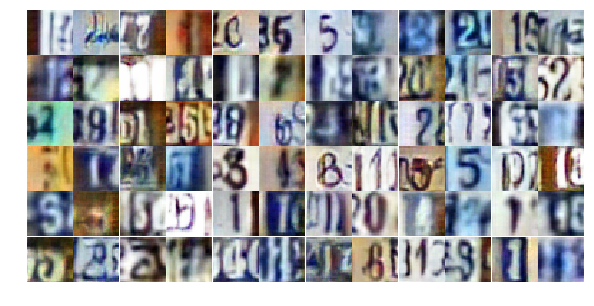

Epoch 25/25... Discriminator Loss: 1.4612... Generator Loss: 0.3631
Epoch 25/25... Discriminator Loss: 1.2766... Generator Loss: 0.5336
Epoch 25/25... Discriminator Loss: 1.0413... Generator Loss: 0.6610
Epoch 25/25... Discriminator Loss: 0.8988... Generator Loss: 0.8075
Epoch 25/25... Discriminator Loss: 0.5374... Generator Loss: 1.6632
Epoch 25/25... Discriminator Loss: 0.9703... Generator Loss: 0.7715
Epoch 25/25... Discriminator Loss: 0.6168... Generator Loss: 1.1043
Epoch 25/25... Discriminator Loss: 0.7766... Generator Loss: 1.0328
Epoch 25/25... Discriminator Loss: 0.5334... Generator Loss: 1.2765
Epoch 25/25... Discriminator Loss: 0.7753... Generator Loss: 0.9301


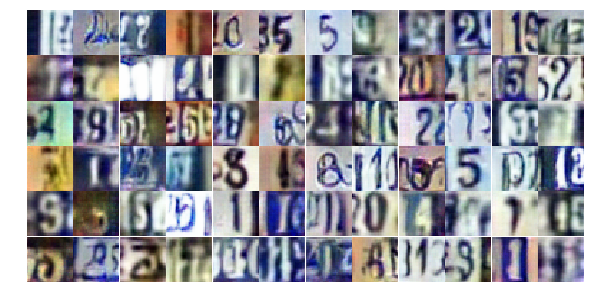

Epoch 25/25... Discriminator Loss: 1.0808... Generator Loss: 0.6444
Epoch 25/25... Discriminator Loss: 0.3219... Generator Loss: 2.2145
Epoch 25/25... Discriminator Loss: 1.3731... Generator Loss: 0.4590
Epoch 25/25... Discriminator Loss: 1.1290... Generator Loss: 0.5639
Epoch 25/25... Discriminator Loss: 0.8911... Generator Loss: 0.7996
Epoch 25/25... Discriminator Loss: 0.4764... Generator Loss: 1.5697
Epoch 25/25... Discriminator Loss: 2.0757... Generator Loss: 0.2181
Epoch 25/25... Discriminator Loss: 0.9074... Generator Loss: 0.8415
Epoch 25/25... Discriminator Loss: 0.4811... Generator Loss: 1.5498
Epoch 25/25... Discriminator Loss: 0.4746... Generator Loss: 1.4964


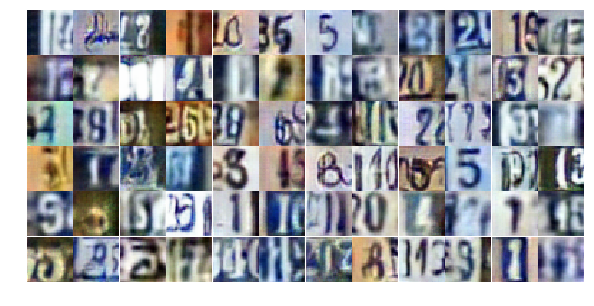

Epoch 25/25... Discriminator Loss: 1.0813... Generator Loss: 0.6553
Epoch 25/25... Discriminator Loss: 0.5149... Generator Loss: 1.2560
Epoch 25/25... Discriminator Loss: 1.2320... Generator Loss: 0.6997
Epoch 25/25... Discriminator Loss: 0.5916... Generator Loss: 1.2610
Epoch 25/25... Discriminator Loss: 1.0061... Generator Loss: 0.7838
Epoch 25/25... Discriminator Loss: 0.4440... Generator Loss: 1.5806
Epoch 25/25... Discriminator Loss: 0.6489... Generator Loss: 1.1707
Epoch 25/25... Discriminator Loss: 0.5885... Generator Loss: 1.3225
Epoch 25/25... Discriminator Loss: 0.6123... Generator Loss: 1.7105
Epoch 25/25... Discriminator Loss: 0.3227... Generator Loss: 2.0433


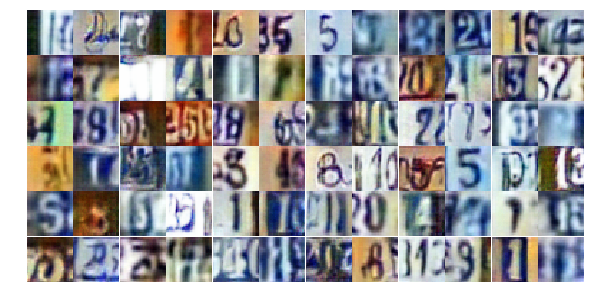

Epoch 25/25... Discriminator Loss: 0.8642... Generator Loss: 0.7672
Epoch 25/25... Discriminator Loss: 0.6065... Generator Loss: 1.2244
Epoch 25/25... Discriminator Loss: 0.8309... Generator Loss: 0.8771
Epoch 25/25... Discriminator Loss: 1.0407... Generator Loss: 0.6483
Epoch 25/25... Discriminator Loss: 0.7333... Generator Loss: 1.1043
Epoch 25/25... Discriminator Loss: 1.2397... Generator Loss: 0.5545
Epoch 25/25... Discriminator Loss: 0.3950... Generator Loss: 1.5800
Epoch 25/25... Discriminator Loss: 0.5623... Generator Loss: 1.3284
Epoch 25/25... Discriminator Loss: 1.7980... Generator Loss: 0.3971
Epoch 25/25... Discriminator Loss: 0.5714... Generator Loss: 1.1218


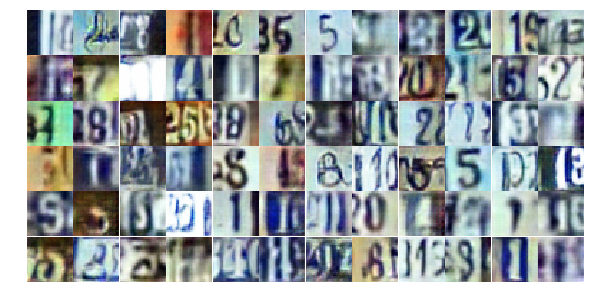

Epoch 25/25... Discriminator Loss: 0.8798... Generator Loss: 0.9023
Epoch 25/25... Discriminator Loss: 0.8993... Generator Loss: 0.9312
Epoch 25/25... Discriminator Loss: 0.6971... Generator Loss: 1.5835
Epoch 25/25... Discriminator Loss: 1.1212... Generator Loss: 0.5985
Epoch 25/25... Discriminator Loss: 1.1783... Generator Loss: 0.5383
Epoch 25/25... Discriminator Loss: 0.4435... Generator Loss: 1.4367
Epoch 25/25... Discriminator Loss: 0.7117... Generator Loss: 1.0943
Epoch 25/25... Discriminator Loss: 2.3359... Generator Loss: 0.1827
Epoch 25/25... Discriminator Loss: 1.7149... Generator Loss: 3.8745
Epoch 25/25... Discriminator Loss: 1.1125... Generator Loss: 0.7734


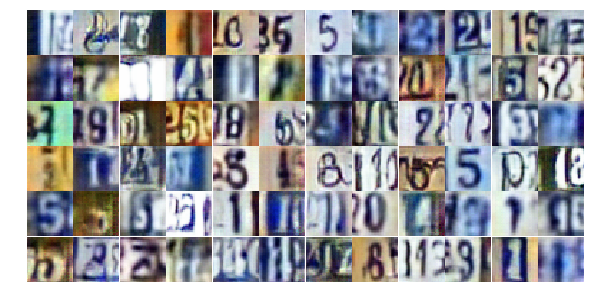

Epoch 25/25... Discriminator Loss: 0.6423... Generator Loss: 1.2734
Epoch 25/25... Discriminator Loss: 1.0382... Generator Loss: 0.6742


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

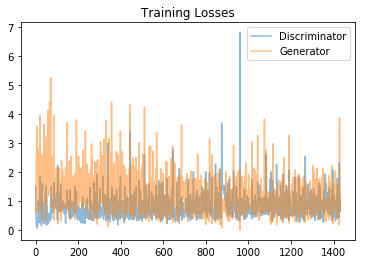

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

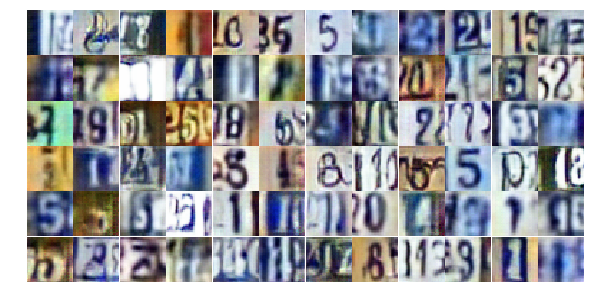

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))